## Notes

We will investigate whether and how aridification has elevated the lifting condensation level (LCL) and the level of free convection (LFC) beyond the daytime boundary layer height more frequently and over broader areas in the WUS-SP, and how such changes affect clouds and precipitation.  In particular, we will analyze the changes of shallow (≤3km) and deep (≥6 km) convection, and congestus (3-6 km) using the MODIS Aqua cloud data (CLDPROP_D3_MODIS_Aqua), and LCL, LFC, daytime boundary height (defined as in Liu and Liang 2010), atmospheric humidity, temperature, and buoyancy profiles between the periods before and after 2000 using the ERA5.  These profiles will be evaluated by the radiosonde profiles provided by the IGRA data. We will use a buoyancy plume model with lateral entrainment (e.g., Holloway and Neelin 2009; Zhuang et al. 2018) to compute buoyancy profiles so we can evaluate the impact of humidity in the boundary layer and the lower troposphere, respectively, on shallow, congestus and deep convection.  We hypothesize that aridity amplifies drought by reducing shallow convection, which in turn reduces the lower tropospheric humidity and then suppresses deep convection (e.g., Zhang and Klein 2010; Zhuang et al. 2018), and so amplifies drought severity.  
To determine whether aridification has reduced clouds and precipitation under the dry soil moisture advantaged land-atmospheric coupling, we will evaluate changes of convective trigger potential (CTP) and the boundary layer dew-point depression for the drought and non-drought conditions, respectively, before and after 2000, follow the CTP/Hilow land-atmospheric coupling framework of Findel and Eltahir (2003) and Wakefield et al. (2019).  


next step:

- look into lat/lons on darmdata_cleaned: maybe need to drop some more files

- use convert_pres_to_height function to create a new column on lcl_df called "height", need to find the starting temperature and height, use this: https://www.mide.com/air-pressure-at-altitude-calculator 

notes:

- pblht seems directionally accurate, lower during colder seasons (DJF) and higher during warm season (JJA). 

questions:

- where should parcel profile be with respect to observed temp lapse rate? where should dewpoint temperature be?
- how should lfc change throughout the day?
- what conditions would make it so that there is no lfc?
- difference between instability and convection?


- does it make more sense to compare LCL & boundary layer height at pressure level or above ground height?

- does it make sense to compare at same time of day?

- why is soil moisture sometimes not between 1 and 0? why is mann kendall test saying increasing for MMA when average shows decreasing (2001 & 2017 lots of > 1 values)

- this paper uses same data: https://journals.ametsoc.org/view/journals/atsc/67/9/2010jas3366.1.xml

notes: 

- why does soil moisture plot not align with precipitation plot? 36.63459,-96.81046 --> lat/lon for soil moisture/36.786,-96.909 --> lat/lon for precipitation, 36.610001,-97.489998 --> lat/lon for surface temps

other: 
- calculate daytime boundary height (use definition of BL height from Lui & Lang (seems like potential temperature is only piece needed? combined with several conditions) https://journals.ametsoc.org/view/journals/clim/23/21/2010jcli3552.1.xml#i1520-0442-23-21-5790-f02)

- notes from call: change LFC calc by setting "parcel_temperature_profile" parameter to be based on mixed layer parcel (either mixed_parcel or mixed_layer metpy calc) (average temperature & humidity, this is the "initial condition") 

- could bin by dryness/aridity index, average by month  

- for aridity bins, can use a subfolder in same folder that these cdfs came from (there is a folder that has weather station data containing temp, humidity, wind. types of data from arm site might help too https://www.arm.gov/capabilities/instruments?location%5b0%5d=Southern%20Great%20Plains&p=3)


gaoyuns paper:

- dry soil -> very high LT necessary to create precip
- wet soil -> LT not necessary 
- LT controlled by moisture transport, from GPLLJ 

In [3]:
import pandas as pd
import glob
import datetime
import metpy.calc as mpcalc
from metpy.units import units
from metpy.cbook import get_test_data
from metpy.plots import add_metpy_logo, SkewT
from pyhdf import SD
import numpy as np
import math
import pint
from pydoc import help
from pyhdf.SD import *
import xarray as xr
import netCDF4 as nc
import re
import matplotlib.pyplot as plt
from numpy import load
from numpy import asarray
from numpy import save
import pytz
from scipy import stats
from sklearn.linear_model import LinearRegression
from collections import Counter
import pymannkendall as mk
%matplotlib inline

In [4]:
# Set display options to show all rows and columns in dataframe
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)

In [6]:
#loop to read in all sondewnpn files
darmdata = []
path = "../../data/rong1/climate_fu/Data/DOEARM/sgp/sondewnpn"
file_list = sorted(glob.glob(path + "/*.cdf"))
for file in file_list: 
    ds = xr.open_dataset(file)
    darmdata.append(ds)

In [388]:
#loop to read in precipitation data
precipdata = []
bugs=0
path = "../../data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final"
#precip files from 1994-2016 are .nc files and 2016-2019 are .cdf files
precip_list = sorted(glob.glob(path + "/*.nc") + glob.glob(path + "/*.cdf"))
for file in precip_list:
    try:
        s = xr.open_dataset(file)
        print(s.encoding['source'])
        precipdata.append(s)
    except Exception as e:
        print(f"Error opening file: {file}")
        bugs+=1
        print(e)

/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19940624.150000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19940625.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19940626.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19940627.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19940628.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19940629.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19940630.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19940701.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19940702.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19940703.000000.custom.cdf
/data/rong1/climate_

/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19940926.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19940927.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19940928.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19940929.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19940930.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19941001.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19941002.020000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19941003.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19941004.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19941005.000000.custom.cdf
/data/rong1/climate_

/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19941222.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19941223.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19941224.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19941225.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19941226.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19941227.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19941228.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19941229.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19941230.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19941231.000000.custom.cdf
/data/rong1/climate_

/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19950320.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19950321.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19950322.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19950323.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19950324.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19950325.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19950326.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19950327.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19950328.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19950329.000000.custom.cdf
/data/rong1/climate_

/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19950618.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19950619.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19950620.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19950621.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19950622.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19950623.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19950624.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19950625.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19950626.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19950627.000000.custom.cdf
/data/rong1/climate_

/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19950920.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19950921.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19950922.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19950923.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19950924.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19950925.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19950926.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19950927.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19950928.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19950929.000000.custom.cdf
/data/rong1/climate_

/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19951216.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19951217.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19951218.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19951219.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19951220.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19951221.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19951222.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19951223.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19951224.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19951225.000000.custom.cdf
/data/rong1/climate_

/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19960311.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19960312.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19960313.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19960314.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19960315.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19960316.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19960317.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19960318.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19960319.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19960320.000000.custom.cdf
/data/rong1/climate_

/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19960606.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19960607.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19960608.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19960609.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19960610.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19960611.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19960612.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19960613.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19960614.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19960615.000000.custom.cdf
/data/rong1/climate_

/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19960901.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19960902.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19960903.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19960904.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19960905.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19960906.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19960907.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19960908.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19960909.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19960910.000000.custom.cdf
/data/rong1/climate_

/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19961127.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19961128.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19961129.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19961130.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19961201.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19961202.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19961203.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19961204.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19961205.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19961206.000000.custom.cdf
/data/rong1/climate_

/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19970222.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19970223.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19970224.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19970225.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19970226.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19970227.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19970228.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19970301.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19970302.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19970303.000000.custom.cdf
/data/rong1/climate_

/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19970520.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19970521.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19970522.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19970523.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19970524.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19970525.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19970526.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19970527.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19970528.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19970529.000000.custom.cdf
/data/rong1/climate_

/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19970816.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19970817.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19970818.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19970819.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19970820.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19970821.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19970822.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19970823.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19970824.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19970825.000000.custom.cdf
/data/rong1/climate_

/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19971110.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19971111.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19971112.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19971113.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19971114.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19971115.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19971116.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19971117.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19971118.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19971119.000000.custom.cdf
/data/rong1/climate_

/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19980205.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19980206.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19980207.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19980208.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19980209.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19980210.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19980211.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19980212.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19980213.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19980214.000000.custom.cdf
/data/rong1/climate_

/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19980503.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19980504.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19980505.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19980506.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19980507.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19980508.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19980509.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19980510.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19980511.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19980512.000000.custom.cdf
/data/rong1/climate_

/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19980729.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19980730.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19980731.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19980801.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19980802.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19980803.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19980804.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19980805.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19980806.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19980807.000000.custom.cdf
/data/rong1/climate_

/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19981027.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19981028.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19981029.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19981030.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19981031.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19981101.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19981102.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19981103.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19981104.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19981105.000000.custom.cdf
/data/rong1/climate_

/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19990124.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19990125.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19990127.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19990128.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19990129.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19990130.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19990131.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19990201.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19990202.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19990203.000000.custom.cdf
/data/rong1/climate_

/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19990429.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19990430.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19990502.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19990503.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19990504.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19990505.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19990506.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19990507.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19990508.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19990509.000000.custom.cdf
/data/rong1/climate_

/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19990810.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19990811.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19990812.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19990813.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19990814.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19990815.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19990816.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19990817.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19990818.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19990819.000000.custom.cdf
/data/rong1/climate_

/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19991105.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19991106.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19991107.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19991108.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19991109.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19991110.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19991111.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19991112.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19991113.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.19991114.000000.custom.cdf
/data/rong1/climate_

/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20000131.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20000201.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20000202.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20000203.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20000204.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20000205.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20000206.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20000207.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20000208.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20000209.000000.custom.cdf
/data/rong1/climate_

/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20000426.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20000427.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20000428.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20000429.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20000430.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20000501.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20000502.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20000503.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20000504.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20000505.000000.custom.cdf
/data/rong1/climate_

/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20000722.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20000723.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20000724.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20000725.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20000726.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20000727.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20000728.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20000729.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20000730.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20000731.000000.custom.cdf
/data/rong1/climate_

/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20001017.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20001018.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20001019.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20001020.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20001021.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20001022.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20001023.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20001024.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20001025.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20001026.000000.custom.cdf
/data/rong1/climate_

/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20010112.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20010113.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20010114.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20010115.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20010116.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20010117.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20010118.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20010119.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20010120.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20010121.000000.custom.cdf
/data/rong1/climate_

/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20010409.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20010410.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20010411.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20010412.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20010413.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20010414.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20010415.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20010416.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20010417.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20010418.000000.custom.cdf
/data/rong1/climate_

/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20010705.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20010706.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20010707.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20010708.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20010709.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20010710.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20010711.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20010712.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20010713.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20010714.000000.custom.cdf
/data/rong1/climate_

/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20010930.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20011001.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20011002.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20011003.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20011004.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20011005.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20011006.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20011007.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20011008.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20011009.000000.custom.cdf
/data/rong1/climate_

/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20011226.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20011227.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20011228.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20011229.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20011230.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20011231.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20020101.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20020102.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20020103.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20020104.000000.custom.cdf
/data/rong1/climate_

/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20020323.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20020324.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20020325.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20020326.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20020327.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20020328.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20020329.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20020330.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20020331.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20020401.000000.custom.cdf
/data/rong1/climate_

/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20020618.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20020619.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20020620.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20020621.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20020622.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20020623.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20020624.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20020625.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20020626.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20020627.000000.custom.cdf
/data/rong1/climate_

/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20020913.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20020914.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20020915.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20020916.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20020917.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20020918.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20020919.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20020920.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20020921.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20020922.000000.custom.cdf
/data/rong1/climate_

/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20021209.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20021210.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20021211.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20021212.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20021213.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20021214.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20021215.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20021216.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20021217.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20021218.000000.custom.cdf
/data/rong1/climate_

/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20030306.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20030307.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20030308.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20030309.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20030310.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20030311.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20030312.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20030313.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20030314.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20030315.000000.custom.cdf
/data/rong1/climate_

/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20030601.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20030602.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20030603.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20030604.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20030605.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20030606.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20030607.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20030608.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20030609.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20030610.000000.custom.cdf
/data/rong1/climate_

/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20030827.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20030828.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20030829.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20030830.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20030831.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20030901.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20030902.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20030903.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20030904.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20030905.000000.custom.cdf
/data/rong1/climate_

/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20031122.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20031123.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20031124.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20031125.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20031126.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20031127.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20031128.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20031129.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20031130.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20031201.000000.custom.cdf
/data/rong1/climate_

/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20040217.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20040218.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20040219.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20040220.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20040221.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20040222.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20040223.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20040224.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20040225.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20040226.000000.custom.cdf
/data/rong1/climate_

/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20040514.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20040515.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20040516.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20040517.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20040518.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20040519.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20040520.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20040521.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20040522.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20040523.000000.custom.cdf
/data/rong1/climate_

/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20040809.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20040810.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20040811.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20040812.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20040813.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20040814.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20040815.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20040816.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20040817.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20040818.000000.custom.cdf
/data/rong1/climate_

/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20041104.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20041105.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20041106.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20041107.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20041108.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20041109.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20041110.010000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20041111.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20041112.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20041113.000000.custom.cdf
/data/rong1/climate_

/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20050130.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20050131.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20050201.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20050202.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20050203.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20050204.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20050205.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20050206.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20050207.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20050208.000000.custom.cdf
/data/rong1/climate_

/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20050427.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20050428.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20050429.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20050430.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20050501.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20050502.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20050503.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20050504.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20050505.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20050506.000000.custom.cdf
/data/rong1/climate_

/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20050723.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20050724.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20050725.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20050726.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20050727.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20050728.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20050729.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20050730.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20050731.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20050801.000000.custom.cdf
/data/rong1/climate_

/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20051018.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20051019.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20051020.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20051021.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20051022.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20051023.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20051024.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20051025.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20051026.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20051027.000000.custom.cdf
/data/rong1/climate_

/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20060112.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20060113.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20060114.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20060115.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20060116.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20060117.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20060118.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20060119.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20060120.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20060121.000000.custom.cdf
/data/rong1/climate_

/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20060409.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20060410.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20060411.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20060412.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20060413.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20060414.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20060415.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20060416.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20060417.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20060418.000000.custom.cdf
/data/rong1/climate_

/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20060705.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20060706.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20060707.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20060708.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20060709.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20060710.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20060711.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20060712.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20060713.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20060714.000000.custom.cdf
/data/rong1/climate_

/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20060930.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20061001.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20061002.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20061003.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20061004.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20061005.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20061006.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20061007.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20061008.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20061009.000000.custom.cdf
/data/rong1/climate_

/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20061226.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20061227.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20061228.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20061229.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20061230.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20061231.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20070101.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20070102.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20070103.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20070104.000000.custom.cdf
/data/rong1/climate_

/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20070323.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20070324.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20070325.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20070326.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20070327.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20070328.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20070329.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20070330.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20070331.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20070401.000000.custom.cdf
/data/rong1/climate_

/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20070618.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20070619.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20070620.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20070621.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20070622.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20070623.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20070624.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20070625.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20070626.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20070627.000000.custom.cdf
/data/rong1/climate_

/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20070913.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20070914.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20070915.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20070916.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20070917.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20070918.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20070919.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20070920.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20070921.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20070922.000000.custom.cdf
/data/rong1/climate_

/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20071209.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20071210.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20071211.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20071212.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20071213.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20071214.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20071215.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20071216.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20071217.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20071218.000000.custom.cdf
/data/rong1/climate_

/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20080305.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20080306.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20080307.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20080308.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20080309.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20080310.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20080311.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20080312.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20080313.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20080314.000000.custom.cdf
/data/rong1/climate_

/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20080531.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20080601.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20080602.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20080603.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20080604.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20080605.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20080606.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20080607.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20080608.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20080609.000000.custom.cdf
/data/rong1/climate_

/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20080826.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20080827.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20080828.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20080829.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20080830.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20080831.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20080901.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20080902.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20080903.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20080904.000000.custom.cdf
/data/rong1/climate_

/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20081121.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20081122.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20081123.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20081124.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20081125.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20081126.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20081127.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20081128.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20081129.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20081130.000000.custom.cdf
/data/rong1/climate_

/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20090216.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20090217.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20090218.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20090219.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20090220.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20090221.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20090222.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20090223.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20090224.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20090225.010000.custom.cdf
/data/rong1/climate_

/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20090526.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20090527.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20090528.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20090529.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20090530.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20090531.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20090601.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20090602.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20090603.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20090604.000000.custom.cdf
/data/rong1/climate_

/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20090824.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20090825.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20090826.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20090827.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20090828.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20090829.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20090830.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20090831.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20090901.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20090902.000000.custom.cdf
/data/rong1/climate_

/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20091214.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20091215.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20091216.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20091217.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20091218.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20091219.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20091220.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20091221.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20091222.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20091223.000000.custom.cdf
/data/rong1/climate_

/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20100311.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20100312.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20100313.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20100314.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20100315.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20100316.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20100317.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20100318.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20100319.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20100320.000000.custom.cdf
/data/rong1/climate_

/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20100605.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20100606.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20100607.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20100608.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20100609.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20100610.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20100611.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20100612.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20100613.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20100614.000000.custom.cdf
/data/rong1/climate_

/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20100831.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20100901.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20100902.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20100903.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20100904.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20100905.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20100906.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20100907.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20100908.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20100909.000000.custom.cdf
/data/rong1/climate_

/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20101125.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20101126.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20101127.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20101128.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20101129.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20101130.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20101201.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20101202.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20101203.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20101204.000000.custom.cdf
/data/rong1/climate_

/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20110219.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20110220.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20110221.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20110222.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20110223.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20110224.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20110225.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20110226.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20110227.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20110228.000000.custom.cdf
/data/rong1/climate_

/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20110517.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20110518.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20110519.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20110520.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20110521.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20110522.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20110523.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20110524.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20110525.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20110526.000000.custom.cdf
/data/rong1/climate_

/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20110811.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20110812.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20110812.010000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20110813.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20110814.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20110815.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20110816.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20110817.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20110818.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20110819.000000.custom.cdf
/data/rong1/climate_

/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20111105.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20111106.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20111107.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20111108.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20111109.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20111110.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20111111.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20111112.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20111113.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20111114.000000.custom.cdf
/data/rong1/climate_

/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20120131.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20120201.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20120202.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20120203.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20120204.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20120205.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20120206.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20120207.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20120208.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20120209.000000.custom.cdf
/data/rong1/climate_

/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20120427.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20120428.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20120429.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20120430.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20120430.010000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20120501.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20120501.010000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20120502.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20120503.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20120503.010000.custom.cdf
/data/rong1/climate_

/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20120720.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20120721.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20120722.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20120723.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20120724.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20120725.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20120726.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20120727.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20120728.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20120729.000000.custom.cdf
/data/rong1/climate_

/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20121015.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20121016.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20121017.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20121018.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20121019.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20121020.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20121021.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20121022.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20121023.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20121024.000000.custom.cdf
/data/rong1/climate_

/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20130110.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20130111.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20130112.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20130113.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20130114.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20130115.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20130116.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20130117.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20130118.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20130119.000000.custom.cdf
/data/rong1/climate_

/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20130407.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20130408.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20130409.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20130410.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20130411.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20130412.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20130413.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20130414.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20130415.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20130416.000000.custom.cdf
/data/rong1/climate_

/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20130703.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20130704.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20130705.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20130706.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20130707.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20130708.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20130709.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20130710.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20130711.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20130712.000000.custom.cdf
/data/rong1/climate_

/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20130928.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20130929.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20130930.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20131001.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20131002.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20131003.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20131004.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20131005.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20131006.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20131007.000000.custom.cdf
/data/rong1/climate_

/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20131224.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20131225.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20131226.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20131227.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20131228.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20131229.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20131230.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20131231.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20140101.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20140102.000000.custom.cdf
/data/rong1/climate_

/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20140321.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20140322.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20140323.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20140324.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20140325.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20140326.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20140327.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20140328.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20140329.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20140330.000000.custom.cdf
/data/rong1/climate_

/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20140616.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20140617.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20140618.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20140619.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20140620.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20140621.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20140622.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20140623.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20140624.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20140625.000000.custom.cdf
/data/rong1/climate_

/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20140914.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20140915.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20140916.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20140917.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20140918.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20140919.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20140920.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20140921.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20140922.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20140923.000000.custom.cdf
/data/rong1/climate_

/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20141210.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20141211.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20141212.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20141213.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20141214.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20141215.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20141216.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20141217.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20141218.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20141219.000000.custom.cdf
/data/rong1/climate_

/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20150307.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20150308.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20150309.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20150310.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20150311.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20150312.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20150313.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20150314.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20150315.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20150316.000000.custom.cdf
/data/rong1/climate_

/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20150602.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20150603.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20150604.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20150605.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20150606.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20150607.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20150608.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20150609.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20150610.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20150611.000000.custom.cdf
/data/rong1/climate_

/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20150830.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20150831.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20150901.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20150902.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20150903.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20150904.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20150905.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20150906.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20150907.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20150908.000000.custom.cdf
/data/rong1/climate_

/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20151126.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20151127.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20151128.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20151129.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20151130.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20151201.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20151202.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20151203.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20151204.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20151205.000000.custom.cdf
/data/rong1/climate_

/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20160224.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20160225.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20160226.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20160227.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20160228.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20160301.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20160302.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20160303.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20160304.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20160305.000000.custom.cdf
/data/rong1/climate_

/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20160523.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20160524.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20160525.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20160526.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20160527.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20160528.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20160529.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20160530.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20160531.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20160601.000000.custom.cdf
/data/rong1/climate_

/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20160818.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20160819.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20160820.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20160821.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20160822.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20160823.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20160824.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20160825.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20160826.000000.custom.cdf
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20160827.000000.custom.cdf
/data/rong1/climate_

/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20161204.000000.custom.nc
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20161205.000000.custom.nc
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20161206.000000.custom.nc
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20161207.000000.custom.nc
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20161208.000000.custom.nc
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20161209.000000.custom.nc
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20161210.000000.custom.nc
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20161211.000000.custom.nc
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20161212.000000.custom.nc
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20161213.000000.custom.nc
/data/rong1/climate_fu/Data/DO

/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20170317.000000.custom.nc
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20170318.000000.custom.nc
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20170319.000000.custom.nc
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20170320.000000.custom.nc
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20170321.000000.custom.nc
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20170322.000000.custom.nc
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20170323.000000.custom.nc
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20170324.000000.custom.nc
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20170325.000000.custom.nc
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20170326.000000.custom.nc
/data/rong1/climate_fu/Data/DO

/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20170627.000000.custom.nc
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20170628.000000.custom.nc
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20170629.000000.custom.nc
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20170630.000000.custom.nc
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20170701.000000.custom.nc
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20170702.000000.custom.nc
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20170703.000000.custom.nc
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20170704.000000.custom.nc
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20170705.000000.custom.nc
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20170706.000000.custom.nc
/data/rong1/climate_fu/Data/DO

/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20171009.000000.custom.nc
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20171010.000000.custom.nc
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20171011.000000.custom.nc
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20171012.000000.custom.nc
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20171013.000000.custom.nc
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20171014.000000.custom.nc
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20171015.000000.custom.nc
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20171016.000000.custom.nc
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20171017.000000.custom.nc
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20171018.000000.custom.nc
/data/rong1/climate_fu/Data/DO

/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20180129.000000.custom.nc
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20180130.000000.custom.nc
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20180131.000000.custom.nc
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20180201.000000.custom.nc
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20180202.000000.custom.nc
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20180203.000000.custom.nc
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20180204.000000.custom.nc
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20180205.000000.custom.nc
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20180206.000000.custom.nc
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20180207.000000.custom.nc
/data/rong1/climate_fu/Data/DO

/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20180513.000000.custom.nc
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20180514.000000.custom.nc
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20180515.000000.custom.nc
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20180516.000000.custom.nc
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20180517.000000.custom.nc
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20180518.000000.custom.nc
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20180519.000000.custom.nc
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20180520.000000.custom.nc
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20180521.000000.custom.nc
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20180522.000000.custom.nc
/data/rong1/climate_fu/Data/DO

/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20180825.000000.custom.nc
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20180826.000000.custom.nc
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20180827.000000.custom.nc
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20180828.000000.custom.nc
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20180829.000000.custom.nc
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20180830.000000.custom.nc
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20180831.000000.custom.nc
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20180901.000000.custom.nc
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20180902.000000.custom.nc
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20180903.000000.custom.nc
/data/rong1/climate_fu/Data/DO

/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20181207.000000.custom.nc
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20181208.000000.custom.nc
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20181209.000000.custom.nc
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20181210.000000.custom.nc
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20181211.000000.custom.nc
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20181212.000000.custom.nc
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20181213.000000.custom.nc
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20181214.000000.custom.nc
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20181215.000000.custom.nc
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20181216.000000.custom.nc
/data/rong1/climate_fu/Data/DO

/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20190321.000000.custom.nc
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20190322.000000.custom.nc
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20190323.000000.custom.nc
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20190324.000000.custom.nc
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20190325.000000.custom.nc
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20190326.000000.custom.nc
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20190327.000000.custom.nc
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20190328.000000.custom.nc
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20190329.000000.custom.nc
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20190330.000000.custom.nc
/data/rong1/climate_fu/Data/DO

/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20190702.000000.custom.nc
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20190703.000000.custom.nc
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20190704.000000.custom.nc
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20190705.000000.custom.nc
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20190706.000000.custom.nc
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20190707.000000.custom.nc
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20190708.000000.custom.nc
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20190709.000000.custom.nc
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20190710.000000.custom.nc
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20190711.000000.custom.nc
/data/rong1/climate_fu/Data/DO

/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20190926.000000.custom.nc
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20190927.000000.custom.nc
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20190928.000000.custom.nc
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20190929.000000.custom.nc
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20190930.000000.custom.nc
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20191001.000000.custom.nc
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20191002.000000.custom.nc
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20191003.000000.custom.nc
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20191004.000000.custom.nc
/data/rong1/climate_fu/Data/DOEARM/sgp/abrfc_final/sgpabrfcprecipX1.c1.20191005.000000.custom.nc
/data/rong1/climate_fu/Data/DO

In [ ]:
#loop to read in soil moisture data
soildata = []
bugs=0
path = "../../data/rong1/climate_fu/Data/DOEARM/sgp/okmsoilX1"
soil_list = sorted(glob.glob(path + "/*.nc"))
for file in soil_list:
    try:
        s = xr.open_dataset(file)
        #print(s.encoding['source'])
        soildata.append(s)
    except Exception as e:
        print(f"Error opening file: {file}")
        bugs+=1
        print(e)

In [ ]:
#loop to read in pblht data
pblhtdata = []
bugs=0
path = "../../data/rong1/climate_fu/Data/DOEARM/sgp/annie_pblht/sgppblhtsonde1mcfarlC1.c1"
pblht_list = sorted(glob.glob(path + "/*.cdf"))
for file in pblht_list:
    try:
        s = xr.open_dataset(file)
        #prints the name of the file
        print(s.encoding['source'])
        pblhtdata.append(s)
    except Exception as e:
        #if xarray can not open the file, will print the error
        print(f"Error opening file: {file}")
        #bugs collects all errors in reading in the file
        bugs+=1
        print(e)

In [1467]:
# A day was classified as having an LLJ present
# if, upon visual inspection, a large portion of the study
# region was under the influence of winds at the 850-hPa
# level of greater than 25 kt (12 m/2)

darmdata_cleaned[0].variables['v_wind']

3081

In [656]:
#seems across files, lat lons will be same but precip will change given day & time
#when subsetting precip[0,100,200], i think this corresponds to position [100,200] for the lat/lon variables
#as an estimate [100,200] pretty close to 36 lat,-97 lon
platlon = []
for file in precipdata:
    hrs_recorded = file.variables["precip"].shape[0]

        lat = file.variables["lat"].data[100,200]
        lon = file.variables["lon"].data[100,200]
        latlontup = (lat,lon)
        platlon.append(latlontup)

-97.363


In [1364]:
pcheck = pd.DataFrame(platlon,columns=['lat','lon'])

In [1367]:
len(precipdata)

9217

In [744]:
#what it means to index precip[0,lat,lon] --> this is the southwest corner of the grid
file = precipdata[0]
lat = 100 
lon = 200 
precip = file.variables["precip"].data[0,lat,lon]

sw_lat = file.variables["lat"].data[lat,lon]
sw_lon = file.variables["lon"].data[lat,lon]

nw_lat = file.variables["lat"].data[lat+1,lon]
nw_lon = file.variables["lon"].data[lat+1,lon]

print(sw_lat, nw_lat)

36.837 36.873


In [1373]:
time_adjustment(precipdata[10])

datetime.datetime(1994, 7, 4, 0, 0)

In [845]:
#calculates daily precipitation for each file
preciptups = []
lat = 100 #36.786
lon = 210 #-96.909
for file in precipdata:
    p_total_day=[]
    #hrs_recorded stores the count of hours for recording in each day, usually value is 24 but less
    hrs_recorded = file.variables["precip"].shape[0]
    time = time_adjustment(file)
    #loops through the number of hours recorded for precip for particular file
    for i in range(hrs_recorded):
        #100,200 selected as lat/lon that correspond to close to 36,-97 (near lcl & soil moisture calculation)
        #*0.01 do adjust for mm units
        p = file.variables['precip'].data[i,lat,lon]*0.01
        #removing the -1 values which are essentially NA values
        if p >= 0:
            p_total_day.append(p)
    #sum precip across full day
    total_precip = sum(p_total_day)
    tup = (time,total_precip)
    preciptups.append(tup)

precipdf = pd.DataFrame(preciptups,columns=['time','daily_precip'])

In [1377]:
precipdf

,daily_precip,year,month,day,hour,season
time,,,,,,
1994-06-24 09:00:00,0.00,1994,6,24,9,JJA
1994-06-24 18:00:00,0.00,1994,6,24,18,JJA
1994-06-25 18:00:00,0.00,1994,6,25,18,JJA
1994-06-26 18:00:00,0.00,1994,6,26,18,JJA
1994-06-27 18:00:00,0.00,1994,6,27,18,JJA
1994-06-28 18:00:00,0.00,1994,6,28,18,JJA
1994-06-29 18:00:00,2.59,1994,6,29,18,JJA
1994-06-30 18:00:00,0.00,1994,6,30,18,JJA
1994-07-01 18:00:00,24.01,1994,7,1,18,JJA


In [846]:
precipdf = precipdf.set_index("time")

#converts date column to Oklahoma time 
precipdf.index = pd.to_datetime(precipdf.index)
precipdf.index = precipdf.index - datetime.timedelta(hours=6)

precipdf = precipdf.sort_index()

#adding columns for year,month,day,hour
precipdf['year'] = precipdf.index.year
precipdf['month'] = precipdf.index.month
precipdf['day'] = precipdf.index.day
precipdf['hour'] = precipdf.index.hour

# Apply the function to create the "season" column
precipdf['season'] = precipdf['month'].apply(assign_season)

avgprecip = precipdf.groupby(['year', 'season'])['daily_precip'].agg(['mean', 'size']).rename(columns={'mean': 'mean_precip', 'size': 'count_values'})

avgprecip = pd.DataFrame(avgprecip).reset_index()
avgprecip_jja = avgprecip[avgprecip['season'] == 'JJA'].reset_index()
avgprecip_mma = avgprecip[avgprecip['season'] == 'MMA'].reset_index()
avgprecip_son = avgprecip[avgprecip['season'] == 'SON'].reset_index()
avgprecip_djf = avgprecip[avgprecip['season'] == 'DJF'].reset_index()

all_precip_seasons = [avgprecip_jja, avgprecip_mma, avgprecip_son, avgprecip_djf]

#avgprecip_jja[avgprecip_jja['count_values'] > 10]

In [1375]:
precipdf.tail()

,daily_precip,year,month,day,hour,season
time,,,,,,
2019-11-05 18:00:00,0.00,2019,11,5,18,SON
2019-11-06 18:00:00,7.14,2019,11,6,18,SON
2019-11-07 18:00:00,0.00,2019,11,7,18,SON
2019-11-08 18:00:00,0.00,2019,11,8,18,SON
2019-11-09 18:00:00,0.00,2019,11,9,18,SON


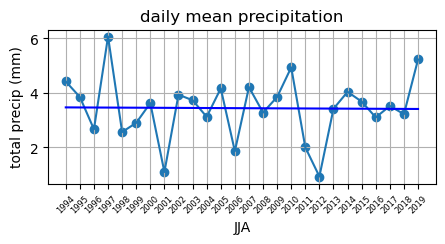

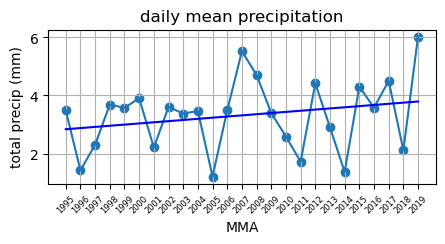

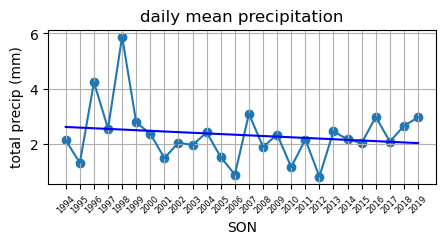

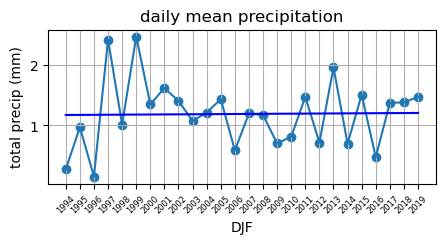

In [847]:
#very sensitive to lat/lon provided
for df in all_precip_seasons:
    df = df[df['count_values']>10]
    plt.figure(figsize=(5, 2))
    plt.scatter(df['year'], df['mean_precip'])
    xlab = df.loc[0, 'season']
    plt.xlabel(xlab)
    plt.ylabel('total precip (mm)')
    plt.title('daily mean precipitation')
    plt.xticks(df['year'], rotation=45, fontsize=6)

    plt.grid(True)

    # Adding trendline
    x = np.arange(len(df))
    y = df['mean_precip']

    # Fit a linear regression model
    reg = LinearRegression()
    reg.fit(x.reshape(-1, 1), y)

    # Calculate the predicted y-values (trend line)
    y_pred = reg.predict(x.reshape(-1, 1))

    # Plotting the data and trend line
    plt.plot(df['year'], df['mean_precip'], label='Data')
    plt.plot(df['year'], y_pred, color='blue', label='Trend Line')

    plt.show()


In [741]:
# Performing the Mann-Kendall test on full data seasonal LCLs
# shows "decreasing" (ie increasing) significance for all but djf 

seasonal_precip_list = ['JJA', 'MMA', 'SON', 'DJF']
for season in seasonal_precip_list:
    mk_full = precipdf[precipdf['season'] == season]
    mk_full = mk_full["daily_precip"].to_list()
    result = mk.original_test(mk_full)

    # Extract the test statistic and p-value from the result
    test_statistic = result.trend
    p_value = result.p

    # Print the results
    print("Mann-Kendall Test Statistic:", season, test_statistic)
    
    #1-(p-value) represents the probability that the alternative hypothesis is true
    #the alternative hypothesis being that a trend exists
    #the null hypothesis being that no trend exists
    
    print("P-value:", p_value)

Mann-Kendall Test Statistic: JJA no trend
P-value: 0.7498510747910578
Mann-Kendall Test Statistic: MMA no trend
P-value: 0.17314515866989244
Mann-Kendall Test Statistic: SON no trend
P-value: 0.2734905514389607
Mann-Kendall Test Statistic: DJF no trend
P-value: 0.9134038430660922


In [951]:
#creating df where every row is a day & time and ll_pblht for each file in pblhtdata
time_height_tups = []
for file in pblhtdata:
    time = time_adjustment(file)
    #subtracting 315m to adjust to above ground level (as opposed to above mean sea level)
    llht = file.variables["pbl_height_liu_liang"].data - 315
    tup = (time, llht)
    time_height_tups.append(tup)

ll_pblht_df = pd.DataFrame(time_height_tups, columns=['time','ll_pblht'])

In [953]:
#processing to group by season, and plot soil moisture change time series
#sets index to be date
ll_pblht_df = ll_pblht_df.set_index("time")

#converts date column to Oklahoma time 
ll_pblht_df.index = pd.to_datetime(ll_pblht_df.index)
ll_pblht_df.index = ll_pblht_df.index - datetime.timedelta(hours=6)

ll_pblht_df = ll_pblht_df.sort_index()

#adding columns for year,month,day,hour
ll_pblht_df['year'] = ll_pblht_df.index.year
ll_pblht_df['month'] = ll_pblht_df.index.month
ll_pblht_df['day'] = ll_pblht_df.index.day
ll_pblht_df['hour'] = ll_pblht_df.index.hour


ll_pblht_df = ll_pblht_df[ll_pblht_df['hour'] == 11]

# Apply the function to create the "season" column
ll_pblht_df['season'] = ll_pblht_df['month'].apply(assign_season)

#season_lcls = lcl_df_11.groupby(['year', 'season'])['pressure'].mean()
avgpblht = ll_pblht_df.groupby(['year', 'season'])['ll_pblht'].agg(['mean', 'size']).rename(columns={'mean': 'mean_pblht', 'size': 'count_values'})

avgpblht = pd.DataFrame(avgpblht).reset_index()
avgpblht_jja = avgpblht[avgpblht['season'] == 'JJA'].reset_index()
avgpblht_mma = avgpblht[avgpblht['season'] == 'MMA'].reset_index()
avgpblht_son = avgpblht[avgpblht['season'] == 'SON'].reset_index()
avgpblht_djf = avgpblht[avgpblht['season'] == 'DJF'].reset_index()

all_pblht_seasons = [avgpblht_jja, avgpblht_mma, avgpblht_son, avgpblht_djf]

,index,year,season,mean_pblht,count_values
0,1,2001,JJA,2097.433333,30
1,4,2002,JJA,1444.589888,89
2,8,2003,JJA,1771.521127,71
3,12,2004,JJA,1167.585227,88
4,16,2005,JJA,1563.466667,90
5,20,2006,JJA,1681.545455,88
6,24,2007,JJA,1358.970442,88
7,28,2008,JJA,1334.468608,86
8,32,2009,JJA,1313.464043,89
9,36,2010,JJA,1480.303293,91


In [1282]:
avgpblht

,year,season,mean_pblht,count_values
0,2001,DJF,526.425926,27
1,2001,JJA,2097.433333,30
2,2001,SON,989.392857,84
3,2002,DJF,551.557143,70
4,2002,JJA,1444.589888,89
5,2002,MMA,881.541176,85
6,2002,SON,881.056180,89
7,2003,DJF,540.179012,81
8,2003,JJA,1771.521127,71
9,2003,MMA,947.616279,86


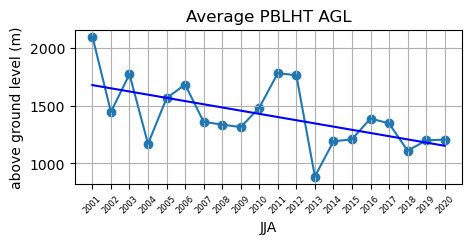

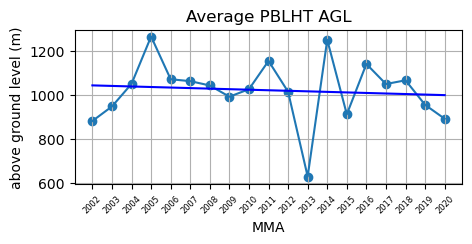

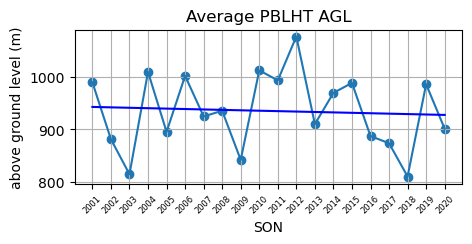

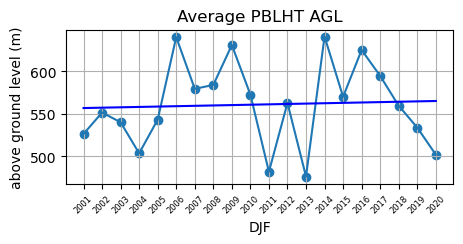

In [958]:
#36.605 = lat, -97.485 = lon
for df in all_pblht_seasons:
    df = df[df['count_values']>10]
    plt.figure(figsize=(5, 2))
    plt.scatter(df['year'], df['mean_pblht'])
    xlab = df.loc[0, 'season']
    plt.xlabel(xlab)
    plt.ylabel('above ground level (m)')
    plt.title('Average PBLHT AGL')
    plt.xticks(df['year'], rotation=45, fontsize=6)

    plt.grid(True)

    # Adding trendline
    x = np.arange(len(df))
    y = df['mean_pblht']

    # Fit a linear regression model
    reg = LinearRegression()
    reg.fit(x.reshape(-1, 1), y)

    # Calculate the predicted y-values (trend line)
    y_pred = reg.predict(x.reshape(-1, 1))

    # Plotting the data and trend line
    plt.plot(df['year'], df['mean_pblht'], label='Data')
    plt.plot(df['year'], y_pred, color='blue', label='Trend Line')

    plt.show()


In [959]:
seasonal_pblht_list = ['JJA', 'MMA', 'SON', 'DJF']
for season in seasonal_pblht_list:
    mk_full = ll_pblht_df[ll_pblht_df['season'] == season]
    mk_full = mk_full["ll_pblht"].to_list()
    result = mk.original_test(mk_full)

    # Extract the test statistic and p-value from the result
    test_statistic = result.trend
    p_value = result.p

    # Print the results
    print("Mann-Kendall Test Statistic:", season, test_statistic)
    
    #1-(p-value) represents the probability that the alternative hypothesis is true
    #the alternative hypothesis being that a trend exists
    #the null hypothesis being that no trend exists
    
    print("P-value:", p_value)

Mann-Kendall Test Statistic: JJA decreasing
P-value: 7.69229124841786e-12
Mann-Kendall Test Statistic: MMA no trend
P-value: 0.7262391638017416
Mann-Kendall Test Statistic: SON no trend
P-value: 0.16358401138188428
Mann-Kendall Test Statistic: DJF no trend
P-value: 0.6888272608570829


In [988]:
#seek to calculate average JJA soil moisture for each year from 1998-2020 for one station
#lat/lon index 18 = 36.63459,-96.81046
#36.610001,-97.489998 --> for surface temps, find station closer to this

findlat = 36.75443
soil_tups = []
for s in soildata:
    lat = s.variables["lat"].data
    lon = s.variables["lon"].data
    lat_lon_index = find_ll_index(lat,findlat)
    bt = s.variables["base_time"].data
    v_water = s.variables["fractional_water_index"].data
    #extract first observation of day (v_water[0]) at 25 cm (v_water[0][1])
    #and at specific station (v_water[0][1][lat_lon_index])
    v_25cm_first_obs = v_water[0][1] #[lat_lon_index]
    if v_25cm_first_obs[lat_lon_index] >= 1:
        print(bt)
#         tup = (bt, v_25cm_first_obs)
#         soil_tups.append(tup)

2003-06-12T00:00:00.000000000
2003-06-13T00:00:00.000000000
2004-02-03T00:00:00.000000000
2011-01-01T00:00:00.000000000
2011-01-02T00:00:00.000000000
2011-01-03T00:00:00.000000000
2011-01-04T00:00:00.000000000
2011-01-05T00:00:00.000000000
2011-01-06T00:00:00.000000000
2011-01-07T00:00:00.000000000
2011-01-08T00:00:00.000000000
2011-01-09T00:00:00.000000000
2011-01-10T00:00:00.000000000
2011-01-11T00:00:00.000000000
2011-01-12T00:00:00.000000000
2011-01-13T00:00:00.000000000
2011-01-14T00:00:00.000000000
2011-01-15T00:00:00.000000000
2011-01-16T00:00:00.000000000
2011-01-17T00:00:00.000000000
2011-01-18T00:00:00.000000000
2011-01-19T00:00:00.000000000
2011-01-20T00:00:00.000000000
2011-01-21T00:00:00.000000000
2011-01-22T00:00:00.000000000
2011-01-23T00:00:00.000000000
2011-01-24T00:00:00.000000000
2011-01-25T00:00:00.000000000
2011-01-26T00:00:00.000000000
2011-01-27T00:00:00.000000000
2011-01-28T00:00:00.000000000
2011-01-29T00:00:00.000000000
2011-01-30T00:00:00.000000000
2011-01-31

In [983]:
#checking fractional water indexing
findlat = 36.75443
lat = soildata[-1].variables["lat"].data
lat_lon_index = find_ll_index(lat,findlat)
soildata[-1].variables["fractional_water_index"][0][1][lat_lon_index]

<xarray.Variable ()>
array(0.97531, dtype=float32)
Attributes:
    long_name:            Fractional Water Index; relative measure of soil we...
    units:                1
    ancillary_variables:  qc_fractional_water_index
    valid_min:            0.0
    valid_max:            1.0

In [969]:
#processing to group by season, and plot soil moisture change time series
#sets index to be date
soildf = soil_tups_df.set_index("base_time")

#converts date column to Oklahoma time 
soildf.index = pd.to_datetime(soildf.index)
soildf.index = soildf.index - datetime.timedelta(hours=6)

soildf = soildf.sort_index()

#adding columns for year,month,day,hour
soildf['year'] = soildf.index.year
soildf['month'] = soildf.index.month
soildf['day'] = soildf.index.day
soildf['hour'] = soildf.index.hour

# Apply the function to create the "season" column
soildf['season'] = soildf['month'].apply(assign_season)

#season_lcls = lcl_df_11.groupby(['year', 'season'])['pressure'].mean()
avgsoil = soildf.groupby(['year', 'season'])['fractional_water_index'].agg(['mean', 'size']).rename(columns={'mean': 'mean_fractional_water_index', 'size': 'count_values'})

avgsoil = pd.DataFrame(avgsoil).reset_index()
avgsoil_jja = avgsoil[avgsoil['season'] == 'JJA'].reset_index()
avgsoil_mma = avgsoil[avgsoil['season'] == 'MMA'].reset_index()
avgsoil_son = avgsoil[avgsoil['season'] == 'SON'].reset_index()
avgsoil_djf = avgsoil[avgsoil['season'] == 'DJF'].reset_index()

all_soil_seasons = [avgsoil_jja, avgsoil_mma, avgsoil_son, avgsoil_djf]

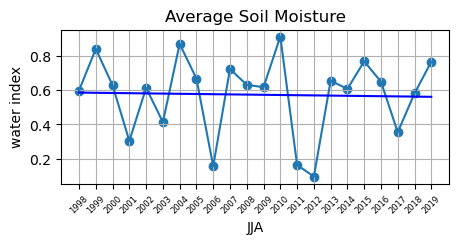

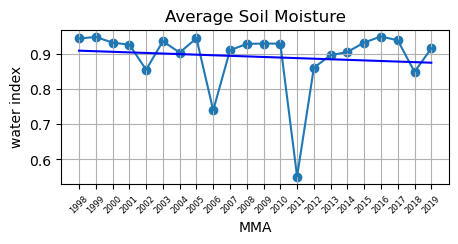

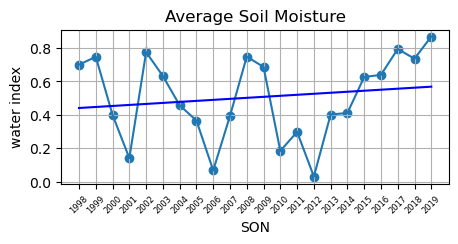

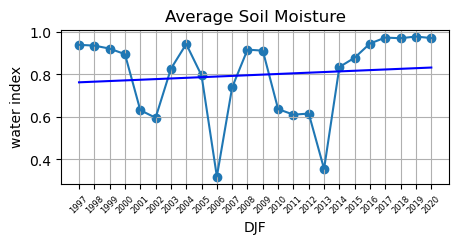

In [970]:
#plotting avgsoil seasonally
for df in all_soil_seasons:
    plt.figure(figsize=(5, 2))
    plt.scatter(df['year'], df['mean_fractional_water_index'])
    xlab = df.loc[0, 'season']
    plt.xlabel(xlab)
    plt.ylabel('water index')
    plt.title('Average Soil Moisture')
    plt.xticks(df['year'], rotation=45, fontsize=6)

    plt.grid(True)

    # Adding trendline
    x = np.arange(len(df))
    y = df['mean_fractional_water_index']

    # Fit a linear regression model
    reg = LinearRegression()
    reg.fit(x.reshape(-1, 1), y)

    # Calculate the predicted y-values (trend line)
    y_pred = reg.predict(x.reshape(-1, 1))

    # Plotting the data and trend line
    plt.plot(df['year'], df['mean_fractional_water_index'], label='Data')
    plt.plot(df['year'], y_pred, color='blue', label='Trend Line')

    plt.show()


<bound method _make_class_factory.<locals>.class_factory.<locals>.subcls.set of <AxesSubplot: title={'center': 'Average Soil Moisture'}, xlabel='Year', ylabel='degrees C'>>

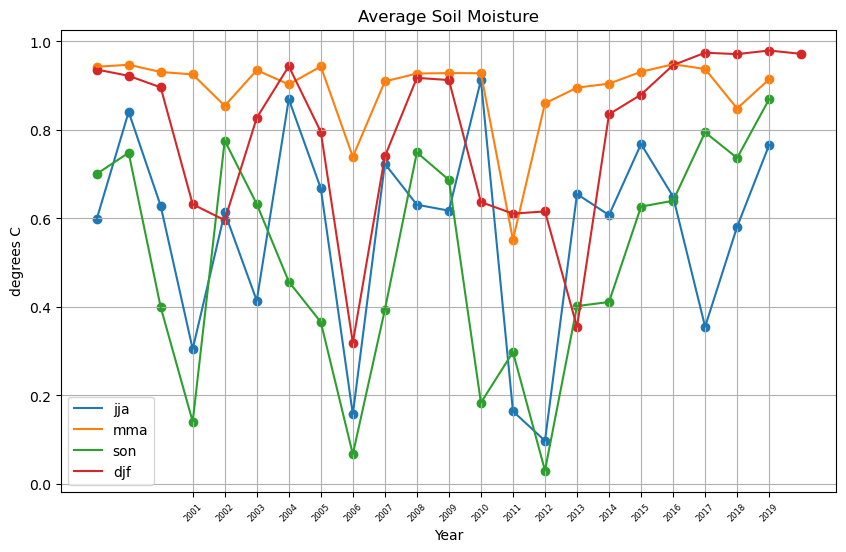

In [1460]:
fig, ax = plt.subplots(figsize=(10, 6))

seasons = ['jja', 'mma', 'son', 'djf']

# Iterate over each season's DataFrame
for i, season_df in enumerate([avgsoil_jja, avgsoil_mma, avgsoil_son, avgsoil_djf]):
    season_df = season_df[season_df['count_values'] > 10]
    plt.scatter(season_df['year'], season_df['mean_fractional_water_index'])
    plt.plot(season_df['year'], season_df['mean_fractional_water_index'],label=seasons[i])
# Customize the plot
plt.grid(True)
ax.legend()
plt.xticks(avg_dps_jja['year'], rotation=45, fontsize=6)
ax.set_xlabel('Year')
ax.set_title("Average Soil Moisture")
ax.set_ylabel('degrees C')
ax.set

In [940]:
seasonal_soil_list = ['JJA', 'MMA', 'SON', 'DJF']
for season in seasonal_soil_list:
    mk_full = soildf[soildf['season'] == season]
    mk_full = mk_full["fractional_water_index"].to_list()
    result = mk.original_test(mk_full)

    # Extract the test statistic and p-value from the result
    test_statistic = result.trend
    p_value = result.p

    # Print the results
    print("Mann-Kendall Test Statistic:", season, test_statistic)
    
    #1-(p-value) represents the probability that the alternative hypothesis is true
    #the alternative hypothesis being that a trend exists
    #the null hypothesis being that no trend exists
    
    print("P-value:", p_value)

Mann-Kendall Test Statistic: JJA increasing
P-value: 0.0
Mann-Kendall Test Statistic: MMA increasing
P-value: 1.6860848184307997e-07
Mann-Kendall Test Statistic: SON increasing
P-value: 0.0
Mann-Kendall Test Statistic: DJF increasing
P-value: 0.0


In [8]:
#loop to remove files that have less than a 50hpa range in pres variable
darmdata_cleaned = []
count_fails = 0
for file in darmdata: 
    pres = file.variables["pres"].data
    first_p = pres[0]
    last_p = pres[-1]
    if first_p - last_p >= 50:
        darmdata_cleaned.append(file)
    else:
        count_fails += 1

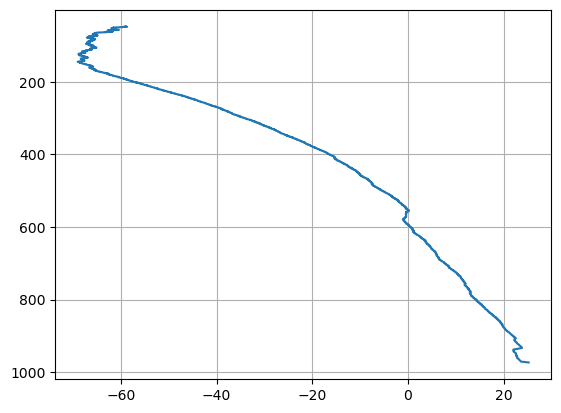

In [1431]:
p = darmdata_cleaned[0].variables["pres"].data
t = darmdata_cleaned[0].variables["tdry"].data
fig, ax = plt.subplots()
plt.plot(t,p)
ax.invert_yaxis()
plt.grid(True)

In [1432]:
# Define the x-values at which you want to interpolate
max_pressure = max(p)
min_pressure = min(p)

x_new = np.arange(min,max,50)

# Use numpy.interp to perform linear interpolation
y_interp = np.interp(x_new, x, y)

# Print the interpolated values
for i in range(len(p_new)):
    print(f"At x={p_new[i]}, y is approximately {y_interp[i]}")

At x=947.7999992370605, y is approximately 25.200000762939453
At x=897.7999992370605, y is approximately 25.200000762939453
At x=847.7999992370605, y is approximately 25.200000762939453
At x=797.7999992370605, y is approximately 25.200000762939453
At x=747.7999992370605, y is approximately 25.200000762939453
At x=697.7999992370605, y is approximately 25.200000762939453
At x=647.7999992370605, y is approximately 25.200000762939453
At x=597.7999992370605, y is approximately 25.200000762939453
At x=547.7999992370605, y is approximately 25.200000762939453
At x=497.79999923706055, y is approximately 25.200000762939453
At x=447.79999923706055, y is approximately 25.200000762939453
At x=397.79999923706055, y is approximately 25.200000762939453
At x=347.79999923706055, y is approximately 25.200000762939453
At x=297.79999923706055, y is approximately 25.200000762939453
At x=247.79999923706055, y is approximately 25.200000762939453
At x=197.79999923706055, y is approximately 25.200000762939453
A

In [1429]:
t

array([-59.2, -59.2, -59.2, ...,  23.6,  24.2,  25.2], dtype=float32)

#function to extract correct initial time of launch for each balloon 
#base_time + time_offset[0]
#there will be about 3k duplicates from 2001-2003 because someone read in duplicates from the a1 and b1 products
#a1 & b1 have overlapping dates in 2001-2003

#for any analysis going forward, need to drop those duplicates 
#darmdata_utc_times = []

def time_adjustment(file):
    bt = file.variables["base_time"].data
    t = file.coords["time"].data[0]
    t_off = file.variables["time_offset"].data[0]
    
    bt = pd.Timestamp(bt)
    t_off = pd.Timestamp(t_off)
    
    yr = bt.year
    month = bt.month
    day = bt.day
    
    if bt.hour == 0 and bt.minute == 0 and bt.second == 0:
        hr = t_off.hour
        minute = t_off.minute
        second = t_off.second
    else:
        hr = bt.hour
        minute = bt.minute
        second = bt.second
    
    time_final = (yr, month, day, hr, minute, second)
    time_final = datetime.datetime(*time_final)
    #darmdata_utc_times.append(time_final)
    return(time_final)
    

In [285]:
#calculating mixed layer dewpoint for every file
dps = []
for file in darmdata_cleaned:
    pres = file.variables['pres'][:].data * units.hPa
    tdry = file.variables['tdry'][:].data * units.degC
    dp = file.variables['dp'][:].data * units.degC
    time = time_adjustment(file)
    mp = mpcalc.mixed_parcel(pres, tdry, dp, depth=50 * units.hPa)
    tup = (time, mp[2])
    dps.append(tup)

/data/rong3/annie/anaconda3/envs/annieenv/lib/python3.9/site-packages/metpy/calc/thermo.py:1384: RuntimeWarning: invalid value encountered in log
  val = np.log(vapor_pressure / mpconsts.nounit.sat_pressure_0c)
/data/rong3/annie/anaconda3/envs/annieenv/lib/python3.9/site-packages/metpy/calc/thermo.py:1301: RuntimeWarning: overflow encountered in exp
  return mpconsts.nounit.sat_pressure_0c * np.exp(
/data/rong3/annie/anaconda3/envs/annieenv/lib/python3.9/site-packages/metpy/calc/thermo.py:1301: RuntimeWarning: overflow encountered in multiply
  return mpconsts.nounit.sat_pressure_0c * np.exp(
/data/rong3/annie/anaconda3/envs/annieenv/lib/python3.9/site-packages/metpy/calc/thermo.py:1446: RuntimeWarning: invalid value encountered in true_divide
  return molecular_weight_ratio * partial_press / (total_press - partial_press)


In [286]:
#create jja dewpoint df 
dpdf = pd.DataFrame(dps, columns=['date','dewpoint'])

#sets index to be date
dpdf = dpdf.set_index("date")

dpdf['dewpoint'] = dpdf['dewpoint'].apply(lambda x: x.magnitude)

#converts date column to Oklahoma time 
dpdf.index = pd.to_datetime(dpdf.index)

dpdf.index = dpdf.index - datetime.timedelta(hours=6)

#adding columns for year,month,day,hour
dpdf['year'] = dpdf.index.year
dpdf['month'] = dpdf.index.month
dpdf['day'] = dpdf.index.day
dpdf['hour'] = dpdf.index.hour

dpdf = dpdf.sort_index()

#drops duplicate rows across dpdf, basically if same time & day and same lcl calculation
dpdf = dpdf.drop_duplicates()

In [287]:
#filters dp_ dataframe for hour 11 and plots the average LCL per day
dp_11 = dpdf[dpdf['hour'] == 11]

# Define a function to map month numbers to seasons
def assign_season(month):
    if month in [3,4,5]:
        return 'MMA'
    elif month in [6,7,8]:
        return 'JJA'
    elif month in [9,10,11]:
        return 'SON'
    else:
        return 'DJF'

# Apply the function to create the "season" column
dp_11['season'] = dp_11['month'].apply(assign_season)
dp_11 = dp_11.sort_index()

#season_dps = dp__11.groupby(['year', 'season'])['pressure'].mean()
season_dps = dp_11.groupby(['year', 'season'])['dewpoint'].agg(['mean', 'size']).rename(columns={'mean': 'mean_dp', 'size': 'count_values'})

season_dps = pd.DataFrame(season_dps).reset_index()

avg_dps_jja = season_dps[season_dps['season'] == 'JJA'].reset_index()
avg_dps_mma = season_dps[season_dps['season'] == 'MMA'].reset_index()
avg_dps_son = season_dps[season_dps['season'] == 'SON'].reset_index()
avg_dps_djf = season_dps[season_dps['season'] == 'DJF'].reset_index()

all_seasons_dp = [avg_dps_jja, avg_dps_mma, avg_dps_son, avg_dps_djf]

/tmp/ipykernel_61746/3630981273.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dp_11['season'] = dp_11['month'].apply(assign_season)


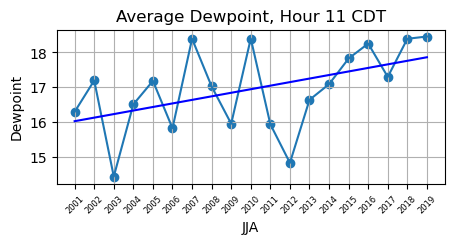

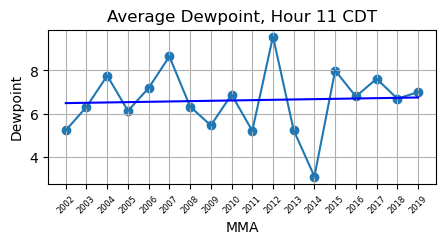

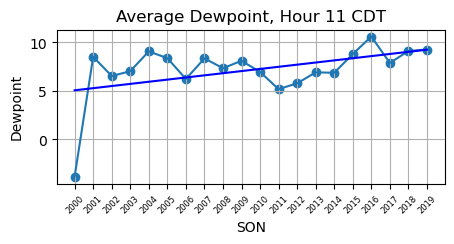

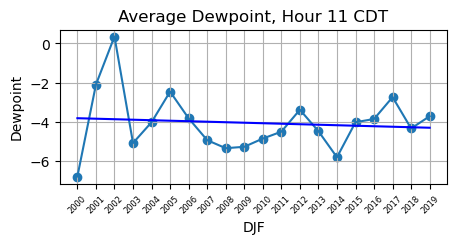

In [288]:
#print plots for seasonal LCL calculations
for df in all_seasons_dp:
    plt.figure(figsize=(5, 2))
    plt.scatter(df['year'], df['mean_dp'])
    xlab = df.loc[0, 'season']
    plt.xlabel(xlab)
    plt.ylabel('Dewpoint')
    plt.title('Average Dewpoint, Hour 11 CDT')
    plt.xticks(df['year'], rotation=45, fontsize=6)

    plt.grid(True)

    # Adding trendline
    x = np.arange(len(df))
    y = df['mean_dp']

    # Fit a linear regression model
    reg = LinearRegression()
    reg.fit(x.reshape(-1, 1), y)

    # Calculate the predicted y-values (trend line)
    y_pred = reg.predict(x.reshape(-1, 1))

    # Plotting the data and trend line
    plt.plot(df['year'], df['mean_dp'], label='Data')
    plt.plot(df['year'], y_pred, color='blue', label='Trend Line')

    plt.show()

In [1468]:
avg_dps_jja

,index,year,season,mean_dp,count_values
0,3,2001,JJA,16.290191,30
1,6,2002,JJA,17.190909,91
2,10,2003,JJA,14.429139,74
3,14,2004,JJA,16.505298,88
4,18,2005,JJA,17.179528,91
5,22,2006,JJA,15.817511,89
6,26,2007,JJA,18.391327,88
7,30,2008,JJA,17.019636,87
8,34,2009,JJA,15.947156,89
9,38,2010,JJA,18.397788,91


<bound method _make_class_factory.<locals>.class_factory.<locals>.subcls.set of <AxesSubplot: title={'center': 'Average Dewpoint'}, xlabel='Year', ylabel='degrees C'>>

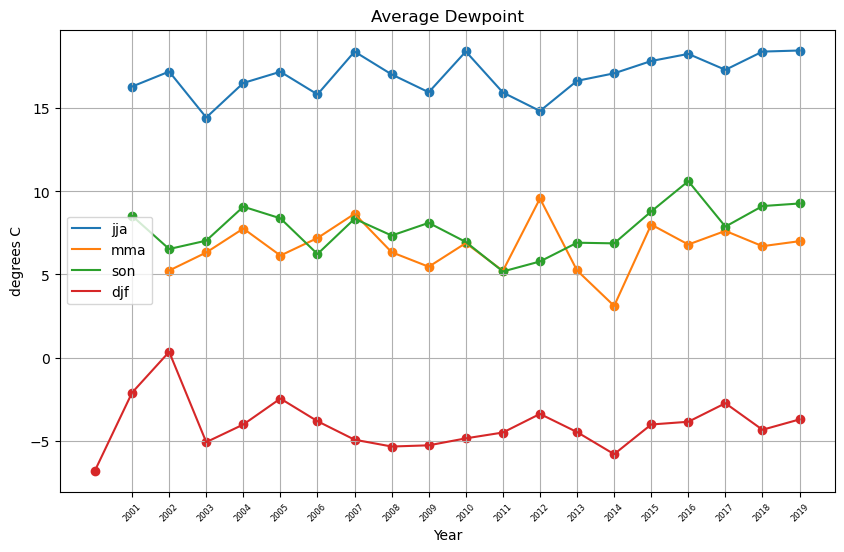

In [1437]:
fig, ax = plt.subplots(figsize=(10, 6))

seasons = ['jja', 'mma', 'son', 'djf']

# Iterate over each season's DataFrame
for i, season_df in enumerate([avg_dps_jja, avg_dps_mma, avg_dps_son, avg_dps_djf]):
    season_df = season_df[season_df['count_values'] > 10]
    plt.scatter(season_df['year'], season_df['mean_dp'])
    plt.plot(season_df['year'], season_df['mean_dp'],label=seasons[i])
# Customize the plot
plt.grid(True)
ax.legend()
plt.xticks(avg_dps_jja['year'], rotation=45, fontsize=6)
ax.set_xlabel('Year')
ax.set_title("Average Dewpoint")
ax.set_ylabel('degrees C')
ax.set

In [289]:
# Performing the Mann-Kendall test on full data seasonal LCLs
# shows "decreasing" (ie increasing) significance for all but djf 

seasonal_list = ['JJA', 'MMA', 'SON', 'DJF']
for season in seasonal_list:
    mk_full = dp_11[dp_11['season'] == season]
    mk_full = mk_full["dewpoint"].to_list()
    result = mk.original_test(mk_full)

    # Extract the test statistic and p-value from the result
    test_statistic = result.trend
    p_value = result.p

    # Print the results
    print("Mann-Kendall Test Statistic:", season, test_statistic)
    
    #1-(p-value) represents the probability that the alternative hypothesis is true
    #the alternative hypothesis being that a trend exists
    #the null hypothesis being that no trend exists
    
    print("P-value:", p_value)

Mann-Kendall Test Statistic: JJA increasing
P-value: 6.960543252887419e-11
Mann-Kendall Test Statistic: MMA no trend
P-value: 0.20005383162650725
Mann-Kendall Test Statistic: SON no trend
P-value: 0.6607216257505055
Mann-Kendall Test Statistic: DJF no trend
P-value: 0.5507612360411194


In [786]:
#temperature time series
sfc_temps_check = []
for file in darmdata_cleaned:
    tdry = file.variables['tdry'][:].data[0] * units.degC
    tdry = tdry.magnitude
    lat = file.variables['lat'].data[0]
    lon = file.variables['lon'].data[0]
    #uses function time_adjustment to extract true launch of balloon 
    time = time_adjustment(file)
    tup = (time,tdry,lat,lon)
    sfc_temps_check.append(tup)

temp_check_df = pd.DataFrame(sfc_temps_check,columns=['time','temp','lat','lon'])
temp_check_df

,time,temp,lat,lon
0,2000-06-15 14:57:00,25.200001,36.610001,-97.489998
1,2000-06-16 16:51:00,20.000000,36.610001,-97.489998
2,2000-10-03 11:30:00,17.600000,36.610001,-97.489998
3,2000-11-24 11:28:00,6.200000,36.610001,-97.489998
4,2000-11-24 20:31:00,10.100000,36.610001,-97.489998
5,2000-11-24 23:28:00,8.900000,36.610001,-97.489998
6,2000-11-25 05:30:00,5.700000,36.610001,-97.489998
7,2000-11-26 20:29:00,13.800000,36.610001,-97.489998
8,2000-11-26 23:29:00,7.700000,36.610001,-97.489998
9,2000-11-27 11:40:00,-1.000000,36.610001,-97.489998


In [989]:
temp_check_df

,time,temp,lat,lon
0,2000-06-15 14:57:00,25.200001,36.610001,-97.489998
1,2000-06-16 16:51:00,20.000000,36.610001,-97.489998
2,2000-10-03 11:30:00,17.600000,36.610001,-97.489998
3,2000-11-24 11:28:00,6.200000,36.610001,-97.489998
4,2000-11-24 20:31:00,10.100000,36.610001,-97.489998
5,2000-11-24 23:28:00,8.900000,36.610001,-97.489998
6,2000-11-25 05:30:00,5.700000,36.610001,-97.489998
7,2000-11-26 20:29:00,13.800000,36.610001,-97.489998
8,2000-11-26 23:29:00,7.700000,36.610001,-97.489998
9,2000-11-27 11:40:00,-1.000000,36.610001,-97.489998


In [765]:
#temperature time series
sfc_temps = []
for file in darmdata_cleaned:
    tdry = file.variables['tdry'][:].data[0] * units.degC
    tdry = tdry.magnitude
    #uses function time_adjustment to extract true launch of balloon 
    time = time_adjustment(file)
    tup = (time,tdry)
    print(tup)
    sfc_temps.append(tup)

(datetime.datetime(2000, 6, 15, 14, 57), 25.200000762939453)
(datetime.datetime(2000, 6, 16, 16, 51), 20.0)
(datetime.datetime(2000, 10, 3, 11, 30), 17.600000381469727)
(datetime.datetime(2000, 11, 24, 11, 28), 6.199999809265137)
(datetime.datetime(2000, 11, 24, 20, 31), 10.100000381469727)
(datetime.datetime(2000, 11, 24, 23, 28), 8.899999618530273)
(datetime.datetime(2000, 11, 25, 5, 30), 5.699999809265137)
(datetime.datetime(2000, 11, 26, 20, 29), 13.800000190734863)
(datetime.datetime(2000, 11, 26, 23, 29), 7.699999809265137)
(datetime.datetime(2000, 11, 27, 11, 40), -1.0)
(datetime.datetime(2000, 11, 27, 14, 31), 0.30000001192092896)
(datetime.datetime(2000, 11, 27, 17, 30), 7.699999809265137)
(datetime.datetime(2000, 11, 27, 20, 31), 10.899999618530273)
(datetime.datetime(2000, 11, 28, 0, 29), 8.100000381469727)
(datetime.datetime(2000, 11, 28, 3, 30), 3.0)
(datetime.datetime(2000, 11, 28, 5, 42), 0.30000001192092896)
(datetime.datetime(2000, 11, 28, 8, 28), 0.20000000298023224)


(datetime.datetime(2001, 5, 29, 23, 29), 24.0)
(datetime.datetime(2001, 5, 30, 11, 28), 17.0)
(datetime.datetime(2001, 5, 30, 20, 30), 28.0)
(datetime.datetime(2001, 5, 30, 23, 30), 27.799999237060547)
(datetime.datetime(2001, 5, 31, 5, 30), 17.899999618530273)
(datetime.datetime(2001, 5, 31, 11, 36), 16.5)
(datetime.datetime(2001, 5, 31, 20, 29), 19.100000381469727)
(datetime.datetime(2001, 5, 31, 23, 29), 21.0)
(datetime.datetime(2001, 6, 1, 5, 29), 13.300000190734863)
(datetime.datetime(2001, 6, 1, 11, 28), 11.800000190734863)
(datetime.datetime(2001, 6, 1, 20, 29), 28.5)
(datetime.datetime(2001, 6, 1, 23, 29), 29.399999618530273)
(datetime.datetime(2001, 6, 2, 5, 29), 22.299999237060547)
(datetime.datetime(2001, 6, 2, 11, 31), 17.100000381469727)
(datetime.datetime(2001, 6, 2, 20, 30), 25.100000381469727)
(datetime.datetime(2001, 6, 2, 23, 30), 25.0)
(datetime.datetime(2001, 6, 3, 5, 29), 19.799999237060547)
(datetime.datetime(2001, 6, 3, 11, 28), 18.5)
(datetime.datetime(2001, 6, 

(datetime.datetime(2001, 10, 17, 11, 23), 4.800000190734863)
(datetime.datetime(2001, 10, 17, 17, 31), 19.899999618530273)
(datetime.datetime(2001, 10, 17, 23, 31), 18.5)
(datetime.datetime(2001, 10, 18, 5, 31), 11.899999618530273)
(datetime.datetime(2001, 10, 18, 11, 29), 13.300000190734863)
(datetime.datetime(2001, 10, 18, 17, 28), 22.5)
(datetime.datetime(2001, 10, 18, 23, 29), 20.799999237060547)
(datetime.datetime(2001, 10, 19, 5, 27), 11.600000381469727)
(datetime.datetime(2001, 10, 19, 11, 26), 6.900000095367432)
(datetime.datetime(2001, 10, 19, 17, 32), 18.899999618530273)
(datetime.datetime(2001, 10, 19, 23, 30), 21.0)
(datetime.datetime(2001, 10, 20, 11, 26), 8.399999618530273)
(datetime.datetime(2001, 10, 20, 17, 22), 23.100000381469727)
(datetime.datetime(2001, 10, 20, 23, 31), 23.899999618530273)
(datetime.datetime(2001, 10, 21, 5, 29), 19.0)
(datetime.datetime(2001, 10, 21, 11, 25), 16.399999618530273)
(datetime.datetime(2001, 10, 21, 17, 29), 24.600000381469727)
(datetim

(datetime.datetime(2002, 5, 11, 23, 31), 26.899999618530273)
(datetime.datetime(2002, 5, 12, 5, 33), 23.0)
(datetime.datetime(2002, 5, 12, 11, 32), 15.600000381469727)
(datetime.datetime(2002, 5, 12, 17, 34), 13.100000381469727)
(datetime.datetime(2002, 5, 12, 23, 30), 11.800000190734863)
(datetime.datetime(2002, 5, 13, 5, 30), 9.899999618530273)
(datetime.datetime(2002, 5, 13, 11, 30), 4.800000190734863)
(datetime.datetime(2002, 5, 13, 17, 28), 18.600000381469727)
(datetime.datetime(2002, 5, 13, 23, 29), 22.899999618530273)
(datetime.datetime(2002, 5, 14, 5, 30), 10.399999618530273)
(datetime.datetime(2002, 5, 14, 17, 28), 23.5)
(datetime.datetime(2002, 5, 14, 23, 29), 23.600000381469727)
(datetime.datetime(2002, 5, 15, 11, 28), 13.600000381469727)
(datetime.datetime(2002, 5, 15, 17, 37), 23.100000381469727)
(datetime.datetime(2002, 5, 15, 23, 29), 24.5)
(datetime.datetime(2002, 5, 16, 5, 29), 18.299999237060547)
(datetime.datetime(2002, 5, 16, 11, 24), 17.5)
(datetime.datetime(2002, 

(datetime.datetime(2002, 10, 6, 11, 21), 15.899999618530273)
(datetime.datetime(2002, 10, 6, 17, 28), 23.100000381469727)
(datetime.datetime(2002, 10, 6, 23, 29), 20.100000381469727)
(datetime.datetime(2002, 10, 7, 5, 30), 12.100000381469727)
(datetime.datetime(2002, 10, 7, 11, 30), 7.599999904632568)
(datetime.datetime(2002, 10, 7, 17, 25), 16.5)
(datetime.datetime(2002, 10, 7, 23, 26), 16.5)
(datetime.datetime(2002, 10, 8, 5, 26), 12.399999618530273)
(datetime.datetime(2002, 10, 8, 11, 25), 12.899999618530273)
(datetime.datetime(2002, 10, 8, 17, 28), 16.600000381469727)
(datetime.datetime(2002, 10, 8, 23, 28), 14.899999618530273)
(datetime.datetime(2002, 10, 9, 5, 29), 12.800000190734863)
(datetime.datetime(2002, 10, 9, 11, 29), 12.100000381469727)
(datetime.datetime(2002, 10, 9, 17, 28), 17.600000381469727)
(datetime.datetime(2002, 10, 9, 23, 25), 19.799999237060547)
(datetime.datetime(2002, 10, 10, 5, 26), 12.600000381469727)
(datetime.datetime(2002, 10, 10, 11, 24), 10.39999961853

(datetime.datetime(2003, 4, 4, 5, 31), 16.799999237060547)
(datetime.datetime(2003, 4, 4, 17, 31), 11.699999809265137)
(datetime.datetime(2003, 4, 4, 23, 32), 15.300000190734863)
(datetime.datetime(2003, 4, 5, 5, 30), 4.800000190734863)
(datetime.datetime(2003, 4, 5, 11, 31), 1.100000023841858)
(datetime.datetime(2003, 4, 5, 17, 29), 10.300000190734863)
(datetime.datetime(2003, 4, 5, 23, 30), 13.300000190734863)
(datetime.datetime(2003, 4, 6, 11, 38), 8.600000381469727)
(datetime.datetime(2003, 4, 6, 17, 29), 12.699999809265137)
(datetime.datetime(2003, 4, 6, 22, 38), 43.20000076293945)
(datetime.datetime(2003, 4, 7, 4, 31), 4.199999809265137)
(datetime.datetime(2003, 4, 7, 11, 28), -0.10000000149011612)
(datetime.datetime(2003, 4, 7, 17, 30), 8.5)
(datetime.datetime(2003, 4, 7, 23, 29), 10.899999618530273)
(datetime.datetime(2003, 4, 8, 5, 30), 4.400000095367432)
(datetime.datetime(2003, 4, 8, 11, 32), 2.0)
(datetime.datetime(2003, 4, 8, 17, 30), 3.4000000953674316)
(datetime.datetime

(datetime.datetime(2001, 4, 2, 5, 29), 12.399999618530273)
(datetime.datetime(2001, 4, 2, 11, 28), 14.100000381469727)
(datetime.datetime(2001, 4, 2, 20, 31), 24.0)
(datetime.datetime(2001, 4, 2, 23, 28), 23.0)
(datetime.datetime(2001, 4, 3, 5, 29), 16.100000381469727)
(datetime.datetime(2001, 4, 3, 11, 28), 15.899999618530273)
(datetime.datetime(2001, 4, 3, 21, 13), 24.899999618530273)
(datetime.datetime(2001, 4, 3, 23, 26), 24.399999618530273)
(datetime.datetime(2001, 4, 4, 5, 29), 14.300000190734863)
(datetime.datetime(2001, 4, 4, 11, 30), 12.600000381469727)
(datetime.datetime(2001, 4, 4, 20, 44), 23.200000762939453)
(datetime.datetime(2001, 4, 4, 23, 28), 24.0)
(datetime.datetime(2001, 4, 5, 5, 30), 16.0)
(datetime.datetime(2001, 4, 5, 11, 28), 16.5)
(datetime.datetime(2001, 4, 5, 20, 30), 26.899999618530273)
(datetime.datetime(2001, 4, 5, 23, 29), 25.600000381469727)
(datetime.datetime(2001, 4, 6, 5, 28), 21.899999618530273)
(datetime.datetime(2001, 4, 6, 11, 30), 20.299999237060

(datetime.datetime(2001, 10, 28, 5, 29), 11.300000190734863)
(datetime.datetime(2001, 10, 28, 11, 31), 11.800000190734863)
(datetime.datetime(2001, 10, 28, 18, 40), 22.899999618530273)
(datetime.datetime(2001, 10, 28, 23, 28), 20.799999237060547)
(datetime.datetime(2001, 10, 29, 5, 53), 15.600000381469727)
(datetime.datetime(2001, 10, 29, 11, 26), 14.300000190734863)
(datetime.datetime(2001, 10, 29, 17, 31), 22.5)
(datetime.datetime(2001, 10, 29, 23, 30), 22.100000381469727)
(datetime.datetime(2001, 10, 30, 5, 31), 13.100000381469727)
(datetime.datetime(2001, 10, 30, 11, 23), 9.100000381469727)
(datetime.datetime(2001, 10, 30, 17, 33), 22.899999618530273)
(datetime.datetime(2001, 10, 30, 23, 30), 21.0)
(datetime.datetime(2001, 10, 31, 5, 29), 15.800000190734863)
(datetime.datetime(2001, 10, 31, 12, 1), 14.100000381469727)
(datetime.datetime(2001, 10, 31, 17, 30), 19.799999237060547)
(datetime.datetime(2001, 10, 31, 23, 31), 21.0)
(datetime.datetime(2001, 11, 1, 5, 28), 20.0)
(datetime.

(datetime.datetime(2002, 4, 9, 23, 28), 19.5)
(datetime.datetime(2002, 4, 10, 5, 31), 9.800000190734863)
(datetime.datetime(2002, 4, 10, 11, 26), 8.100000381469727)
(datetime.datetime(2002, 4, 10, 17, 28), 21.5)
(datetime.datetime(2002, 4, 10, 23, 28), 23.799999237060547)
(datetime.datetime(2002, 4, 11, 5, 27), 15.600000381469727)
(datetime.datetime(2002, 4, 11, 11, 28), 15.899999618530273)
(datetime.datetime(2002, 4, 11, 17, 28), 20.299999237060547)
(datetime.datetime(2002, 4, 11, 23, 27), 22.0)
(datetime.datetime(2002, 4, 12, 5, 27), 14.800000190734863)
(datetime.datetime(2002, 4, 12, 11, 27), 13.399999618530273)
(datetime.datetime(2002, 4, 12, 17, 35), 15.100000381469727)
(datetime.datetime(2002, 4, 12, 23, 57), 19.5)
(datetime.datetime(2002, 4, 13, 5, 34), 11.100000381469727)
(datetime.datetime(2002, 4, 13, 11, 29), 11.100000381469727)
(datetime.datetime(2002, 4, 13, 17, 25), 15.600000381469727)
(datetime.datetime(2002, 4, 13, 23, 25), 20.799999237060547)
(datetime.datetime(2002, 4

(datetime.datetime(2003, 2, 7, 17, 32), -6.0)
(datetime.datetime(2003, 2, 7, 23, 32), -3.9000000953674316)
(datetime.datetime(2003, 2, 8, 5, 35), -6.0)
(datetime.datetime(2003, 2, 8, 11, 30), -5.599999904632568)
(datetime.datetime(2003, 2, 8, 17, 27), 1.899999976158142)
(datetime.datetime(2003, 2, 8, 23, 31), 3.5)
(datetime.datetime(2003, 2, 9, 5, 32), -0.10000000149011612)
(datetime.datetime(2003, 2, 9, 11, 28), 0.0)
(datetime.datetime(2003, 2, 9, 17, 30), 1.7000000476837158)
(datetime.datetime(2003, 2, 9, 23, 31), 1.7000000476837158)
(datetime.datetime(2003, 2, 10, 5, 35), -0.4000000059604645)
(datetime.datetime(2003, 2, 10, 11, 30), -0.8999999761581421)
(datetime.datetime(2003, 2, 10, 23, 30), 10.399999618530273)
(datetime.datetime(2003, 2, 11, 5, 30), 2.5)
(datetime.datetime(2003, 2, 11, 11, 31), -1.7999999523162842)
(datetime.datetime(2003, 2, 11, 17, 30), 9.300000190734863)
(datetime.datetime(2003, 2, 11, 23, 30), 11.5)
(datetime.datetime(2003, 2, 12, 5, 37), 1.7000000476837158)


(datetime.datetime(2003, 10, 21, 5, 32), 17.600000381469727)
(datetime.datetime(2003, 10, 21, 11, 24), 11.399999618530273)
(datetime.datetime(2003, 10, 21, 17, 35), 25.5)
(datetime.datetime(2003, 10, 21, 23, 28), 24.5)
(datetime.datetime(2003, 10, 22, 5, 28), 14.800000190734863)
(datetime.datetime(2003, 10, 22, 11, 31), 11.600000381469727)
(datetime.datetime(2003, 10, 22, 17, 29), 26.299999237060547)
(datetime.datetime(2003, 10, 22, 23, 27), 24.399999618530273)
(datetime.datetime(2003, 10, 23, 5, 27), 16.700000762939453)
(datetime.datetime(2003, 10, 23, 11, 31), 11.399999618530273)
(datetime.datetime(2003, 10, 23, 17, 30), 26.200000762939453)
(datetime.datetime(2003, 10, 23, 23, 29), 24.299999237060547)
(datetime.datetime(2003, 10, 24, 5, 30), 16.799999237060547)
(datetime.datetime(2003, 10, 24, 11, 31), 18.299999237060547)
(datetime.datetime(2003, 10, 24, 23, 29), 20.700000762939453)
(datetime.datetime(2003, 10, 25, 5, 28), 14.699999809265137)
(datetime.datetime(2003, 10, 25, 11, 35),

(datetime.datetime(2004, 4, 11, 5, 32), 2.799999952316284)
(datetime.datetime(2004, 4, 11, 11, 30), 0.6000000238418579)
(datetime.datetime(2004, 4, 11, 17, 29), 9.600000381469727)
(datetime.datetime(2004, 4, 11, 23, 30), 12.100000381469727)
(datetime.datetime(2004, 4, 12, 5, 29), 7.099999904632568)
(datetime.datetime(2004, 4, 12, 11, 32), 4.099999904632568)
(datetime.datetime(2004, 4, 12, 17, 29), 12.5)
(datetime.datetime(2004, 4, 12, 23, 33), 10.100000381469727)
(datetime.datetime(2004, 4, 13, 5, 32), 3.0999999046325684)
(datetime.datetime(2004, 4, 13, 11, 33), 3.0)
(datetime.datetime(2004, 4, 13, 17, 31), 10.600000381469727)
(datetime.datetime(2004, 4, 13, 23, 29), 13.5)
(datetime.datetime(2004, 4, 14, 5, 30), 5.800000190734863)
(datetime.datetime(2004, 4, 14, 11, 25), 1.2999999523162842)
(datetime.datetime(2004, 4, 14, 17, 29), 19.5)
(datetime.datetime(2004, 4, 14, 23, 30), 22.299999237060547)
(datetime.datetime(2004, 4, 15, 5, 31), 14.100000381469727)
(datetime.datetime(2004, 4, 15

(datetime.datetime(2004, 9, 30, 11, 33), 12.800000190734863)
(datetime.datetime(2004, 9, 30, 17, 29), 28.299999237060547)
(datetime.datetime(2004, 9, 30, 23, 30), 24.299999237060547)
(datetime.datetime(2004, 10, 1, 5, 31), 20.100000381469727)
(datetime.datetime(2004, 10, 1, 11, 32), 18.5)
(datetime.datetime(2004, 10, 1, 17, 31), 24.100000381469727)
(datetime.datetime(2004, 10, 1, 23, 29), 22.299999237060547)
(datetime.datetime(2004, 10, 2, 5, 29), 11.600000381469727)
(datetime.datetime(2004, 10, 2, 11, 30), 33.5)
(datetime.datetime(2004, 10, 2, 17, 32), 16.299999237060547)
(datetime.datetime(2004, 10, 2, 23, 29), 20.299999237060547)
(datetime.datetime(2004, 10, 3, 5, 29), 10.800000190734863)
(datetime.datetime(2004, 10, 3, 11, 29), 6.800000190734863)
(datetime.datetime(2004, 10, 3, 17, 31), 25.100000381469727)
(datetime.datetime(2004, 10, 3, 23, 28), 28.100000381469727)
(datetime.datetime(2004, 10, 4, 5, 30), 18.299999237060547)
(datetime.datetime(2004, 10, 4, 11, 30), 13.1000003814697

(datetime.datetime(2005, 3, 17, 17, 27), 12.300000190734863)
(datetime.datetime(2005, 3, 17, 23, 29), 13.800000190734863)
(datetime.datetime(2005, 3, 18, 5, 30), 8.600000381469727)
(datetime.datetime(2005, 3, 18, 11, 27), 3.5999999046325684)
(datetime.datetime(2005, 3, 18, 17, 29), 14.300000190734863)
(datetime.datetime(2005, 3, 18, 23, 29), 17.299999237060547)
(datetime.datetime(2005, 3, 19, 5, 29), 5.5)
(datetime.datetime(2005, 3, 19, 11, 29), 0.800000011920929)
(datetime.datetime(2005, 3, 19, 17, 30), 7.300000190734863)
(datetime.datetime(2005, 3, 19, 23, 29), 13.600000381469727)
(datetime.datetime(2005, 3, 20, 5, 30), 4.599999904632568)
(datetime.datetime(2005, 3, 20, 11, 28), 5.300000190734863)
(datetime.datetime(2005, 3, 20, 17, 28), 18.100000381469727)
(datetime.datetime(2005, 3, 20, 23, 29), 20.100000381469727)
(datetime.datetime(2005, 3, 21, 17, 44), 13.800000190734863)
(datetime.datetime(2005, 3, 22, 5, 31), 7.800000190734863)
(datetime.datetime(2005, 3, 22, 11, 29), 7.599999

(datetime.datetime(2005, 9, 9, 23, 28), 31.0)
(datetime.datetime(2005, 9, 10, 5, 27), 20.200000762939453)
(datetime.datetime(2005, 9, 10, 11, 28), 19.100000381469727)
(datetime.datetime(2005, 9, 10, 17, 31), 31.799999237060547)
(datetime.datetime(2005, 9, 10, 23, 28), 31.299999237060547)
(datetime.datetime(2005, 9, 11, 5, 33), 21.899999618530273)
(datetime.datetime(2005, 9, 11, 11, 29), 20.700000762939453)
(datetime.datetime(2005, 9, 11, 17, 29), 28.899999618530273)
(datetime.datetime(2005, 9, 11, 23, 29), 25.299999237060547)
(datetime.datetime(2005, 9, 12, 5, 32), 22.799999237060547)
(datetime.datetime(2005, 9, 12, 11, 32), 23.100000381469727)
(datetime.datetime(2005, 9, 12, 17, 32), 32.099998474121094)
(datetime.datetime(2005, 9, 12, 23, 29), 30.299999237060547)
(datetime.datetime(2005, 9, 13, 5, 32), 24.200000762939453)
(datetime.datetime(2005, 9, 13, 11, 29), 25.0)
(datetime.datetime(2005, 9, 13, 17, 25), 32.79999923706055)
(datetime.datetime(2005, 9, 13, 23, 27), 34.70000076293945

(datetime.datetime(2006, 2, 24, 23, 30), 16.0)
(datetime.datetime(2006, 2, 25, 2, 12), 9.0)
(datetime.datetime(2006, 2, 25, 5, 8), 5.800000190734863)
(datetime.datetime(2006, 2, 25, 11, 32), 2.5)
(datetime.datetime(2006, 2, 25, 17, 35), 6.5)
(datetime.datetime(2006, 2, 25, 20, 33), 10.600000381469727)
(datetime.datetime(2006, 2, 25, 22, 56), 11.699999809265137)
(datetime.datetime(2006, 2, 26, 5, 31), -0.6000000238418579)
(datetime.datetime(2006, 2, 26, 11, 31), -4.599999904632568)
(datetime.datetime(2006, 2, 26, 17, 28), 9.5)
(datetime.datetime(2006, 2, 26, 23, 27), 13.300000190734863)
(datetime.datetime(2006, 2, 27, 5, 29), 8.100000381469727)
(datetime.datetime(2006, 2, 27, 11, 34), 8.600000381469727)
(datetime.datetime(2006, 2, 27, 23, 31), 22.700000762939453)
(datetime.datetime(2006, 2, 28, 5, 28), 12.699999809265137)
(datetime.datetime(2006, 2, 28, 11, 31), 3.700000047683716)
(datetime.datetime(2006, 2, 28, 17, 29), 20.200000762939453)
(datetime.datetime(2006, 2, 28, 23, 38), 23.60

(datetime.datetime(2006, 8, 14, 11, 30), 23.200000762939453)
(datetime.datetime(2006, 8, 14, 17, 30), 31.100000381469727)
(datetime.datetime(2006, 8, 14, 23, 29), 29.799999237060547)
(datetime.datetime(2006, 8, 15, 5, 47), 24.600000381469727)
(datetime.datetime(2006, 8, 15, 11, 30), 22.200000762939453)
(datetime.datetime(2006, 8, 15, 17, 29), 29.700000762939453)
(datetime.datetime(2006, 8, 15, 23, 28), 32.29999923706055)
(datetime.datetime(2006, 8, 16, 5, 34), 25.200000762939453)
(datetime.datetime(2006, 8, 16, 11, 31), 23.0)
(datetime.datetime(2006, 8, 16, 17, 29), 29.899999618530273)
(datetime.datetime(2006, 8, 16, 23, 28), 35.099998474121094)
(datetime.datetime(2006, 8, 17, 5, 43), 26.5)
(datetime.datetime(2006, 8, 17, 23, 28), 38.0)
(datetime.datetime(2006, 8, 18, 5, 34), 28.700000762939453)
(datetime.datetime(2006, 8, 18, 11, 29), 25.799999237060547)
(datetime.datetime(2006, 8, 18, 17, 29), 39.400001525878906)
(datetime.datetime(2006, 8, 18, 23, 28), 39.099998474121094)
(datetime.

(datetime.datetime(2007, 1, 20, 5, 25), -0.8799999952316284)
(datetime.datetime(2007, 1, 20, 11, 30), -0.1599999964237213)
(datetime.datetime(2007, 1, 20, 17, 31), -0.8899999856948853)
(datetime.datetime(2007, 1, 20, 23, 29), 0.09000000357627869)
(datetime.datetime(2007, 1, 21, 5, 28), 0.23000000417232513)
(datetime.datetime(2007, 1, 21, 11, 29), 1.0299999713897705)
(datetime.datetime(2007, 1, 21, 17, 28), 2.0899999141693115)
(datetime.datetime(2007, 1, 21, 23, 28), 0.3100000023841858)
(datetime.datetime(2007, 1, 22, 5, 31), -2.140000104904175)
(datetime.datetime(2007, 1, 22, 11, 29), -0.8399999737739563)
(datetime.datetime(2007, 1, 22, 17, 33), 1.5700000524520874)
(datetime.datetime(2007, 1, 22, 23, 33), -2.109999895095825)
(datetime.datetime(2007, 1, 23, 5, 24), -6.46999979019165)
(datetime.datetime(2007, 1, 23, 11, 34), -8.329999923706055)
(datetime.datetime(2007, 1, 23, 17, 36), -0.8999999761581421)
(datetime.datetime(2007, 1, 23, 23, 30), 0.8500000238418579)
(datetime.datetime(200

(datetime.datetime(2007, 7, 7, 5, 46), 21.290000915527344)
(datetime.datetime(2007, 7, 7, 11, 28), 18.690000534057617)
(datetime.datetime(2007, 7, 7, 17, 28), 31.790000915527344)
(datetime.datetime(2007, 7, 7, 23, 29), 31.93000030517578)
(datetime.datetime(2007, 7, 8, 5, 36), 22.59000015258789)
(datetime.datetime(2007, 7, 8, 11, 31), 20.540000915527344)
(datetime.datetime(2007, 7, 8, 17, 26), 32.060001373291016)
(datetime.datetime(2007, 7, 8, 23, 30), 32.310001373291016)
(datetime.datetime(2007, 7, 9, 5, 29), 24.059999465942383)
(datetime.datetime(2007, 7, 9, 11, 28), 22.170000076293945)
(datetime.datetime(2007, 7, 9, 17, 29), 27.75)
(datetime.datetime(2007, 7, 9, 23, 30), 30.100000381469727)
(datetime.datetime(2007, 7, 10, 11, 27), 20.760000228881836)
(datetime.datetime(2007, 7, 10, 17, 29), 26.799999237060547)
(datetime.datetime(2007, 7, 10, 23, 30), 30.829999923706055)
(datetime.datetime(2007, 7, 11, 5, 36), 24.239999771118164)
(datetime.datetime(2007, 7, 11, 11, 27), 20.37000083923

(datetime.datetime(2008, 1, 2, 23, 33), -4.079999923706055)
(datetime.datetime(2008, 1, 3, 5, 34), -5.360000133514404)
(datetime.datetime(2008, 1, 3, 11, 30), -5.710000038146973)
(datetime.datetime(2008, 1, 3, 17, 32), 3.059999942779541)
(datetime.datetime(2008, 1, 3, 23, 30), 3.5199999809265137)
(datetime.datetime(2008, 1, 4, 5, 34), -1.340000033378601)
(datetime.datetime(2008, 1, 4, 11, 30), 1.3799999952316284)
(datetime.datetime(2008, 1, 4, 23, 27), 10.239999771118164)
(datetime.datetime(2008, 1, 5, 5, 36), 9.270000457763672)
(datetime.datetime(2008, 1, 5, 11, 34), 6.75)
(datetime.datetime(2008, 1, 5, 17, 31), 13.949999809265137)
(datetime.datetime(2008, 1, 5, 23, 28), 15.640000343322754)
(datetime.datetime(2008, 1, 6, 5, 27), 15.0600004196167)
(datetime.datetime(2008, 1, 6, 11, 29), 12.710000038146973)
(datetime.datetime(2008, 1, 6, 17, 27), 17.479999542236328)
(datetime.datetime(2008, 1, 6, 23, 35), 18.190000534057617)
(datetime.datetime(2008, 1, 7, 5, 32), 16.989999771118164)
(da

(datetime.datetime(2008, 7, 12, 5, 29), 26.3799991607666)
(datetime.datetime(2008, 7, 12, 11, 28), 24.760000228881836)
(datetime.datetime(2008, 7, 12, 17, 27), 29.209999084472656)
(datetime.datetime(2008, 7, 13, 5, 29), 20.139999389648438)
(datetime.datetime(2008, 7, 13, 11, 35), 19.81999969482422)
(datetime.datetime(2008, 7, 13, 17, 27), 26.969999313354492)
(datetime.datetime(2008, 7, 13, 23, 30), 28.219999313354492)
(datetime.datetime(2008, 7, 14, 5, 31), 18.15999984741211)
(datetime.datetime(2008, 7, 14, 11, 34), 14.989999771118164)
(datetime.datetime(2008, 7, 14, 17, 8), 28.139999389648438)
(datetime.datetime(2008, 7, 14, 23, 40), 29.90999984741211)
(datetime.datetime(2008, 7, 15, 5, 29), 22.299999237060547)
(datetime.datetime(2008, 7, 15, 11, 27), 21.059999465942383)
(datetime.datetime(2008, 7, 15, 17, 31), 29.559999465942383)
(datetime.datetime(2008, 7, 15, 23, 30), 30.549999237060547)
(datetime.datetime(2008, 7, 16, 5, 50), 21.450000762939453)
(datetime.datetime(2008, 7, 16, 11,

(datetime.datetime(2009, 1, 7, 23, 30), 10.069999694824219)
(datetime.datetime(2009, 1, 8, 5, 29), 7.71999979019165)
(datetime.datetime(2009, 1, 8, 11, 28), 1.090000033378601)
(datetime.datetime(2009, 1, 8, 17, 30), 6.179999828338623)
(datetime.datetime(2009, 1, 8, 23, 29), 9.260000228881836)
(datetime.datetime(2009, 1, 9, 5, 32), 2.7699999809265137)
(datetime.datetime(2009, 1, 9, 11, 29), 0.3700000047683716)
(datetime.datetime(2009, 1, 9, 17, 32), 16.600000381469727)
(datetime.datetime(2009, 1, 9, 23, 29), 11.8100004196167)
(datetime.datetime(2009, 1, 10, 5, 32), -0.14000000059604645)
(datetime.datetime(2009, 1, 10, 11, 28), -4.409999847412109)
(datetime.datetime(2009, 1, 10, 17, 28), -1.3200000524520874)
(datetime.datetime(2009, 1, 10, 23, 30), 0.17000000178813934)
(datetime.datetime(2009, 1, 11, 5, 17), -5.199999809265137)
(datetime.datetime(2009, 1, 11, 11, 31), -2.690000057220459)
(datetime.datetime(2009, 1, 11, 17, 27), 9.319999694824219)
(datetime.datetime(2009, 1, 11, 23, 30), 

(datetime.datetime(2009, 6, 9, 20, 46), 34.709999084472656)
(datetime.datetime(2009, 6, 10, 5, 39), 20.260000228881836)
(datetime.datetime(2009, 6, 10, 11, 29), 17.84000015258789)
(datetime.datetime(2009, 6, 10, 17, 33), 28.950000762939453)
(datetime.datetime(2009, 6, 11, 5, 26), 17.829999923706055)
(datetime.datetime(2009, 6, 11, 11, 32), 17.43000030517578)
(datetime.datetime(2009, 6, 11, 17, 29), 26.440000534057617)
(datetime.datetime(2009, 6, 11, 23, 51), 28.030000686645508)
(datetime.datetime(2009, 6, 12, 5, 26), 19.729999542236328)
(datetime.datetime(2009, 6, 12, 11, 30), 19.610000610351562)
(datetime.datetime(2009, 6, 12, 17, 28), 25.549999237060547)
(datetime.datetime(2009, 6, 12, 23, 28), 30.0)
(datetime.datetime(2009, 6, 13, 5, 26), 21.75)
(datetime.datetime(2009, 6, 13, 11, 28), 18.81999969482422)
(datetime.datetime(2009, 6, 13, 17, 29), 27.420000076293945)
(datetime.datetime(2009, 6, 13, 23, 27), 28.760000228881836)
(datetime.datetime(2009, 6, 14, 5, 47), 22.09000015258789)


(datetime.datetime(2009, 12, 5, 23, 30), 4.889999866485596)
(datetime.datetime(2009, 12, 6, 5, 32), 1.059999942779541)
(datetime.datetime(2009, 12, 6, 11, 28), 0.7599999904632568)
(datetime.datetime(2009, 12, 6, 17, 29), 4.039999961853027)
(datetime.datetime(2009, 12, 6, 23, 29), 5.039999961853027)
(datetime.datetime(2009, 12, 7, 5, 30), -2.640000104904175)
(datetime.datetime(2009, 12, 7, 11, 32), -4.380000114440918)
(datetime.datetime(2009, 12, 7, 17, 31), -3.1700000762939453)
(datetime.datetime(2009, 12, 7, 23, 29), -1.8600000143051147)
(datetime.datetime(2009, 12, 8, 5, 25), -1.7899999618530273)
(datetime.datetime(2009, 12, 8, 11, 28), -2.2200000286102295)
(datetime.datetime(2009, 12, 8, 17, 31), 0.7599999904632568)
(datetime.datetime(2009, 12, 8, 23, 34), 2.2200000286102295)
(datetime.datetime(2009, 12, 9, 5, 33), -7.170000076293945)
(datetime.datetime(2009, 12, 9, 11, 27), -7.039999961853027)
(datetime.datetime(2009, 12, 9, 18, 26), -5.800000190734863)
(datetime.datetime(2009, 12,

(datetime.datetime(2010, 6, 12, 11, 28), 24.530000686645508)
(datetime.datetime(2010, 6, 12, 17, 29), 30.3700008392334)
(datetime.datetime(2010, 6, 12, 23, 29), 30.489999771118164)
(datetime.datetime(2010, 6, 13, 5, 28), 25.450000762939453)
(datetime.datetime(2010, 6, 13, 11, 28), 23.649999618530273)
(datetime.datetime(2010, 6, 13, 17, 28), 25.360000610351562)
(datetime.datetime(2010, 6, 13, 23, 30), 31.8799991607666)
(datetime.datetime(2010, 6, 14, 5, 33), 19.920000076293945)
(datetime.datetime(2010, 6, 14, 11, 28), 19.149999618530273)
(datetime.datetime(2010, 6, 14, 17, 30), 23.399999618530273)
(datetime.datetime(2010, 6, 14, 23, 26), 20.729999542236328)
(datetime.datetime(2010, 6, 15, 5, 38), 19.93000030517578)
(datetime.datetime(2010, 6, 15, 11, 29), 19.59000015258789)
(datetime.datetime(2010, 6, 15, 17, 31), 27.030000686645508)
(datetime.datetime(2010, 6, 15, 23, 28), 30.09000015258789)
(datetime.datetime(2010, 6, 16, 5, 31), 22.209999084472656)
(datetime.datetime(2010, 6, 16, 11,

(datetime.datetime(2010, 12, 9, 5, 26), 0.8899999856948853)
(datetime.datetime(2010, 12, 9, 11, 29), 1.7899999618530273)
(datetime.datetime(2010, 12, 9, 17, 32), 9.890000343322754)
(datetime.datetime(2010, 12, 9, 23, 27), 7.789999961853027)
(datetime.datetime(2010, 12, 10, 5, 29), 0.38999998569488525)
(datetime.datetime(2010, 12, 10, 11, 29), -1.909999966621399)
(datetime.datetime(2010, 12, 10, 17, 28), 7.489999771118164)
(datetime.datetime(2010, 12, 10, 23, 27), 8.6899995803833)
(datetime.datetime(2010, 12, 11, 5, 25), 2.0899999141693115)
(datetime.datetime(2010, 12, 11, 11, 29), 1.7899999618530273)
(datetime.datetime(2010, 12, 11, 17, 32), 6.489999771118164)
(datetime.datetime(2010, 12, 11, 23, 29), 1.4900000095367432)
(datetime.datetime(2010, 12, 12, 5, 28), -2.809999942779541)
(datetime.datetime(2010, 12, 12, 11, 30), -6.510000228881836)
(datetime.datetime(2010, 12, 12, 17, 31), -2.509999990463257)
(datetime.datetime(2010, 12, 12, 23, 27), 2.2899999618530273)
(datetime.datetime(201

(datetime.datetime(2011, 5, 18, 17, 34), 22.290000915527344)
(datetime.datetime(2011, 5, 18, 23, 33), 21.190000534057617)
(datetime.datetime(2011, 5, 19, 5, 28), 20.09000015258789)
(datetime.datetime(2011, 5, 19, 11, 29), 22.190000534057617)
(datetime.datetime(2011, 5, 19, 14, 27), 24.59000015258789)
(datetime.datetime(2011, 5, 19, 20, 29), 27.790000915527344)
(datetime.datetime(2011, 5, 19, 23, 29), 24.889999389648438)
(datetime.datetime(2011, 5, 20, 2, 30), 22.790000915527344)
(datetime.datetime(2011, 5, 20, 8, 28), 18.489999771118164)
(datetime.datetime(2011, 5, 20, 11, 37), 16.290000915527344)
(datetime.datetime(2011, 5, 20, 14, 27), 16.489999771118164)
(datetime.datetime(2011, 5, 20, 17, 33), 19.790000915527344)
(datetime.datetime(2011, 5, 20, 20, 45), 21.290000915527344)
(datetime.datetime(2011, 5, 20, 23, 29), 21.59000015258789)
(datetime.datetime(2011, 5, 21, 2, 34), 18.59000015258789)
(datetime.datetime(2011, 5, 21, 5, 28), 17.790000915527344)
(datetime.datetime(2011, 5, 21, 1

(datetime.datetime(2011, 10, 30, 5, 32), 11.789999961853027)
(datetime.datetime(2011, 10, 30, 11, 31), 5.889999866485596)
(datetime.datetime(2011, 10, 30, 17, 25), 15.6899995803833)
(datetime.datetime(2011, 10, 30, 23, 32), 13.989999771118164)
(datetime.datetime(2011, 10, 31, 5, 31), 6.889999866485596)
(datetime.datetime(2011, 10, 31, 11, 28), 4.489999771118164)
(datetime.datetime(2011, 10, 31, 17, 29), 19.790000915527344)
(datetime.datetime(2011, 10, 31, 23, 29), 19.09000015258789)
(datetime.datetime(2011, 11, 1, 5, 31), 11.789999961853027)
(datetime.datetime(2011, 11, 1, 11, 28), 14.289999961853027)
(datetime.datetime(2011, 11, 1, 23, 28), 21.889999389648438)
(datetime.datetime(2011, 11, 2, 5, 31), 15.6899995803833)
(datetime.datetime(2011, 11, 2, 11, 32), 16.989999771118164)
(datetime.datetime(2011, 11, 2, 17, 26), 18.459999084472656)
(datetime.datetime(2011, 11, 2, 23, 27), 4.889999866485596)
(datetime.datetime(2011, 11, 3, 5, 30), 3.190000057220459)
(datetime.datetime(2011, 11, 3,

(datetime.datetime(2012, 3, 29, 11, 28), 14.59000015258789)
(datetime.datetime(2012, 3, 29, 17, 27), 24.290000915527344)
(datetime.datetime(2012, 3, 29, 23, 37), 25.190000534057617)
(datetime.datetime(2012, 3, 30, 5, 26), 23.940000534057617)
(datetime.datetime(2012, 3, 30, 11, 28), 14.789999961853027)
(datetime.datetime(2012, 3, 30, 17, 30), 23.989999771118164)
(datetime.datetime(2012, 3, 30, 23, 30), 25.889999389648438)
(datetime.datetime(2012, 3, 31, 5, 29), 17.190000534057617)
(datetime.datetime(2012, 3, 31, 11, 36), 14.390000343322754)
(datetime.datetime(2012, 3, 31, 17, 26), 25.389999389648438)
(datetime.datetime(2012, 3, 31, 23, 31), 27.09000015258789)
(datetime.datetime(2012, 4, 1, 5, 27), 18.489999771118164)
(datetime.datetime(2012, 4, 1, 11, 28), 15.59000015258789)
(datetime.datetime(2012, 4, 1, 17, 29), 26.290000915527344)
(datetime.datetime(2012, 4, 1, 23, 34), 28.690000534057617)
(datetime.datetime(2012, 4, 2, 5, 28), 21.59000015258789)
(datetime.datetime(2012, 4, 2, 11, 28

(datetime.datetime(2012, 8, 12, 17, 32), 34.040000915527344)
(datetime.datetime(2012, 8, 12, 23, 28), 35.9900016784668)
(datetime.datetime(2012, 8, 13, 5, 29), 24.790000915527344)
(datetime.datetime(2012, 8, 13, 6, 0), 23.190000534057617)
(datetime.datetime(2012, 8, 13, 11, 25), 19.09000015258789)
(datetime.datetime(2012, 8, 13, 17, 30), 26.8799991607666)
(datetime.datetime(2012, 8, 13, 23, 28), 31.690000534057617)
(datetime.datetime(2012, 8, 14, 5, 33), 22.889999389648438)
(datetime.datetime(2012, 8, 14, 11, 30), 20.389999389648438)
(datetime.datetime(2012, 8, 14, 17, 31), 25.290000915527344)
(datetime.datetime(2012, 8, 14, 23, 35), 20.790000915527344)
(datetime.datetime(2012, 8, 15, 5, 29), 17.989999771118164)
(datetime.datetime(2012, 8, 15, 11, 29), 17.690000534057617)
(datetime.datetime(2012, 8, 15, 17, 31), 29.790000915527344)
(datetime.datetime(2012, 8, 15, 23, 39), 35.189998626708984)
(datetime.datetime(2012, 8, 16, 5, 29), 28.59000015258789)
(datetime.datetime(2012, 8, 16, 11, 

(datetime.datetime(2013, 1, 2, 11, 28), -8.010000228881836)
(datetime.datetime(2013, 1, 2, 17, 26), -0.6700000166893005)
(datetime.datetime(2013, 1, 2, 23, 46), 1.3899999856948853)
(datetime.datetime(2013, 1, 3, 5, 28), -4.110000133514404)
(datetime.datetime(2013, 1, 3, 11, 28), -5.909999847412109)
(datetime.datetime(2013, 1, 3, 17, 28), -0.5400000214576721)
(datetime.datetime(2013, 1, 3, 23, 47), 1.2899999618530273)
(datetime.datetime(2013, 1, 4, 5, 28), -5.010000228881836)
(datetime.datetime(2013, 1, 4, 11, 27), -7.610000133514404)
(datetime.datetime(2013, 1, 4, 17, 25), 4.389999866485596)
(datetime.datetime(2013, 1, 4, 23, 29), 6.489999771118164)
(datetime.datetime(2013, 1, 5, 5, 30), 4.389999866485596)
(datetime.datetime(2013, 1, 5, 11, 28), 3.390000104904175)
(datetime.datetime(2013, 1, 5, 17, 28), 5.590000152587891)
(datetime.datetime(2013, 1, 5, 23, 30), 7.389999866485596)
(datetime.datetime(2013, 1, 6, 5, 26), -2.809999942779541)
(datetime.datetime(2013, 1, 6, 11, 27), -4.01000

(datetime.datetime(2013, 6, 18, 23, 45), 29.790000915527344)
(datetime.datetime(2013, 6, 19, 5, 32), 21.489999771118164)
(datetime.datetime(2013, 6, 19, 11, 34), 18.389999389648438)
(datetime.datetime(2013, 6, 19, 17, 28), 27.81999969482422)
(datetime.datetime(2013, 6, 19, 23, 44), 28.09000015258789)
(datetime.datetime(2013, 6, 20, 5, 30), 23.290000915527344)
(datetime.datetime(2013, 6, 20, 11, 30), 22.190000534057617)
(datetime.datetime(2013, 6, 20, 17, 30), 32.189998626708984)
(datetime.datetime(2013, 6, 20, 23, 42), 32.790000915527344)
(datetime.datetime(2013, 6, 21, 5, 30), 25.690000534057617)
(datetime.datetime(2013, 6, 21, 11, 29), 23.09000015258789)
(datetime.datetime(2013, 6, 21, 17, 31), 33.290000915527344)
(datetime.datetime(2013, 6, 21, 23, 42), 32.189998626708984)
(datetime.datetime(2013, 6, 22, 5, 30), 25.690000534057617)
(datetime.datetime(2013, 6, 22, 11, 29), 22.690000534057617)
(datetime.datetime(2013, 6, 22, 17, 29), 32.38999938964844)
(datetime.datetime(2013, 6, 22, 

(datetime.datetime(2013, 11, 23, 5, 23), -0.8100000023841858)
(datetime.datetime(2013, 11, 23, 17, 30), 2.0899999141693115)
(datetime.datetime(2013, 11, 24, 5, 30), -3.809999942779541)
(datetime.datetime(2013, 11, 24, 17, 30), -4.110000133514404)
(datetime.datetime(2013, 11, 25, 5, 28), -2.4100000858306885)
(datetime.datetime(2013, 11, 25, 17, 33), -0.20999999344348907)
(datetime.datetime(2013, 11, 26, 5, 32), -0.6100000143051147)
(datetime.datetime(2013, 11, 26, 17, 30), 5.630000114440918)
(datetime.datetime(2013, 11, 27, 5, 32), -6.210000038146973)
(datetime.datetime(2013, 11, 27, 17, 28), -0.2199999988079071)
(datetime.datetime(2013, 11, 28, 5, 33), 0.38999998569488525)
(datetime.datetime(2013, 11, 28, 17, 30), 8.65999984741211)
(datetime.datetime(2013, 11, 29, 5, 26), 0.7900000214576721)
(datetime.datetime(2013, 11, 29, 17, 28), 9.140000343322754)
(datetime.datetime(2013, 11, 30, 5, 25), 3.690000057220459)
(datetime.datetime(2013, 11, 30, 17, 30), 11.789999961853027)
(datetime.date

(datetime.datetime(2014, 5, 26, 17, 27), 25.790000915527344)
(datetime.datetime(2014, 5, 26, 23, 29), 22.989999771118164)
(datetime.datetime(2014, 5, 27, 5, 28), 18.290000915527344)
(datetime.datetime(2014, 5, 27, 11, 28), 18.389999389648438)
(datetime.datetime(2014, 5, 27, 17, 28), 21.889999389648438)
(datetime.datetime(2014, 5, 27, 23, 28), 23.889999389648438)
(datetime.datetime(2014, 5, 28, 5, 30), 17.989999771118164)
(datetime.datetime(2014, 5, 28, 11, 28), 15.09000015258789)
(datetime.datetime(2014, 5, 28, 17, 27), 27.889999389648438)
(datetime.datetime(2014, 5, 28, 23, 40), 29.290000915527344)
(datetime.datetime(2014, 5, 29, 5, 30), 20.889999389648438)
(datetime.datetime(2014, 5, 29, 11, 32), 16.889999389648438)
(datetime.datetime(2014, 5, 29, 17, 28), 29.889999389648438)
(datetime.datetime(2014, 5, 29, 23, 42), 31.09000015258789)
(datetime.datetime(2014, 5, 30, 5, 33), 21.690000534057617)
(datetime.datetime(2014, 5, 30, 11, 31), 18.09000015258789)
(datetime.datetime(2014, 5, 30,

(datetime.datetime(2014, 10, 22, 23, 29), 22.790000915527344)
(datetime.datetime(2014, 10, 23, 5, 26), 16.790000915527344)
(datetime.datetime(2014, 10, 23, 11, 25), 16.790000915527344)
(datetime.datetime(2014, 10, 23, 17, 29), 21.489999771118164)
(datetime.datetime(2014, 10, 23, 23, 29), 22.290000915527344)
(datetime.datetime(2014, 10, 24, 5, 23), 15.890000343322754)
(datetime.datetime(2014, 10, 24, 11, 21), 14.1899995803833)
(datetime.datetime(2014, 10, 24, 17, 30), 24.790000915527344)
(datetime.datetime(2014, 10, 24, 23, 30), 24.290000915527344)
(datetime.datetime(2014, 10, 25, 5, 21), 17.889999389648438)
(datetime.datetime(2014, 10, 25, 11, 23), 14.890000343322754)
(datetime.datetime(2014, 10, 25, 17, 31), 26.389999389648438)
(datetime.datetime(2014, 10, 25, 23, 30), 27.09000015258789)
(datetime.datetime(2014, 10, 26, 5, 27), 20.290000915527344)
(datetime.datetime(2014, 10, 26, 11, 24), 18.489999771118164)
(datetime.datetime(2014, 10, 26, 17, 30), 28.989999771118164)
(datetime.datet

(datetime.datetime(2015, 4, 5, 23, 31), 12.1899995803833)
(datetime.datetime(2015, 4, 6, 5, 29), 11.390000343322754)
(datetime.datetime(2015, 4, 6, 11, 23), 12.489999771118164)
(datetime.datetime(2015, 4, 6, 17, 31), 20.889999389648438)
(datetime.datetime(2015, 4, 6, 23, 32), 27.489999771118164)
(datetime.datetime(2015, 4, 7, 5, 23), 21.690000534057617)
(datetime.datetime(2015, 4, 7, 11, 25), 19.489999771118164)
(datetime.datetime(2015, 4, 7, 15, 3), 23.389999389648438)
(datetime.datetime(2015, 4, 7, 17, 31), 28.59000015258789)
(datetime.datetime(2015, 4, 7, 23, 31), 30.790000915527344)
(datetime.datetime(2015, 4, 8, 5, 28), 21.290000915527344)
(datetime.datetime(2015, 4, 8, 11, 21), 17.59000015258789)
(datetime.datetime(2015, 4, 8, 17, 29), 27.190000534057617)
(datetime.datetime(2015, 4, 8, 23, 56), 23.989999771118164)
(datetime.datetime(2015, 4, 9, 11, 27), 21.190000534057617)
(datetime.datetime(2015, 4, 9, 17, 45), 19.290000915527344)
(datetime.datetime(2015, 4, 9, 23, 27), 17.29000

(datetime.datetime(2015, 9, 10, 11, 30), 19.690000534057617)
(datetime.datetime(2015, 9, 10, 17, 27), 29.989999771118164)
(datetime.datetime(2015, 9, 10, 23, 32), 31.989999771118164)
(datetime.datetime(2015, 9, 11, 17, 30), 24.489999771118164)
(datetime.datetime(2015, 9, 11, 23, 29), 24.59000015258789)
(datetime.datetime(2015, 9, 12, 5, 30), 17.489999771118164)
(datetime.datetime(2015, 9, 12, 11, 30), 13.6899995803833)
(datetime.datetime(2015, 9, 12, 17, 31), 21.790000915527344)
(datetime.datetime(2015, 9, 12, 23, 29), 23.59000015258789)
(datetime.datetime(2015, 9, 13, 5, 34), 16.389999389648438)
(datetime.datetime(2015, 9, 13, 8, 4), 14.989999771118164)
(datetime.datetime(2015, 9, 13, 11, 34), 13.59000015258789)
(datetime.datetime(2015, 9, 13, 17, 29), 27.389999389648438)
(datetime.datetime(2015, 9, 13, 23, 30), 29.190000534057617)
(datetime.datetime(2015, 9, 14, 5, 33), 21.489999771118164)
(datetime.datetime(2015, 9, 14, 11, 35), 19.09000015258789)
(datetime.datetime(2015, 9, 14, 17,

(datetime.datetime(2016, 3, 2, 5, 30), 3.5899999141693115)
(datetime.datetime(2016, 3, 2, 11, 27), 2.990000009536743)
(datetime.datetime(2016, 3, 2, 17, 32), 15.789999961853027)
(datetime.datetime(2016, 3, 2, 23, 29), 17.989999771118164)
(datetime.datetime(2016, 3, 3, 5, 29), 8.289999961853027)
(datetime.datetime(2016, 3, 3, 11, 30), 10.09000015258789)
(datetime.datetime(2016, 3, 3, 17, 39), 15.1899995803833)
(datetime.datetime(2016, 3, 3, 23, 30), 16.190000534057617)
(datetime.datetime(2016, 3, 4, 5, 25), 5.989999771118164)
(datetime.datetime(2016, 3, 4, 11, 26), 1.8899999856948853)
(datetime.datetime(2016, 3, 4, 17, 27), 18.989999771118164)
(datetime.datetime(2016, 3, 4, 23, 30), 19.190000534057617)
(datetime.datetime(2016, 3, 5, 5, 26), 7.690000057220459)
(datetime.datetime(2016, 3, 5, 11, 26), 3.7899999618530273)
(datetime.datetime(2016, 3, 5, 17, 36), 17.989999771118164)
(datetime.datetime(2016, 3, 5, 23, 34), 18.989999771118164)
(datetime.datetime(2016, 3, 6, 5, 32), 8.2899999618

(datetime.datetime(2016, 9, 1, 23, 41), 26.790000915527344)
(datetime.datetime(2016, 9, 2, 5, 36), 19.59000015258789)
(datetime.datetime(2016, 9, 2, 11, 31), 16.690000534057617)
(datetime.datetime(2016, 9, 2, 17, 30), 26.09000015258789)
(datetime.datetime(2016, 9, 2, 23, 29), 27.690000534057617)
(datetime.datetime(2016, 9, 3, 5, 34), 18.190000534057617)
(datetime.datetime(2016, 9, 3, 11, 30), 15.989999771118164)
(datetime.datetime(2016, 9, 3, 17, 29), 27.09000015258789)
(datetime.datetime(2016, 9, 3, 23, 31), 28.59000015258789)
(datetime.datetime(2016, 9, 4, 5, 35), 21.09000015258789)
(datetime.datetime(2016, 9, 4, 11, 30), 20.09000015258789)
(datetime.datetime(2016, 9, 4, 17, 28), 29.389999389648438)
(datetime.datetime(2016, 9, 4, 23, 29), 31.09000015258789)
(datetime.datetime(2016, 9, 5, 5, 31), 25.489999771118164)
(datetime.datetime(2016, 9, 5, 11, 32), 22.489999771118164)
(datetime.datetime(2016, 9, 5, 17, 26), 32.09000015258789)
(datetime.datetime(2016, 9, 5, 23, 29), 33.389999389

(datetime.datetime(2017, 2, 27, 5, 27), 2.890000104904175)
(datetime.datetime(2017, 2, 27, 11, 40), 0.8899999856948853)
(datetime.datetime(2017, 2, 27, 17, 27), 10.789999961853027)
(datetime.datetime(2017, 2, 27, 23, 27), 20.889999389648438)
(datetime.datetime(2017, 2, 28, 5, 31), 15.789999961853027)
(datetime.datetime(2017, 2, 28, 11, 30), 15.890000343322754)
(datetime.datetime(2017, 2, 28, 17, 26), 17.790000915527344)
(datetime.datetime(2017, 2, 28, 23, 28), 19.790000915527344)
(datetime.datetime(2017, 3, 1, 5, 30), 9.989999771118164)
(datetime.datetime(2017, 3, 1, 11, 30), 2.0899999141693115)
(datetime.datetime(2017, 3, 1, 17, 25), 11.09000015258789)
(datetime.datetime(2017, 3, 1, 23, 29), 13.09000015258789)
(datetime.datetime(2017, 3, 2, 5, 30), 3.5899999141693115)
(datetime.datetime(2017, 3, 2, 11, 28), -2.4100000858306885)
(datetime.datetime(2017, 3, 2, 17, 30), 13.989999771118164)
(datetime.datetime(2017, 3, 2, 23, 30), 15.09000015258789)
(datetime.datetime(2017, 3, 3, 5, 28), 5

(datetime.datetime(2017, 8, 19, 5, 35), 24.399999618530273)
(datetime.datetime(2017, 8, 19, 11, 29), 23.600000381469727)
(datetime.datetime(2017, 8, 19, 17, 27), 32.599998474121094)
(datetime.datetime(2017, 8, 19, 23, 31), 34.29999923706055)
(datetime.datetime(2017, 8, 20, 5, 38), 26.899999618530273)
(datetime.datetime(2017, 8, 20, 11, 33), 21.399999618530273)
(datetime.datetime(2017, 8, 20, 17, 28), 33.0)
(datetime.datetime(2017, 8, 20, 23, 29), 33.099998474121094)
(datetime.datetime(2017, 8, 21, 5, 40), 26.399999618530273)
(datetime.datetime(2017, 8, 21, 11, 49), 24.299999237060547)
(datetime.datetime(2017, 8, 21, 14, 21), 28.100000381469727)
(datetime.datetime(2017, 8, 21, 17, 16), 32.79999923706055)
(datetime.datetime(2017, 8, 21, 23, 28), 33.0)
(datetime.datetime(2017, 8, 22, 5, 32), 26.200000762939453)
(datetime.datetime(2017, 8, 22, 11, 31), 23.899999618530273)
(datetime.datetime(2017, 8, 22, 17, 20), 30.799999237060547)
(datetime.datetime(2017, 8, 22, 23, 23), 26.29999923706054

(datetime.datetime(2018, 1, 3, 11, 39), -10.399999618530273)
(datetime.datetime(2018, 1, 3, 17, 26), 1.0)
(datetime.datetime(2018, 1, 3, 23, 28), -0.4000000059604645)
(datetime.datetime(2018, 1, 4, 5, 36), -5.800000190734863)
(datetime.datetime(2018, 1, 4, 11, 29), -7.5)
(datetime.datetime(2018, 1, 4, 17, 28), -0.800000011920929)
(datetime.datetime(2018, 1, 4, 23, 26), 1.7000000476837158)
(datetime.datetime(2018, 1, 5, 5, 33), -4.599999904632568)
(datetime.datetime(2018, 1, 5, 11, 36), -5.099999904632568)
(datetime.datetime(2018, 1, 5, 17, 17), 3.9000000953674316)
(datetime.datetime(2018, 1, 5, 23, 30), 4.5)
(datetime.datetime(2018, 1, 6, 5, 36), -2.4000000953674316)
(datetime.datetime(2018, 1, 6, 11, 30), -6.099999904632568)
(datetime.datetime(2018, 1, 6, 17, 33), 0.8999999761581421)
(datetime.datetime(2018, 1, 6, 23, 29), 5.0)
(datetime.datetime(2018, 1, 7, 5, 32), 7.0)
(datetime.datetime(2018, 1, 7, 11, 29), 8.300000190734863)
(datetime.datetime(2018, 1, 7, 17, 24), 9.5)
(datetime.d

(datetime.datetime(2018, 6, 11, 11, 26), 22.899999618530273)
(datetime.datetime(2018, 6, 11, 17, 12), 32.900001525878906)
(datetime.datetime(2018, 6, 11, 23, 38), 33.20000076293945)
(datetime.datetime(2018, 6, 12, 5, 39), 27.299999237060547)
(datetime.datetime(2018, 6, 12, 11, 33), 24.399999618530273)
(datetime.datetime(2018, 6, 12, 17, 32), 27.899999618530273)
(datetime.datetime(2018, 6, 12, 23, 30), 30.899999618530273)
(datetime.datetime(2018, 6, 13, 5, 35), 23.899999618530273)
(datetime.datetime(2018, 6, 13, 11, 31), 22.600000381469727)
(datetime.datetime(2018, 6, 13, 17, 31), 32.20000076293945)
(datetime.datetime(2018, 6, 13, 23, 27), 33.20000076293945)
(datetime.datetime(2018, 6, 14, 5, 29), 26.700000762939453)
(datetime.datetime(2018, 6, 14, 8, 26), 24.299999237060547)
(datetime.datetime(2018, 6, 14, 11, 36), 24.700000762939453)
(datetime.datetime(2018, 6, 14, 17, 28), 34.5)
(datetime.datetime(2018, 6, 14, 23, 28), 33.900001525878906)
(datetime.datetime(2018, 6, 15, 5, 31), 26.5)

(datetime.datetime(2018, 11, 18, 17, 26), -2.200000047683716)
(datetime.datetime(2018, 11, 18, 23, 32), -0.20000000298023224)
(datetime.datetime(2018, 11, 19, 5, 29), -0.800000011920929)
(datetime.datetime(2018, 11, 19, 11, 30), -3.4000000953674316)
(datetime.datetime(2018, 11, 19, 17, 34), 6.699999809265137)
(datetime.datetime(2018, 11, 19, 23, 28), 7.300000190734863)
(datetime.datetime(2018, 11, 20, 5, 33), 0.6000000238418579)
(datetime.datetime(2018, 11, 20, 11, 25), -2.0999999046325684)
(datetime.datetime(2018, 11, 20, 17, 34), 7.800000190734863)
(datetime.datetime(2018, 11, 20, 23, 32), 8.0)
(datetime.datetime(2018, 11, 21, 5, 31), 2.9000000953674316)
(datetime.datetime(2018, 11, 21, 11, 31), -0.0)
(datetime.datetime(2018, 11, 21, 17, 33), 13.5)
(datetime.datetime(2018, 11, 21, 23, 28), 11.199999809265137)
(datetime.datetime(2018, 11, 22, 5, 32), 5.0)
(datetime.datetime(2018, 11, 22, 11, 33), 1.399999976158142)
(datetime.datetime(2018, 11, 22, 17, 32), 15.5)
(datetime.datetime(201

(datetime.datetime(2019, 5, 1, 8, 31), 11.699999809265137)
(datetime.datetime(2019, 5, 1, 11, 31), 11.899999618530273)
(datetime.datetime(2019, 5, 1, 14, 30), 12.800000190734863)
(datetime.datetime(2019, 5, 1, 17, 28), 16.399999618530273)
(datetime.datetime(2019, 5, 1, 20, 29), 18.600000381469727)
(datetime.datetime(2019, 5, 1, 23, 30), 18.799999237060547)
(datetime.datetime(2019, 5, 2, 2, 32), 17.700000762939453)
(datetime.datetime(2019, 5, 2, 5, 36), 16.200000762939453)
(datetime.datetime(2019, 5, 2, 8, 52), 11.699999809265137)
(datetime.datetime(2019, 5, 2, 11, 30), 10.600000381469727)
(datetime.datetime(2019, 5, 2, 14, 29), 11.300000190734863)
(datetime.datetime(2019, 5, 2, 17, 31), 14.800000190734863)
(datetime.datetime(2019, 5, 2, 20, 31), 16.0)
(datetime.datetime(2019, 5, 2, 23, 34), 17.200000762939453)
(datetime.datetime(2019, 5, 3, 2, 34), 15.100000381469727)
(datetime.datetime(2019, 5, 3, 8, 41), 13.800000190734863)
(datetime.datetime(2019, 5, 3, 11, 32), 13.0)
(datetime.date

(datetime.datetime(2019, 8, 8, 11, 35), 24.200000762939453)
(datetime.datetime(2019, 8, 8, 17, 30), 23.100000381469727)
(datetime.datetime(2019, 8, 8, 23, 33), 25.399999618530273)
(datetime.datetime(2019, 8, 9, 5, 41), 23.299999237060547)
(datetime.datetime(2019, 8, 9, 11, 36), 22.399999618530273)
(datetime.datetime(2019, 8, 9, 17, 28), 25.200000762939453)
(datetime.datetime(2019, 8, 10, 5, 32), 25.0)
(datetime.datetime(2019, 8, 10, 17, 31), 33.20000076293945)
(datetime.datetime(2019, 8, 10, 23, 29), 34.599998474121094)
(datetime.datetime(2019, 8, 11, 5, 30), 28.299999237060547)
(datetime.datetime(2019, 8, 11, 11, 29), 25.399999618530273)
(datetime.datetime(2019, 8, 11, 23, 31), 36.099998474121094)
(datetime.datetime(2019, 8, 12, 5, 29), 28.299999237060547)
(datetime.datetime(2019, 8, 12, 11, 26), 26.299999237060547)
(datetime.datetime(2019, 8, 12, 17, 30), 35.900001525878906)
(datetime.datetime(2019, 8, 12, 23, 28), 35.70000076293945)
(datetime.datetime(2019, 8, 13, 17, 26), 28.5)
(da

In [767]:
sfc_temps_df = pd.DataFrame(sfc_temps, columns=['date', 'temp'])

#sets index to be date
sfc_temps_df = sfc_temps_df.set_index("date")

#converts date column to Oklahoma time 
sfc_temps_df.index = pd.to_datetime(sfc_temps_df.index)

sfc_temps_df.index = sfc_temps_df.index - datetime.timedelta(hours=6)

#adding columns for year,month,day,hour
sfc_temps_df['year'] = sfc_temps_df.index.year
sfc_temps_df['month'] = sfc_temps_df.index.month
sfc_temps_df['day'] = sfc_temps_df.index.day
sfc_temps_df['hour'] = sfc_temps_df.index.hour

sfc_temps_df = sfc_temps_df.sort_index()

#drops duplicate rows across sfc_temps_df, basically if same time & day and same temp calculation
sfc_temps_df = sfc_temps_df.drop_duplicates()

(30517, 5)


(26895, 5)

In [771]:
#filters lcl_df dataframe for hour 11 and plots the average LCL per day

temp_df_11 = sfc_temps_df[sfc_temps_df['hour'] == 11]

print(temp_df_11.shape)

# Apply the function to create the "season" column
temp_df_11['season'] = temp_df_11['month'].apply(assign_season)
temp_df_11 = temp_df_11.sort_index()

#season_temps = temp_df_11.groupby(['year', 'season'])['pressure'].mean()
season_temps = temp_df_11.groupby(['year', 'season'])['temp'].agg(['mean', 'size']).rename(columns={'mean': 'mean_temp', 'size': 'count_values'})

season_temps = pd.DataFrame(season_temps).reset_index()

avg_temps_jja = season_temps[season_temps['season'] == 'JJA'].reset_index()
avg_temps_mma = season_temps[season_temps['season'] == 'MMA'].reset_index()
avg_temps_son = season_temps[season_temps['season'] == 'SON'].reset_index()
avg_temps_djf = season_temps[season_temps['season'] == 'DJF'].reset_index()

all_seasons = [avg_temps_jja, avg_temps_mma, avg_temps_son, avg_temps_djf]

(6356, 5)


/tmp/ipykernel_61746/1783518087.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp_df_11['season'] = temp_df_11['month'].apply(assign_season)


In [992]:
avg_temps_djf

,index,year,season,mean_temp,count_values
0,0,2000,DJF,1.242105,19
1,2,2001,DJF,8.082143,28
2,5,2002,DJF,6.547887,71
3,9,2003,DJF,4.791463,82
4,13,2004,DJF,5.330682,88
5,17,2005,DJF,5.686364,88
6,21,2006,DJF,8.363977,88
7,25,2007,DJF,4.029048,84
8,29,2008,DJF,4.454684,79
9,33,2009,DJF,6.301519,79


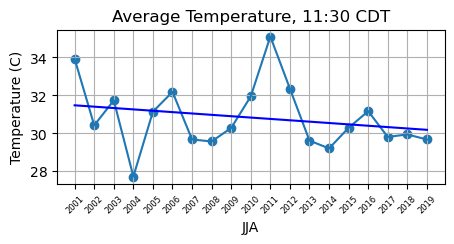

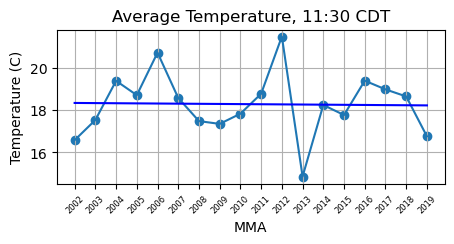

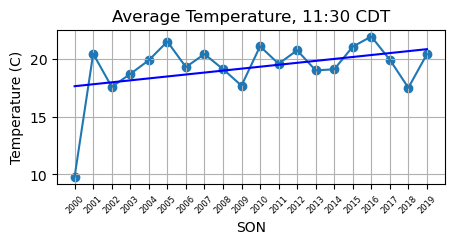

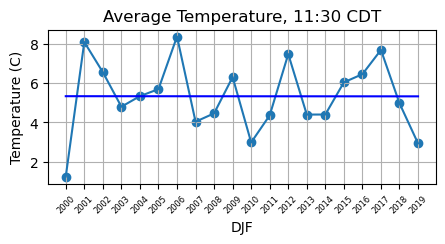

In [774]:
for df in all_seasons:
    plt.figure(figsize=(5, 2))
    plt.scatter(df['year'], df['mean_temp'])
    xlab = df.loc[0, 'season']
    plt.xlabel(xlab)
    plt.ylabel('Temperature (C)')
    plt.title('Average Temperature, 11:30 CDT')
    plt.xticks(df['year'], rotation=45, fontsize=6)
    
    plt.grid(True)

    # Adding trendline
    x = np.arange(len(df))
    y = df['mean_temp']

    # Fit a linear regression model
    reg = LinearRegression()
    reg.fit(x.reshape(-1, 1), y)

    # Calculate the predicted y-values (trend line)
    y_pred = reg.predict(x.reshape(-1, 1))

    # Plotting the data and trend line
    plt.plot(df['year'], df['mean_temp'], label='Data')
    plt.plot(df['year'], y_pred, color='blue', label='Trend Line')

    plt.show()

<bound method _make_class_factory.<locals>.class_factory.<locals>.subcls.set of <AxesSubplot: title={'center': 'Average Surface Temperature'}, xlabel='Year', ylabel='degrees C'>>

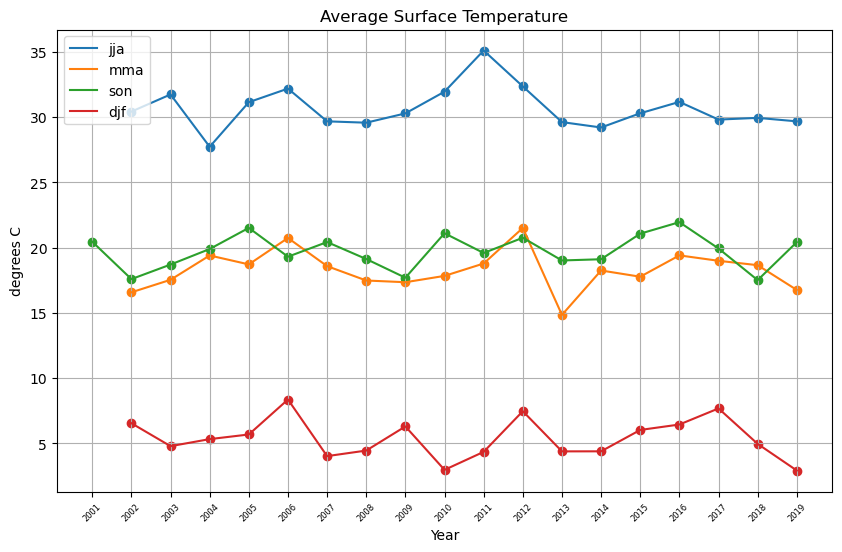

In [1458]:
fig, ax = plt.subplots(figsize=(10, 6))

seasons = ['jja', 'mma', 'son', 'djf']

# Iterate over each season's DataFrame
for i, season_df in enumerate([avg_temps_jja, avg_temps_mma, avg_temps_son, avg_temps_djf]):
    season_df = season_df[season_df['count_values'] > 30]
    plt.scatter(season_df['year'], season_df['mean_temp'])
    plt.plot(season_df['year'], season_df['mean_temp'],label=seasons[i])
# Customize the plot
plt.grid(True)
ax.legend()
plt.xticks(avg_dps_jja['year'], rotation=45, fontsize=6)
ax.set_xlabel('Year')
ax.set_title("Average Surface Temperature")
ax.set_ylabel('degrees C')
ax.set

In [778]:
# Performing the Mann-Kendall test on full data seasonal LCLs
# shows "decreasing" (ie increasing) significance for all but djf 

seasonal_list = ['JJA', 'MMA', 'SON', 'DJF']
for season in seasonal_list:
    mk_full = temp_df_11[temp_df_11['season'] == season]
    mk_full = temp_df_11["temp"].to_list()
    result = mk.original_test(mk_full)

    # Extract the test statistic and p-value from the result
    test_statistic = result.trend
    p_value = result.p

    # Print the results
    print("Mann-Kendall Test Statistic:", season, test_statistic)
    
    #1-(p-value) represents the probability that the alternative hypothesis is true
    #the alternative hypothesis being that a trend exists
    #the null hypothesis being that no trend exists
    
    print("P-value:", p_value)

Mann-Kendall Test Statistic: JJA no trend
P-value: 0.07599158024640307
Mann-Kendall Test Statistic: MMA no trend
P-value: 0.07599158024640307
Mann-Kendall Test Statistic: SON no trend
P-value: 0.07599158024640307
Mann-Kendall Test Statistic: DJF no trend
P-value: 0.07599158024640307


In [1459]:
darmdata_cleaned[0]

<xarray.Dataset>
Dimensions:      (time: 3081)
Dimensions without coordinates: time
Data variables: (12/18)
    base_time    datetime64[ns] 2000-06-15T14:57:00
    time_offset  (time) datetime64[ns] 2000-06-15 ... 2000-06-15T01:42:40
    pres         (time) float32 973.3 971.8 970.9 969.4 ... 48.0 47.9 47.9 47.8
    tdry         (time) float32 25.2 24.2 23.6 23.5 ... -59.1 -59.2 -59.2 -59.2
    dp           (time) float32 16.9 13.8 13.2 13.4 ... -90.2 -90.3 -90.3 -90.3
    wspd         (time) float32 ...
    ...           ...
    qcmin1-24    (time) float32 ...
    qcmax1-24    (time) float32 ...
    qcdelta1-24  (time) float32 ...
    lat          (time) float32 36.61 36.61 36.61 36.61 ... 36.28 36.28 36.28
    lon          (time) float32 -97.49 -97.49 -97.49 ... -97.06 -97.06 -97.06
    alt          (time) float32 315.0 328.0 336.0 ... 2.104e+04 2.105e+04
Attributes: (12/28)
    ingest-software:             sonde_ingest.c,v 6.1 1999/12/21 22:51:24 gau...
    site-id:                    sgp
    facility-id:                C1 : Central_Facility
    sds-mode:                   production
    sample-int:                 1.2 seconds
    averaging-int:              None.
    ...                         ...
    launch_status:              \n990006151 SGP/CART/CF/MW15
\n74646
\n000615...
    proc-level:                 a1
    input-source:               A0 data:sonde1:/data/raw/sondeC1/in/2000JUN15...
    comment:                    The time assigned to each data point indicate...
    zeb_platform:               sgpsondewnpnC1.a1
    history:                    created by the Zebra DataStore library, 14-Ju...

In [23]:
#LCL calcs span about half a degree in NS and EW directions
#mixed layer LCL calculation
mp_lcl_calcs = []
for file in darmdata_cleaned:
    
    pres = file.variables['pres'][:].data * units.hPa
    tdry = file.variables['tdry'][:].data * units.degC
    dp = file.variables['dp'][:].data * units.degC
    
    #uses function time_adjustment to extract true launch of balloon 
    time = time_adjustment(file)
    time = datetime.datetime(*time)
    
    mp = mpcalc.mixed_parcel(pres, tdry, dp, depth=50 * units.hPa)
    
    lcl = mpcalc.lcl(mp[0], mp[1], mp[2])
    lcl_tuple = (lcl[0], time)
    mp_lcl_calcs.append(lcl_tuple)
    

/data/rong3/annie/anaconda3/envs/annieenv/lib/python3.9/site-packages/metpy/calc/thermo.py:1384: RuntimeWarning: invalid value encountered in log
  val = np.log(vapor_pressure / mpconsts.nounit.sat_pressure_0c)
/data/rong3/annie/anaconda3/envs/annieenv/lib/python3.9/site-packages/metpy/calc/thermo.py:1301: RuntimeWarning: overflow encountered in exp
  return mpconsts.nounit.sat_pressure_0c * np.exp(
/data/rong3/annie/anaconda3/envs/annieenv/lib/python3.9/site-packages/metpy/calc/thermo.py:1301: RuntimeWarning: overflow encountered in multiply
  return mpconsts.nounit.sat_pressure_0c * np.exp(
/data/rong3/annie/anaconda3/envs/annieenv/lib/python3.9/site-packages/metpy/calc/thermo.py:1446: RuntimeWarning: invalid value encountered in true_divide
  return molecular_weight_ratio * partial_press / (total_press - partial_press)


In [1284]:
#converts mp_lcl_calcs to a dataframe
lcl_df = pd.DataFrame(mp_lcl_calcs, columns=['pressure', 'date'])

#removing the "hectopascal" from the pressure column
lcl_df['pressure'] = lcl_df['pressure'].apply(lambda x: re.findall('\d+', str(x))[0] if re.findall('\d+', str(x)) else '')

#removing the hectopascal unit from pressure column
lcl_df['pressure'] = lcl_df['pressure'].str.rstrip('hectopascal').astype(str)

#converts pressure column to integers
lcl_df = lcl_df[lcl_df['pressure'] != '']
lcl_df['pressure'] = lcl_df['pressure'].astype(int)

#sets index to be date
lcl_df = lcl_df.set_index("date")

#converts date column to Oklahoma time 
lcl_df.index = pd.to_datetime(lcl_df.index)

lcl_df.index = lcl_df.index - datetime.timedelta(hours=6)

#adding columns for year,month,day,hour
lcl_df['year'] = lcl_df.index.year
lcl_df['month'] = lcl_df.index.month
lcl_df['day'] = lcl_df.index.day
lcl_df['hour'] = lcl_df.index.hour


lcl_df = lcl_df.sort_index()
print(lcl_df.shape)

#drops duplicate rows across lcl_df, basically if same time & day and same lcl calculation
lcl_df = lcl_df.drop_duplicates()
lcl_df.shape

(30470, 5)


(26866, 5)

In [ ]:
lcl_

In [1306]:
#lcl_df["pressure_w_units"] = lcl_df["pressure"].apply(*units.hPa)
#lcl_df["height"] = mpcalc.pressure_to_height_std(lcl_df["pressure_w_units"])
def apply_hpa_units(row):
    return row["pressure"] * units.hPa

lcl_df["pressure_w_units"] = lcl_df.apply(apply_hpa_units, axis=1)

,pressure,year,month,day,hour,pressure_w_units
date,,,,,,
1997-03-05 14:29:00,829,1997,3,5,14,829 hectopascal
1999-05-26 14:30:00,758,1999,5,26,14,758 hectopascal
2000-06-15 08:57:00,802,2000,6,15,8,802 hectopascal
2000-06-16 10:51:00,872,2000,6,16,10,872 hectopascal
2000-10-03 05:30:00,808,2000,10,3,5,808 hectopascal


In [1335]:
def mpcalc_convert_pressure_to_height(row):
    return mpcalc.pressure_to_height_std(row["pressure_w_units"])

lcl_df["height"] = lcl_df.apply(mpcalc_convert_pressure_to_height,axis=1)*1000

In [1334]:

#removing the "hectopascal" from the pressure column
lcl_df["height"] = lcl_df['height'].str.rstrip('kilometer').astype(str)
#lcl_df["height"] = lcl_df["height"].astype(int)
lcl_df.head()

,pressure,year,month,day,hour,pressure_w_units,height
date,,,,,,,
1997-03-05 14:29:00,829,1997,3,5,14,829 hectopascal,nan
1999-05-26 14:30:00,758,1999,5,26,14,758 hectopascal,nan
2000-06-15 08:57:00,802,2000,6,15,8,802 hectopascal,nan
2000-06-16 10:51:00,872,2000,6,16,10,872 hectopascal,nan
2000-10-03 05:30:00,808,2000,10,3,5,808 hectopascal,nan


,pressure,year,month,day,hour,pressure_w_units,height
date,,,,,,,
1997-03-05 14:29:00,829,1997,3,5,14,829 hectopascal,1659.9825647448931 kilometer
1999-05-26 14:30:00,758,1999,5,26,14,758 hectopascal,2380.342698750109 kilometer
2000-06-15 08:57:00,802,2000,6,15,8,802 hectopascal,1927.8095680046613 kilometer
2000-06-16 10:51:00,872,2000,6,16,10,872 hectopascal,1247.6764890925342 kilometer
2000-10-03 05:30:00,808,2000,10,3,5,808 hectopascal,1867.6684443207573 kilometer


In [1313]:
#filters lcl_df dataframe for hour 11 and plots the average LCL per day

lcl_df_11 = lcl_df[lcl_df['hour'] == 11]

# Apply the function to create the "season" column
lcl_df_11['season'] = lcl_df_11['month'].apply(assign_season)
lcl_df_11 = lcl_df_11.sort_index()

#season_lcls = lcl_df_11.groupby(['year', 'season'])['pressure'].mean()
season_lcls = lcl_df_11.groupby(['year', 'season'])['pressure'].agg(['mean', 'size']).rename(columns={'mean': 'mean_pressure', 'size': 'count_values'})
season_height_lcls = lcl_df_11.groupby(['year','season'])['height'].agg(['mean','size']).rename(columns={'mean':'mean_height','size':'count_values'})

season_lcls = pd.DataFrame(season_lcls).reset_index()

avg_lcls_jja = season_lcls[season_lcls['season'] == 'JJA'].reset_index()
avg_lcls_mma = season_lcls[season_lcls['season'] == 'MMA'].reset_index()
avg_lcls_son = season_lcls[season_lcls['season'] == 'SON'].reset_index()
avg_lcls_djf = season_lcls[season_lcls['season'] == 'DJF'].reset_index()

all_seasons = [avg_lcls_jja, avg_lcls_mma, avg_lcls_son, avg_lcls_djf]


/tmp/ipykernel_61746/3303251864.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  lcl_df_11['season'] = lcl_df_11['month'].apply(assign_season)


DimensionalityError: Cannot convert from 'kilometer' to 'dimensionless'

In [1436]:
avg_lcls_djf

,index,year,season,mean_pressure,count_values
0,0,2000,DJF,882.789474,19
1,2,2001,DJF,851.214286,28
2,5,2002,DJF,836.542857,70
3,9,2003,DJF,856.963415,82
4,13,2004,DJF,865.295455,88
5,17,2005,DJF,875.363636,88
6,21,2006,DJF,825.454545,88
7,25,2007,DJF,868.642857,84
8,29,2008,DJF,855.835443,79
9,33,2009,DJF,838.088608,79


In [ ]:
# Define a function to map month numbers to seasons
def assign_season(month):
    if month in [3,4,5]:
        return 'MMA'
    elif month in [6,7,8]:
        return 'JJA'
    elif month in [9,10,11]:
        return 'SON'
    else:
        return 'DJF'

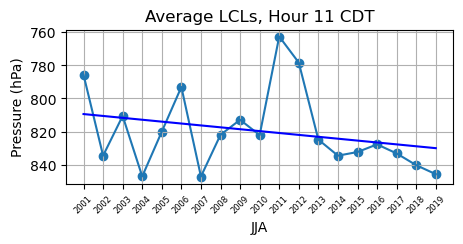

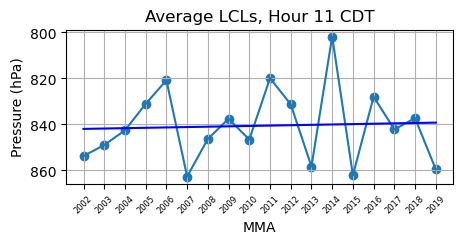

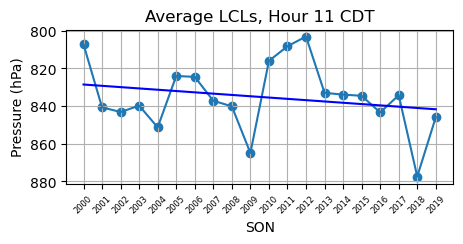

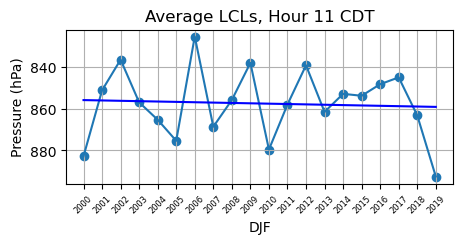

In [1287]:
#print plots for seasonal LCL calculations
for df in all_seasons:
    plt.figure(figsize=(5, 2))
    plt.scatter(df['year'], df['mean_pressure'])
    xlab = df.loc[0, 'season']
    plt.xlabel(xlab)
    plt.ylabel('Pressure (hPa)')
    plt.title('Average LCLs, Hour 11 CDT')
    plt.xticks(df['year'], rotation=45, fontsize=6)

    plt.gca().invert_yaxis()
    plt.grid(True)

    # Adding trendline
    x = np.arange(len(df))
    y = df['mean_pressure']

    # Fit a linear regression model
    reg = LinearRegression()
    reg.fit(x.reshape(-1, 1), y)

    # Calculate the predicted y-values (trend line)
    y_pred = reg.predict(x.reshape(-1, 1))

    # Plotting the data and trend line
    plt.plot(df['year'], df['mean_pressure'], label='Data')
    plt.plot(df['year'], y_pred, color='blue', label='Trend Line')

    plt.show()

In [28]:
# Performing the Mann-Kendall test on full data seasonal LCLs
# shows "decreasing" (ie increasing) significance for all but djf 

seasonal_list = ['JJA', 'MMA', 'SON', 'DJF']
for season in seasonal_list:
    mk_full = lcl_df_11[lcl_df_11['season'] == season]
    mk_full = mk_full["pressure"].to_list()
    result = mk.original_test(mk_full)

    # Extract the test statistic and p-value from the result
    test_statistic = result.trend
    p_value = result.p

    # Print the results
    print("Mann-Kendall Test Statistic:", season, test_statistic)
    
    #1-(p-value) represents the probability that the alternative hypothesis is true
    #the alternative hypothesis being that a trend exists
    #the null hypothesis being that no trend exists
    
    print("P-value:", p_value)


Mann-Kendall Test Statistic: JJA increasing
P-value: 0.000826332405203134
Mann-Kendall Test Statistic: MMA no trend
P-value: 0.7950445172335114
Mann-Kendall Test Statistic: SON no trend
P-value: 0.2794936820251701
Mann-Kendall Test Statistic: DJF no trend
P-value: 0.23407515898409414


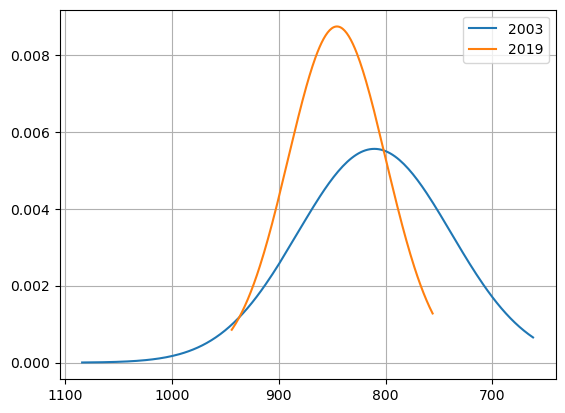

In [38]:
#probability density function for jja drought & wet year 
#years selected are based on the drought monitor for full state of oklahoma

year1 = 2003
year2 = 2019

jja_year1 = lcl_df_11[(lcl_df_11['season'] == 'JJA') & (lcl_df_11['year'] == year1)]

jja_year2 = lcl_df_11[(lcl_df_11['season'] == 'JJA') & (lcl_df_11['year'] == year2)]


pressure_values_year1 = jja_year1["pressure"].to_list()
x_range_year1 = np.linspace(min(pressure_values_year1), max(pressure_values_year1), 200)

pressure_values_year2 = jja_year2["pressure"].to_list()
x_range_year2 = np.linspace(min(pressure_values_year2), max(pressure_values_year2), 200)

m_year1 = np.mean(pressure_values_year1)
std_year1 = np.std(pressure_values_year1)

m_year2 = np.mean(pressure_values_year2)
std_year2 = np.std(pressure_values_year2)

# Calculate the PDF values for the range of values
pdf_input_year1 = stats.norm.pdf(x_range_year1, loc=m_year1, scale=std_year1)
pdf_input_year2 = stats.norm.pdf(x_range_year2, loc=m_year2, scale=std_year2)

# Plot the PDF curve
plt.plot(x_range_year1, pdf_input_year1, label=year1)
plt.plot(x_range_year2, pdf_input_year2, label=year2)

plt.grid(True)
#plt.gca().invert_xaxis()
plt.legend()
plt.show()



In [995]:
#functions to use in lcl checks
def convert_pres_to_height(p,hb,tb,pb):
    gas_constant = 8.31432
    lapse_rate = -0.0065
    gravity = 9.80665
    molar_mass = 0.0289644
    k = (-gas_constant*lapse_rate)/(gravity*molar_mass)
    h = hb + (tb/lapse_rate)*((p/pb)**k - 1)
    return h

def convert_c_to_k(temp):
    kelvin = temp + 273.15
    return kelvin

In [283]:
#verifying LCL calculation using barometric formula
lcl_check = []
for file in darmdata_cleaned:
    
    pres = file.variables['pres'][:].data * units.hPa
    tdry = file.variables['tdry'][:].data * units.degC
    dp = file.variables['dp'][:].data * units.degC
    mp = mpcalc.mixed_parcel(pres, tdry, dp, depth=50 * units.hPa)
    lcl = mpcalc.lcl(mp[0], mp[1], mp[2])
    
    p_lcl = lcl[0].magnitude
    tb = convert_c_to_k(tdry[0].magnitude)
    pb = pres[0].magnitude
    
    h_lcl = convert_pres_to_height(p_lcl,0,tb,pb)
    
    check = (125*(mp[1]-mp[2]).magnitude)/h_lcl
    lcl_check.append(check)

/data/rong3/annie/anaconda3/envs/annieenv/lib/python3.9/site-packages/metpy/calc/thermo.py:1384: RuntimeWarning: invalid value encountered in log
  val = np.log(vapor_pressure / mpconsts.nounit.sat_pressure_0c)
/data/rong3/annie/anaconda3/envs/annieenv/lib/python3.9/site-packages/metpy/calc/thermo.py:1301: RuntimeWarning: overflow encountered in exp
  return mpconsts.nounit.sat_pressure_0c * np.exp(
/data/rong3/annie/anaconda3/envs/annieenv/lib/python3.9/site-packages/metpy/calc/thermo.py:1301: RuntimeWarning: overflow encountered in multiply
  return mpconsts.nounit.sat_pressure_0c * np.exp(
/data/rong3/annie/anaconda3/envs/annieenv/lib/python3.9/site-packages/metpy/calc/thermo.py:1446: RuntimeWarning: invalid value encountered in true_divide
  return molecular_weight_ratio * partial_press / (total_press - partial_press)


KeyboardInterrupt: 

In [587]:
#verifying lcl calculation plots
rounded_list = list(filter(lambda x: not math.isnan(x), lcl_check))

rounded_list = [round(x * 2) / 2 for x in rounded_list]

frequency_series = pd.Series(rounded_list).value_counts()

frequency_series

1.0    30466
2.0        2
0.5        1
1.5        1
dtype: int64

In [1016]:
#lfc test without mixed parcel
#lengths of pres, tdry, dp all equal
lfc_calcs = []
for file in darmdata_cleaned:
    pres = file.variables['pres'].data * units.hPa
    tdry = file.variables['tdry'].data * units.degC
    dp = file.variables['dp'].data * units.degC
    time = time_adjustment(file)
    lfc = mpcalc.lfc(pres, tdry, dp, which="bottom")
    lfc_tup = (time, lfc)
    lfc_calcs.append(lfc_tup)

IndexError: index 1 is out of bounds for axis 0 with size 1

In [1015]:
#lfcdf = pd.DataFrame(lfc_calcs, columns=['time','lfc'])
len(lfc_calcs)

559

In [1033]:
#level of free convection calculation (LFC)
#lfc is where environmental temperature intersects with parcel profile (calculated with the mixed_parcel function)
#for this loop, about half are NANs? maybe because parcel profile not calculating right, it looks like parcel profile
#is rarely warmer than environment
lfc_calcs = []
for file in darmdata_cleaned:
    pres = file.variables['pres'][:].data * units.hPa
    tdry = file.variables['tdry'][:].data * units.degC
    dp = file.variables['dp'][:].data * units.degC 
    mp = mpcalc.mixed_parcel(pres, tdry, dp, depth=50 * units.hPa)
    time = time_adjustment(file)
    pprofile = mpcalc.parcel_profile(pres, mp[1], mp[2]).to('degC')
    lfc = mpcalc.lfc(pres, tdry, dp, parcel_temperature_profile=pprofile)
    lfc_tup = (lfc,time)
    lfc_calcs.append(lfc_tup)
    print(lfc[0],time)
#     except Exception as e:
#         num_lfc_bugs+=1
#         print(e)
#         continue

    
#     if not np.any(np.isnan(pres)) and not np.any(np.isnan(tdry)) and not np.any(np.isnan(dp)):
#         mp = mpcalc.mixed_parcel(pres, tdry, dp, depth= 50* units.hPa) 
#         if not np.isnan(mp[1].squeeze()) and not np.isnan(mp[2].squeeze()):
#             print(mp)
#             pprofile = mpcalc.parcel_profile(pres.squeeze(), mp[1].squeeze(), mp[2].squeeze()).to('degC')
#             i = mpcalc.lfc(pres, tdry, dp, parcel_temperature_profile=pprofile)
#             lfc_calcs.append(i)

nan hectopascal 2000-06-15 14:57:00
nan hectopascal 2000-06-16 16:51:00
nan hectopascal 2000-10-03 11:30:00
nan hectopascal 2000-11-24 11:28:00
nan hectopascal 2000-11-24 20:31:00
nan hectopascal 2000-11-24 23:28:00
nan hectopascal 2000-11-25 05:30:00
nan hectopascal 2000-11-26 20:29:00
nan hectopascal 2000-11-26 23:29:00
nan hectopascal 2000-11-27 11:40:00
nan hectopascal 2000-11-27 14:31:00
nan hectopascal 2000-11-27 17:30:00
nan hectopascal 2000-11-27 20:31:00
nan hectopascal 2000-11-28 00:29:00
nan hectopascal 2000-11-28 03:30:00
nan hectopascal 2000-11-28 05:42:00
nan hectopascal 2000-11-28 08:28:00
nan hectopascal 2000-11-28 11:27:00
nan hectopascal 2000-11-28 17:31:00
nan hectopascal 2000-11-28 20:31:00
nan hectopascal 2000-11-28 23:28:00
nan hectopascal 2000-11-29 02:30:00
nan hectopascal 2000-11-29 05:29:00
nan hectopascal 2000-11-29 08:32:00
nan hectopascal 2000-11-29 11:30:00
nan hectopascal 2000-11-29 14:29:00
nan hectopascal 2000-11-29 17:30:00
nan hectopascal 2000-11-29 2

ValueError: all the input arrays must have same number of dimensions, but the array at index 0 has 1 dimension(s) and the array at index 1 has 2 dimension(s)

In [1020]:
num_lfc_bugs

551

In [703]:
lfc_calcs_mag = []
for elem in lfc_calcs:
    mag = elem[0].magnitude
    lfc_calcs_mag.append(mag)

In [709]:
#half of the values from lfc calcs are NANs, and about 600 were errors
nan_count = sum(math.isnan(x) for x in lfc_calcs_mag)
non_nan_count = sum(not math.isnan(x) for x in lfc_calcs_mag)
total = nan_count + non_nan_count

nan_count/total

0.5389441366882467

nan hectopascal 802.3589044679399 hectopascal


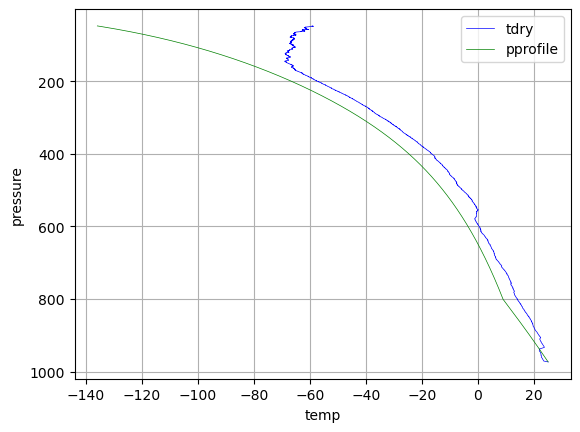

nan hectopascal 872.6312993134583 hectopascal


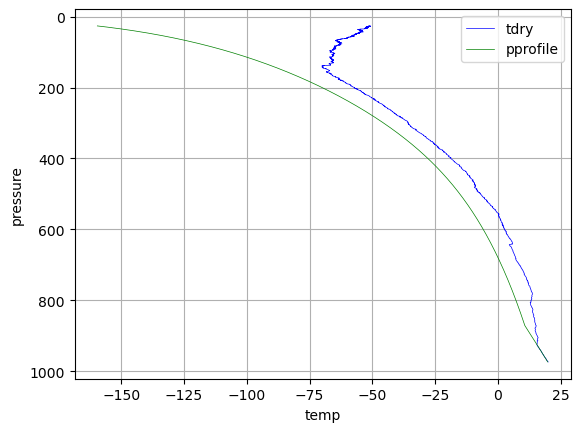

nan hectopascal 808.1524740551025 hectopascal


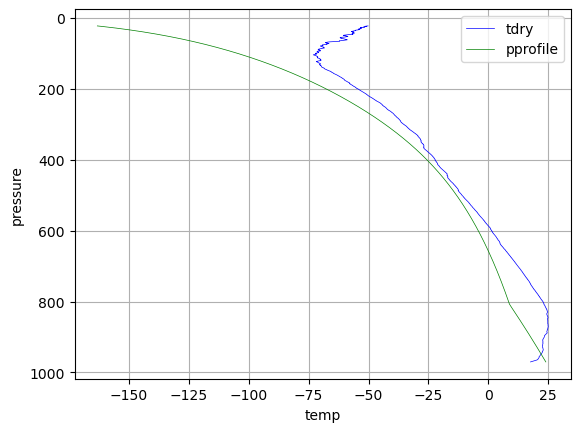

nan hectopascal 906.9240505130664 hectopascal


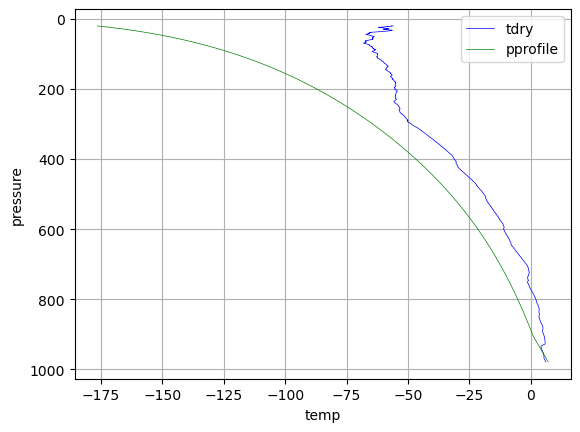

nan hectopascal 891.4572583432443 hectopascal


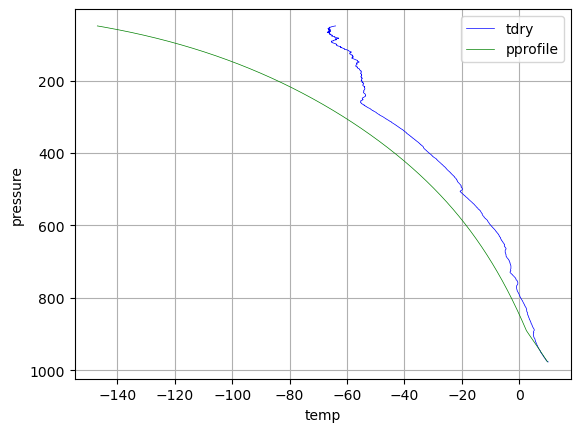

nan hectopascal 859.9730213970349 hectopascal


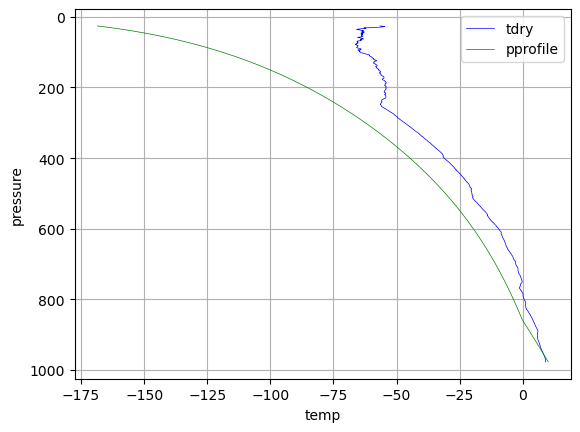

nan hectopascal 853.681039239745 hectopascal


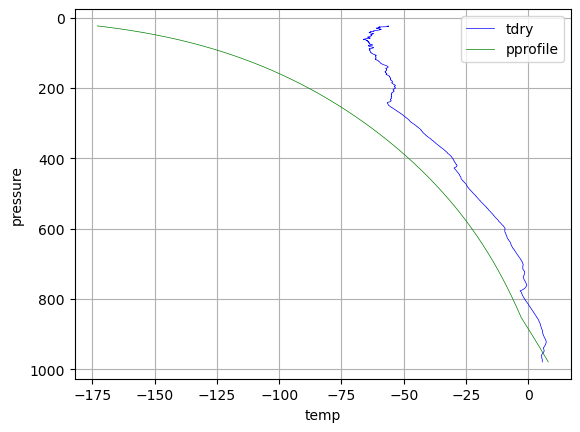

nan hectopascal 792.2368929860494 hectopascal


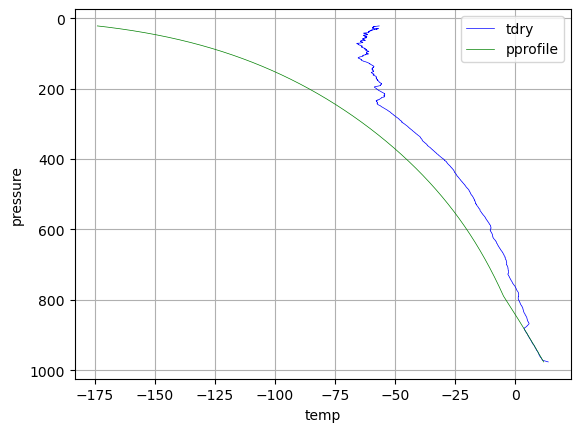

nan hectopascal 806.2683992639239 hectopascal


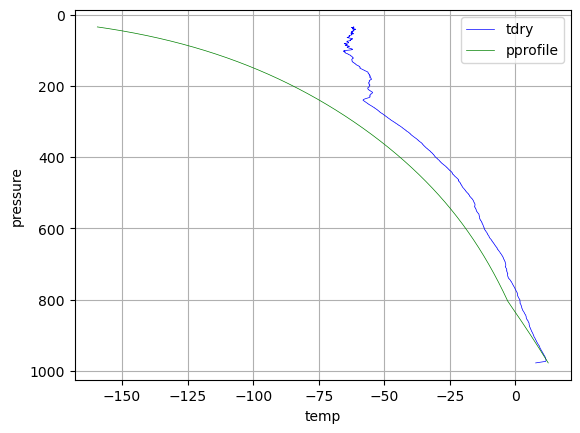

nan hectopascal 841.7807250579973 hectopascal


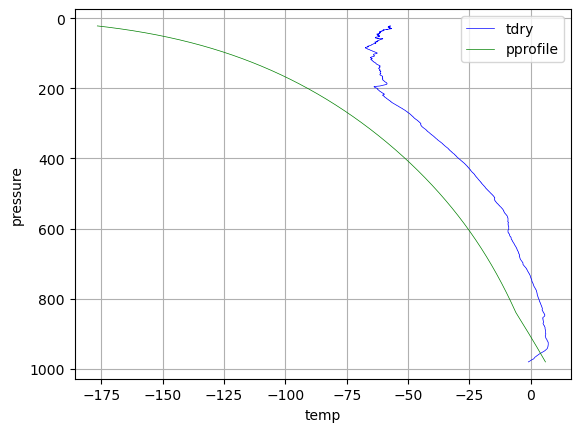

nan hectopascal 828.2144656341758 hectopascal


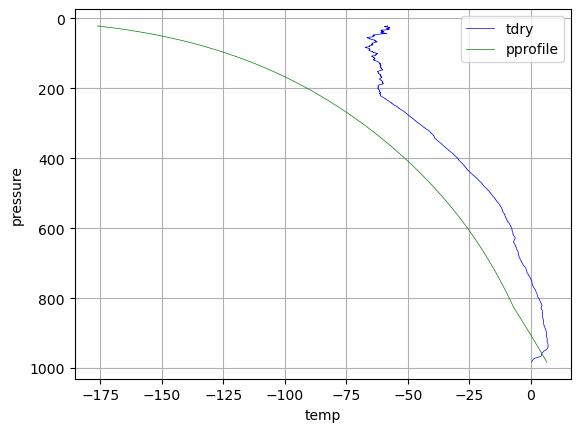

nan hectopascal 816.38878821466 hectopascal


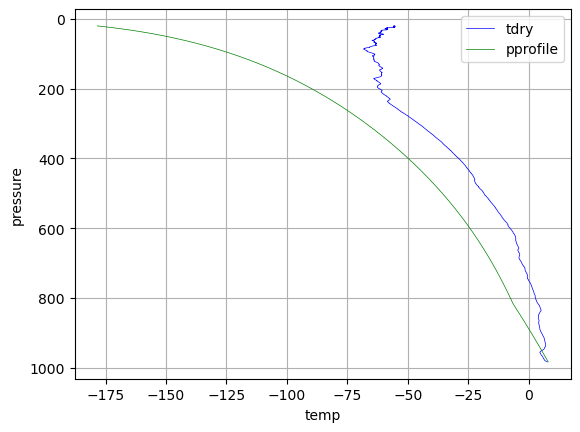

nan hectopascal 787.409157013449 hectopascal


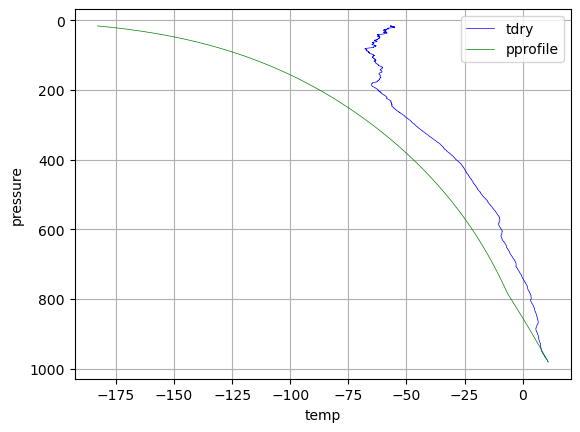

nan hectopascal 765.0899800316009 hectopascal


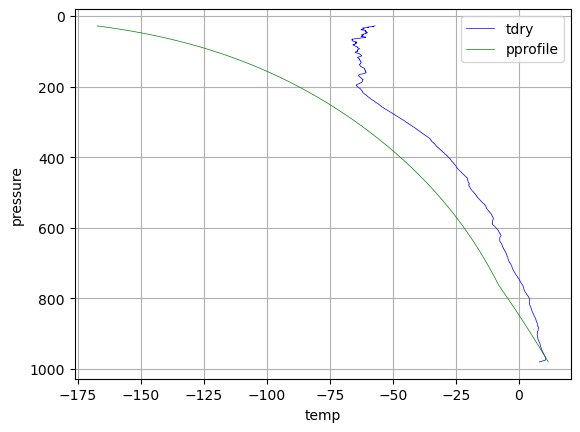

nan hectopascal 798.6916238195043 hectopascal


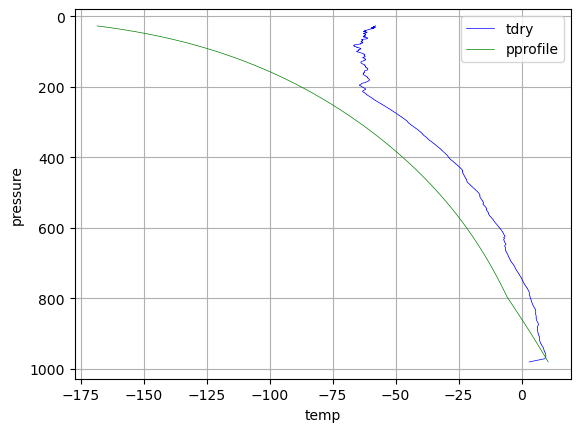

nan hectopascal 797.3068768563943 hectopascal


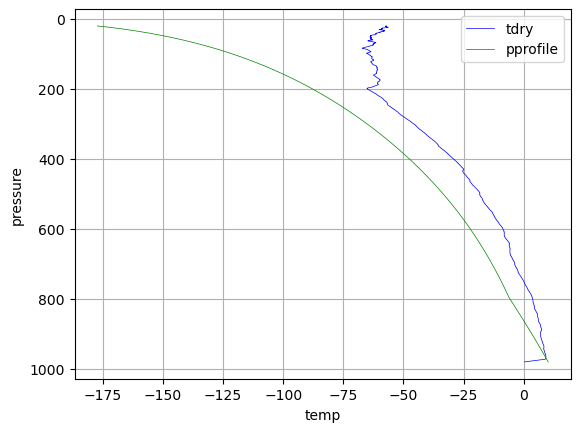

nan hectopascal 794.9815355918367 hectopascal


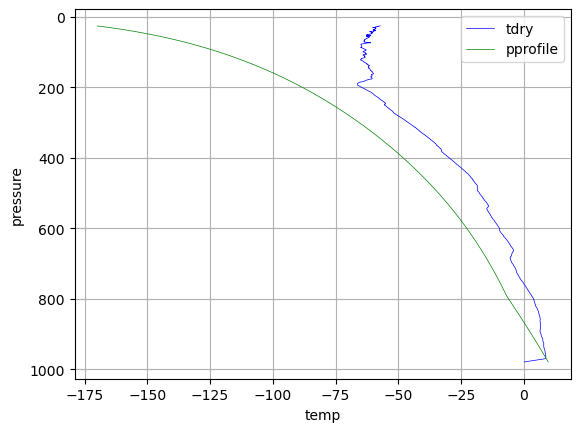

nan hectopascal 816.9894586695768 hectopascal


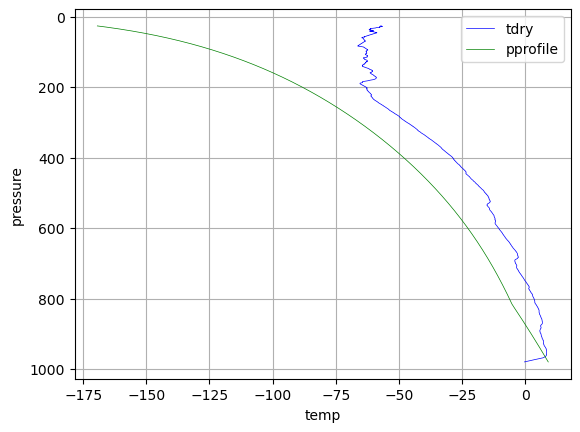

nan hectopascal 840.6565876323668 hectopascal


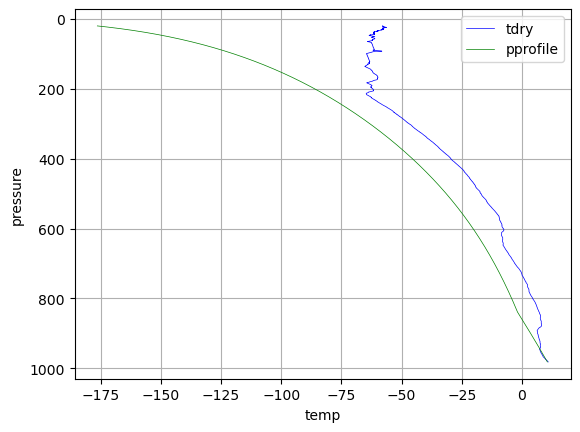

nan hectopascal 841.6643618151572 hectopascal


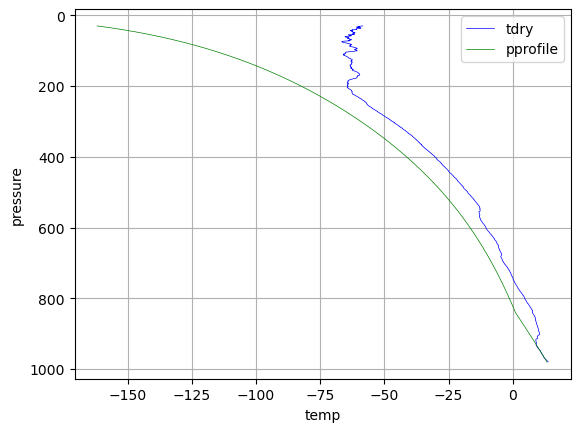

nan hectopascal 802.9116005169792 hectopascal


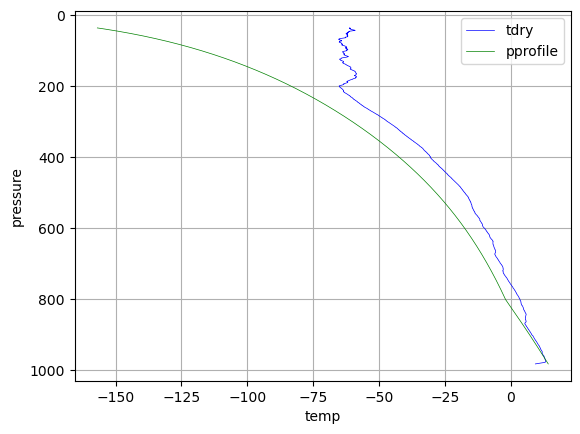

nan hectopascal 798.8580917420823 hectopascal


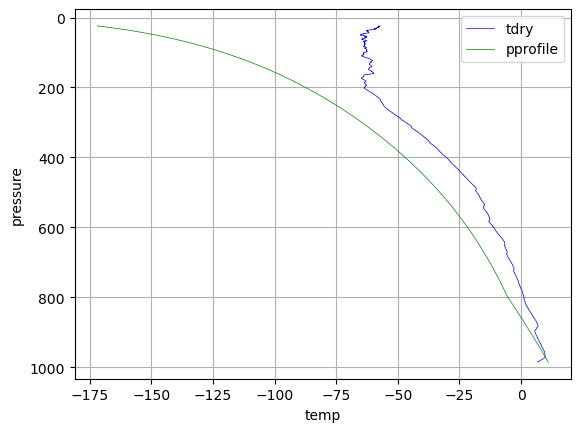

nan hectopascal 808.9529181949301 hectopascal


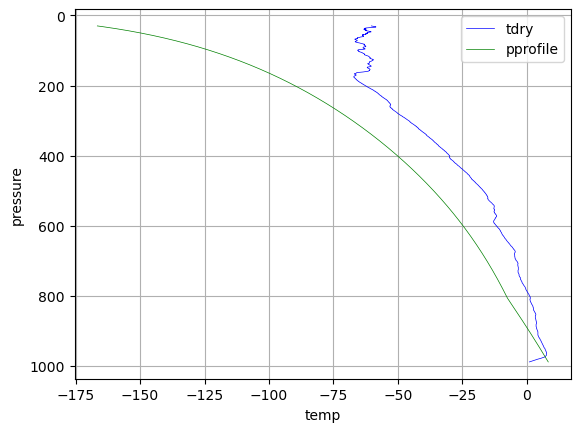

nan hectopascal 801.5663404603982 hectopascal


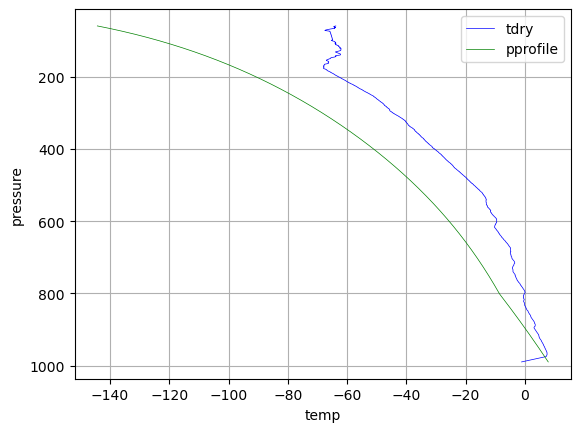

nan hectopascal 805.2938251286796 hectopascal


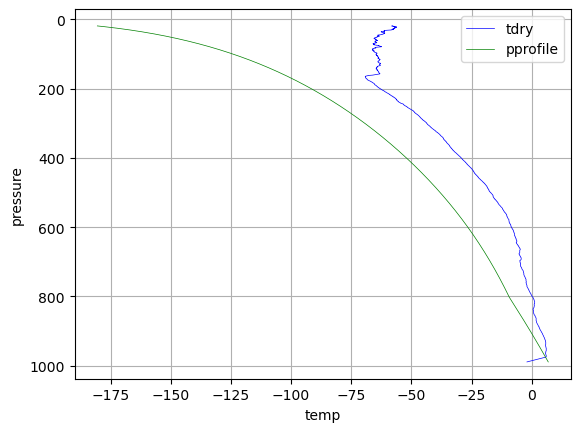

nan hectopascal 832.1891647572105 hectopascal


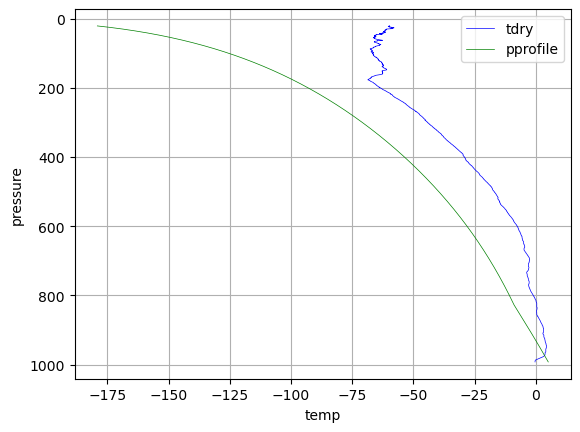

nan hectopascal 812.9466710355218 hectopascal


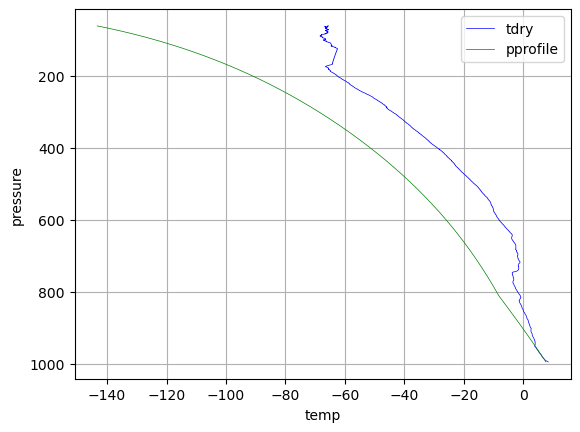

nan hectopascal 752.2981691224958 hectopascal


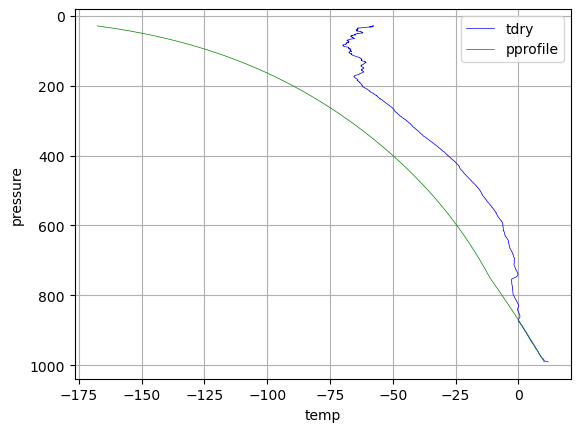

nan hectopascal 738.8484878243308 hectopascal


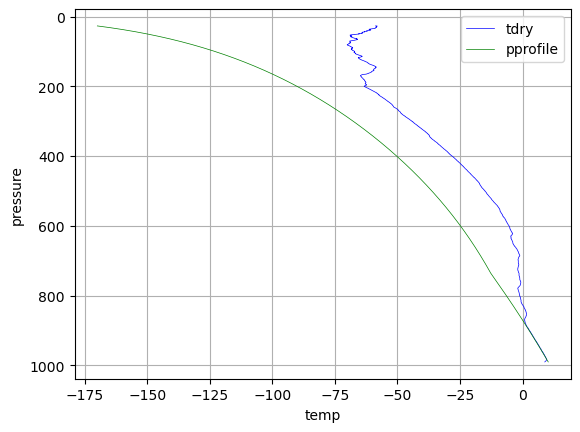

nan hectopascal 750.1476200782953 hectopascal


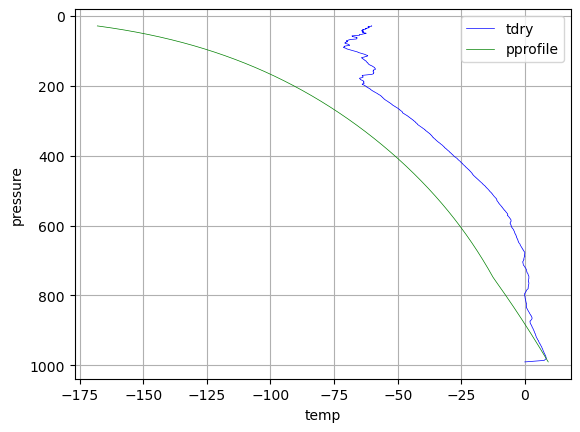

nan hectopascal 759.6768002704781 hectopascal


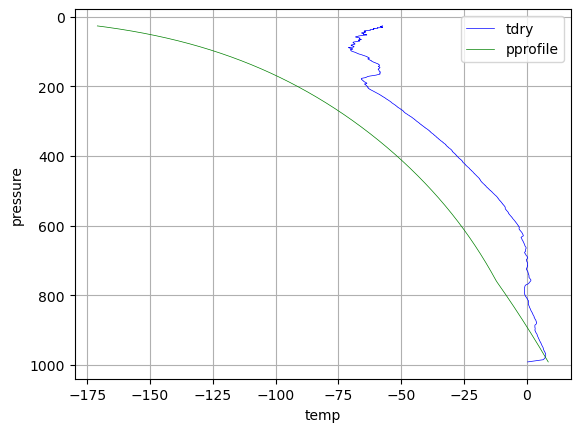

nan hectopascal 768.7652707586946 hectopascal


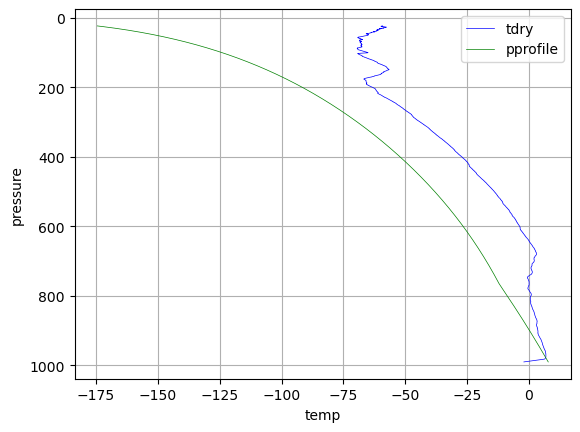

nan hectopascal 793.4289819349832 hectopascal


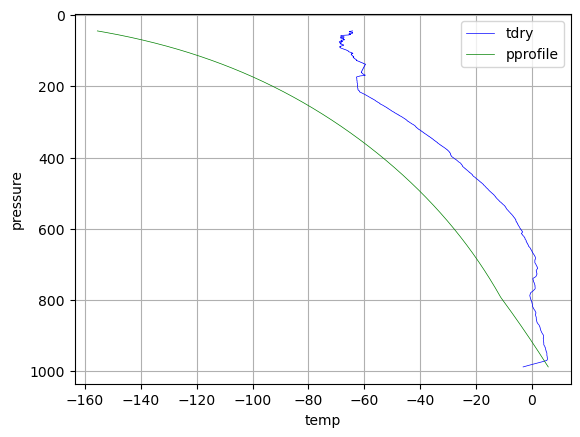

nan hectopascal 782.1122414170823 hectopascal


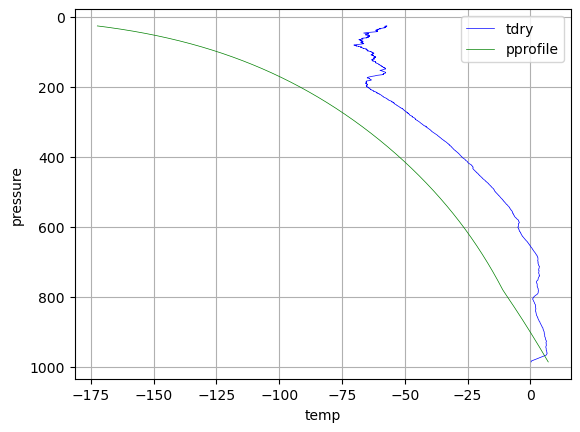

nan hectopascal 761.740673765052 hectopascal


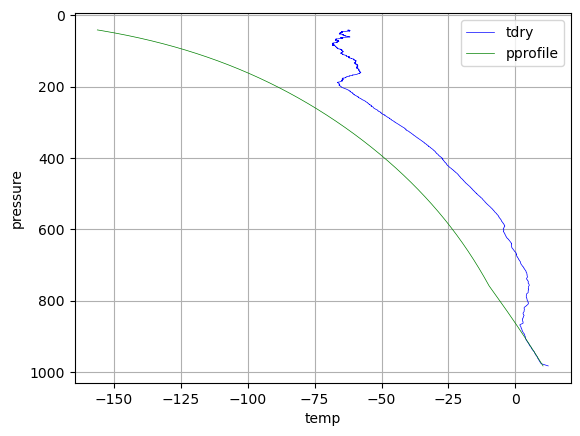

nan hectopascal 796.7362625047232 hectopascal


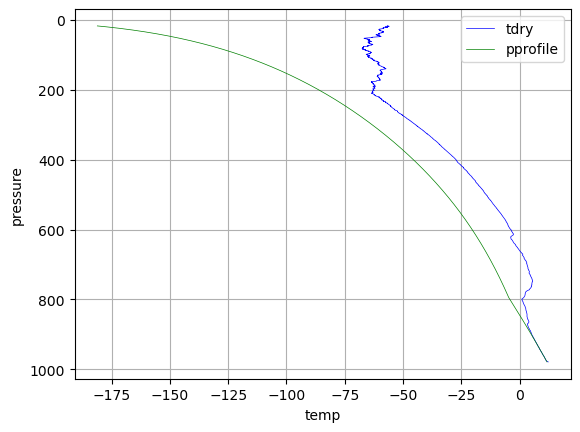

nan hectopascal 805.9890832944743 hectopascal


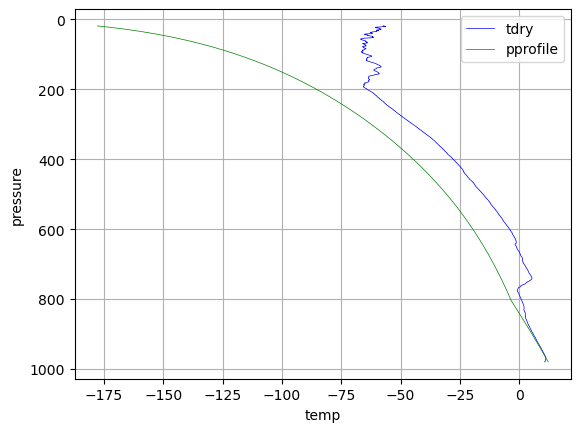

nan hectopascal 854.0590983977147 hectopascal


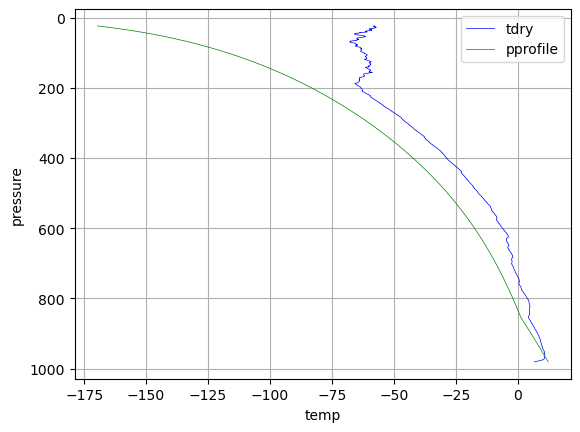

nan hectopascal 873.9606881217754 hectopascal


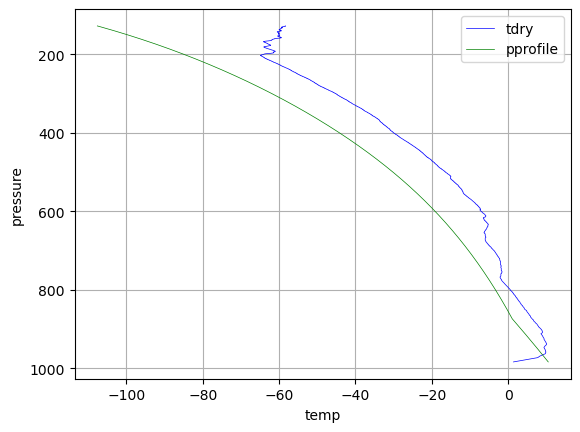

nan hectopascal 837.9471937297869 hectopascal


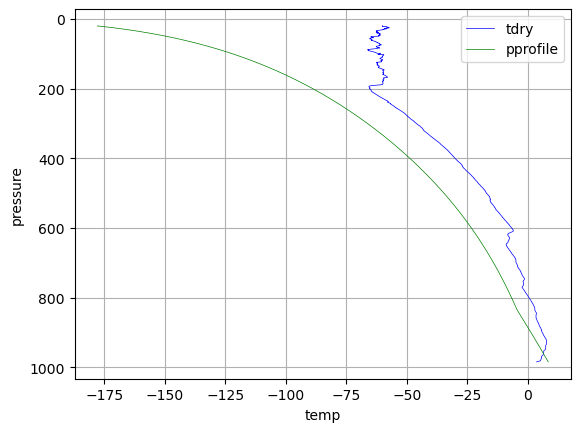

nan hectopascal 856.1060654967566 hectopascal


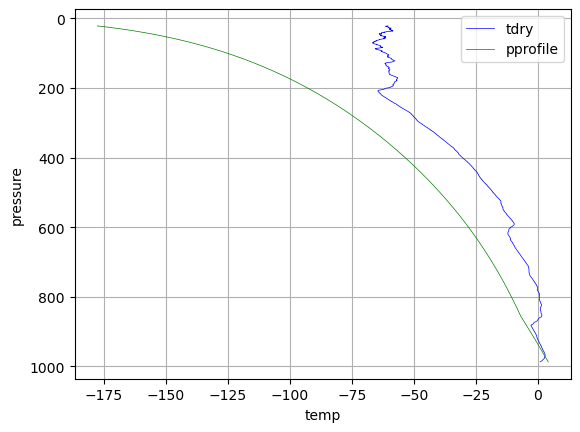

nan hectopascal 863.7982334276973 hectopascal


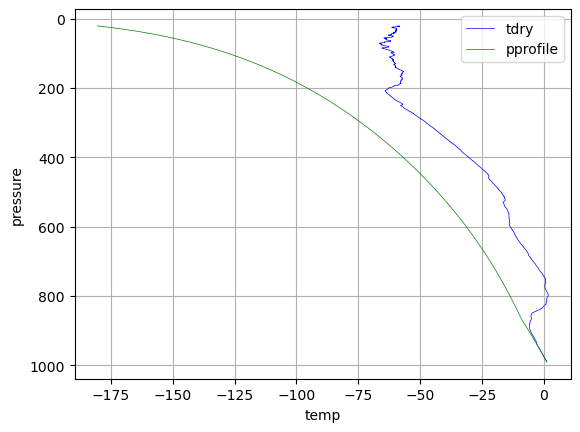

nan hectopascal 861.0019965350496 hectopascal


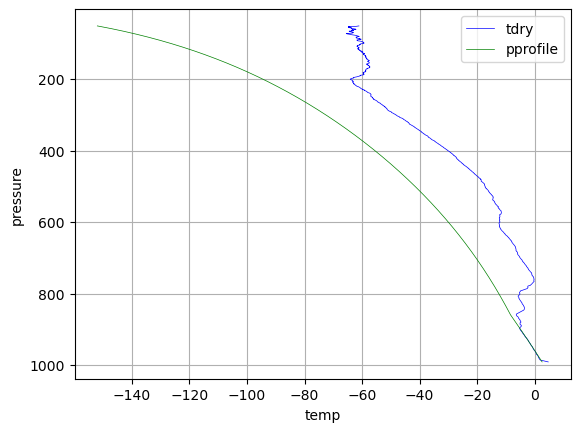

nan hectopascal 852.3166097419835 hectopascal


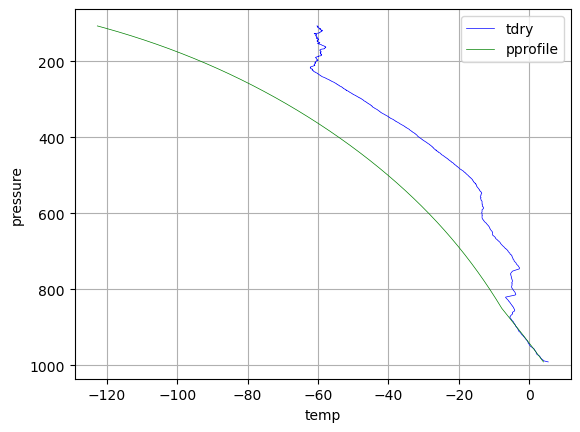

909.4011402210234 hectopascal 903.3278101996016 hectopascal


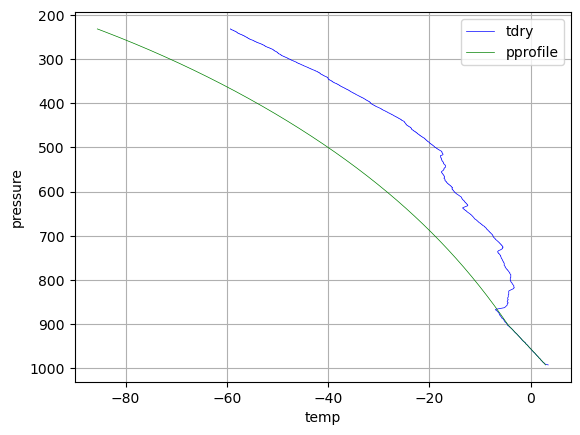

918.0569736541324 hectopascal 911.052165699157 hectopascal


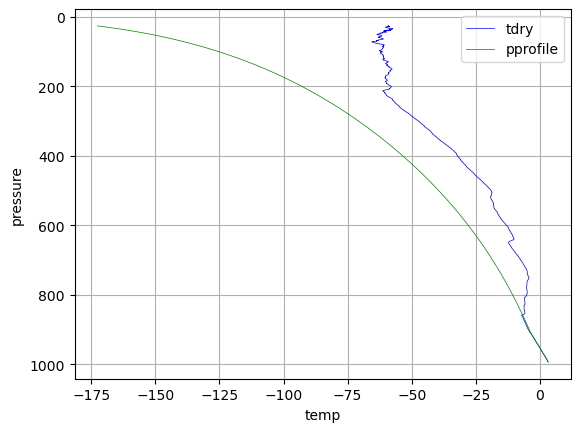

876.8043270788183 hectopascal 928.6931892338423 hectopascal


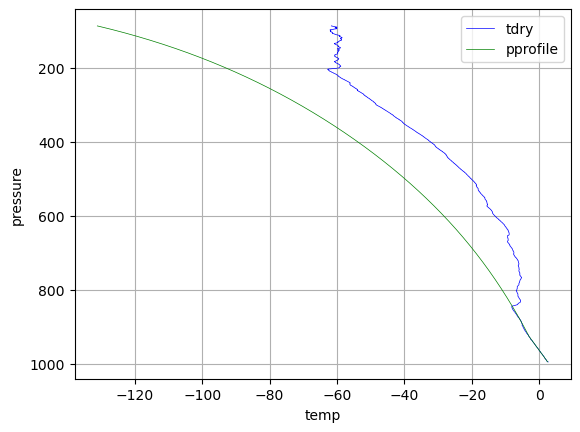

881.0425959913572 hectopascal 938.7698793810097 hectopascal


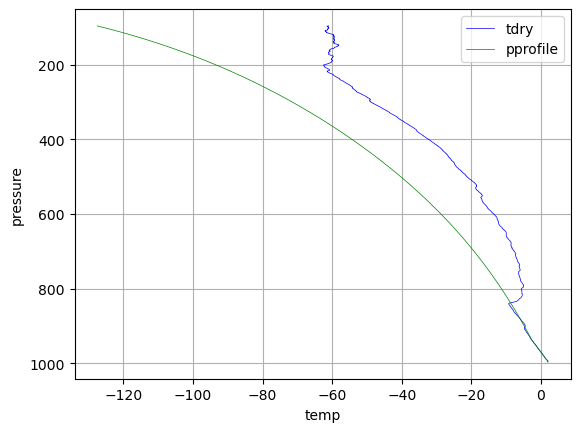

884.1262019489402 hectopascal 927.2558949395149 hectopascal


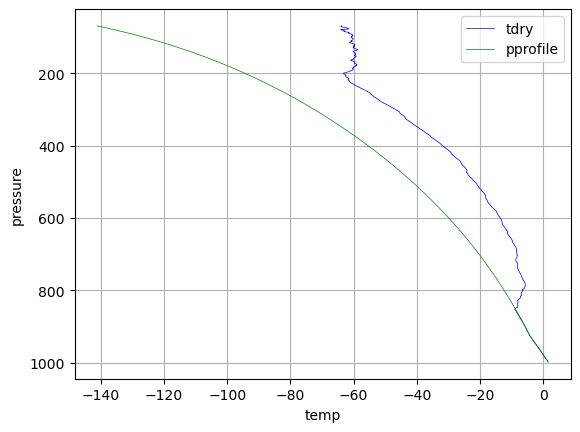

921.9066773647346 hectopascal 923.8189184318513 hectopascal


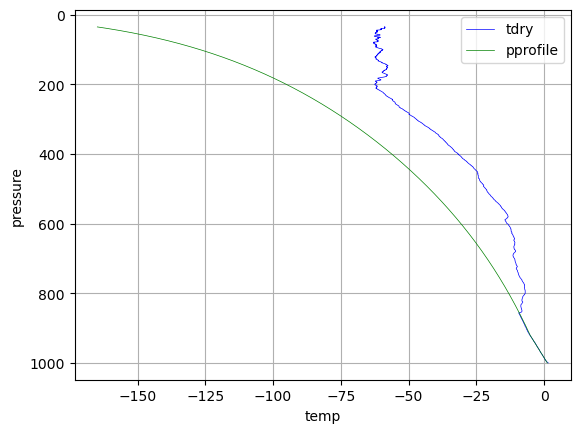

890.2059743234439 hectopascal 904.1366403557557 hectopascal


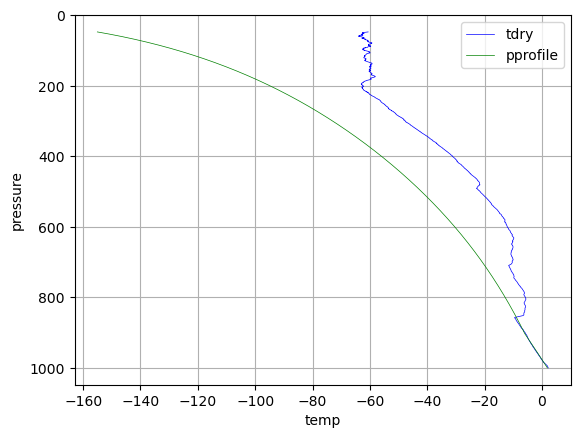

893.4740856153073 hectopascal 876.143909561294 hectopascal


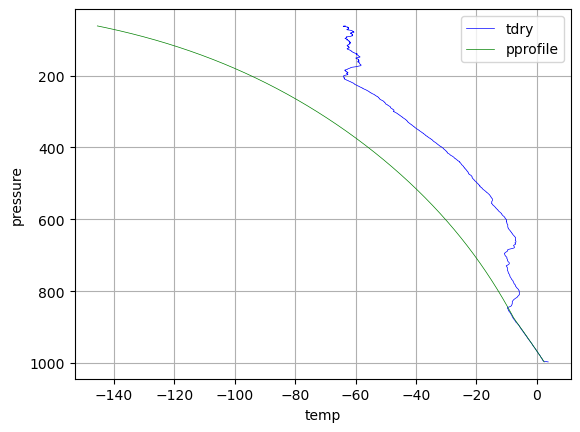

881.7363179528004 hectopascal 875.5104435160976 hectopascal


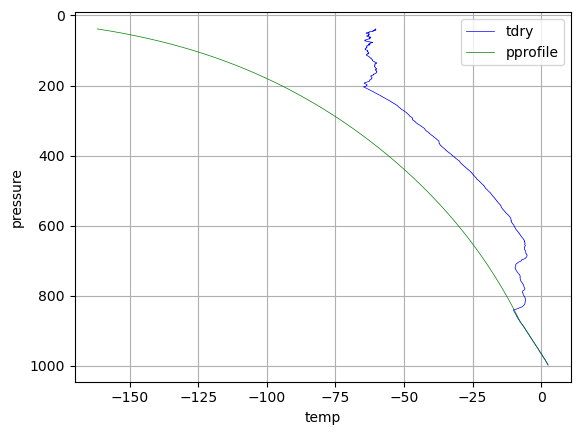

853.1660524975978 hectopascal 869.1018079227988 hectopascal


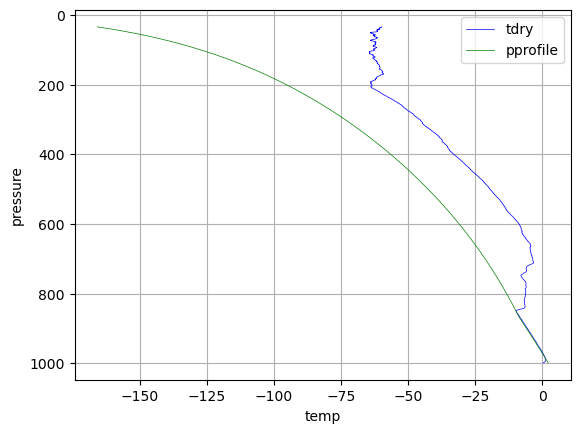

nan hectopascal 900.0687441964624 hectopascal


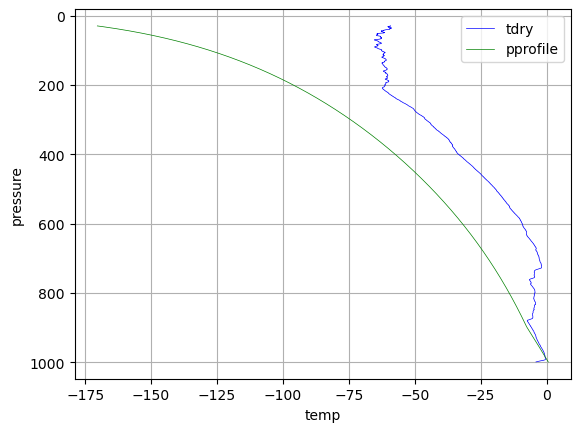

nan hectopascal 889.1094592984348 hectopascal


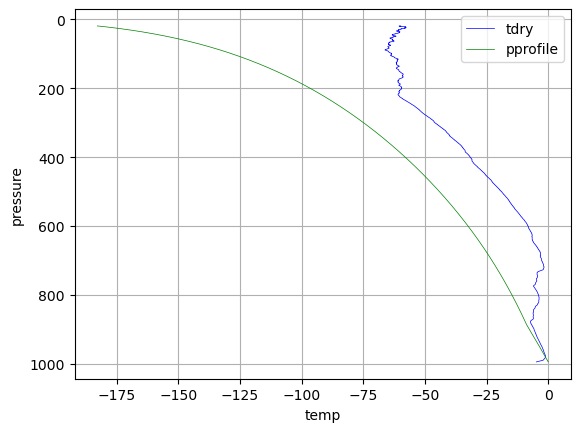

nan hectopascal 898.6024507190085 hectopascal


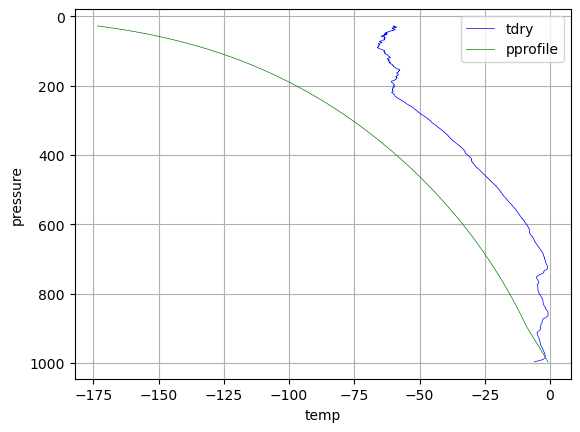

nan hectopascal 909.6715841426337 hectopascal


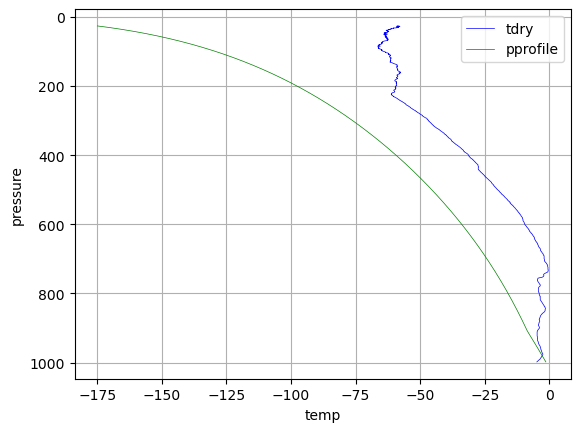

nan hectopascal 875.3927922976382 hectopascal


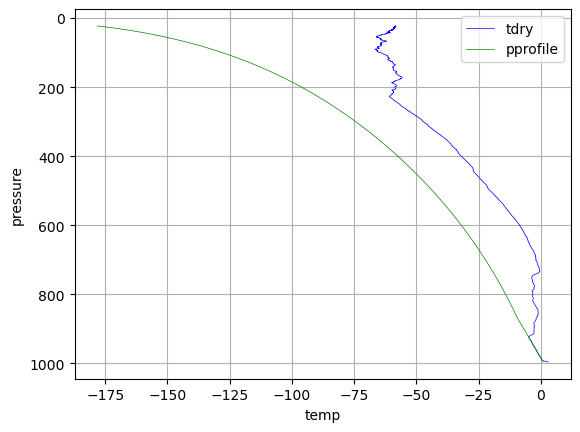

nan hectopascal 831.7888388491842 hectopascal


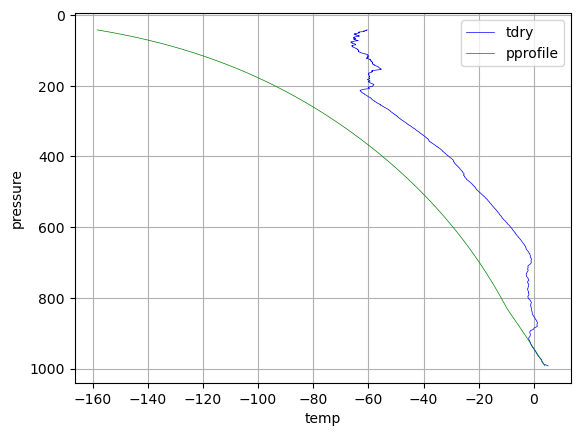

nan hectopascal 822.5186068191256 hectopascal


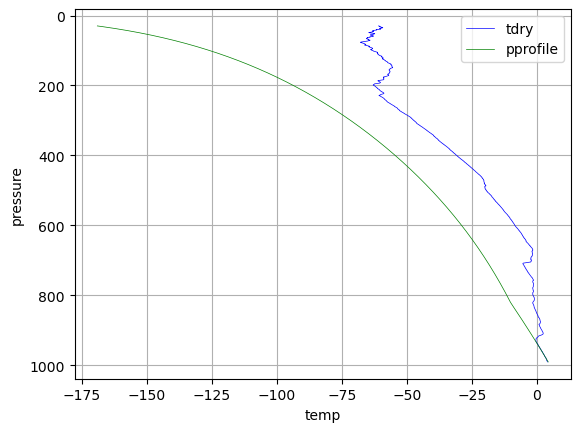

nan hectopascal 844.7108223360467 hectopascal


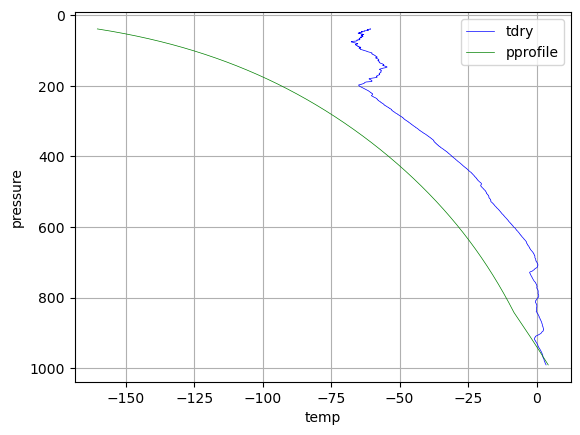

nan hectopascal 883.2155767250239 hectopascal


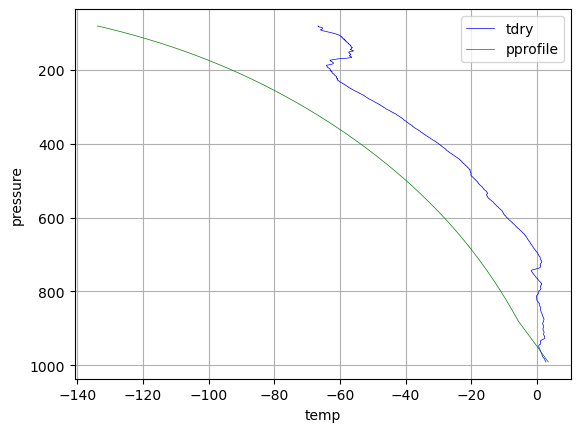

nan hectopascal 895.5746249675527 hectopascal


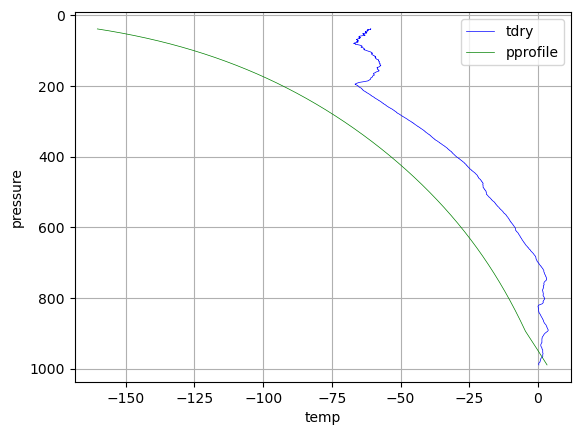

nan hectopascal 941.9548149020768 hectopascal


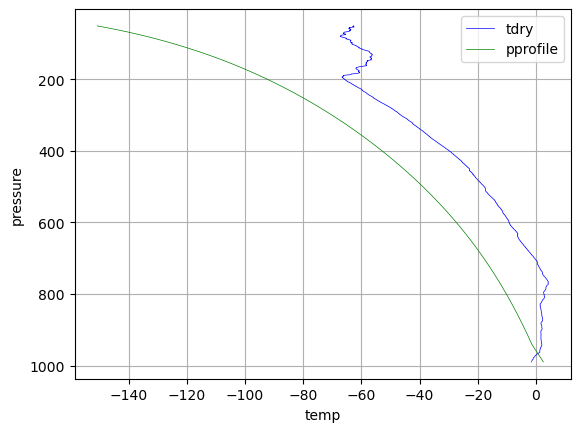

nan hectopascal 941.3511957258149 hectopascal


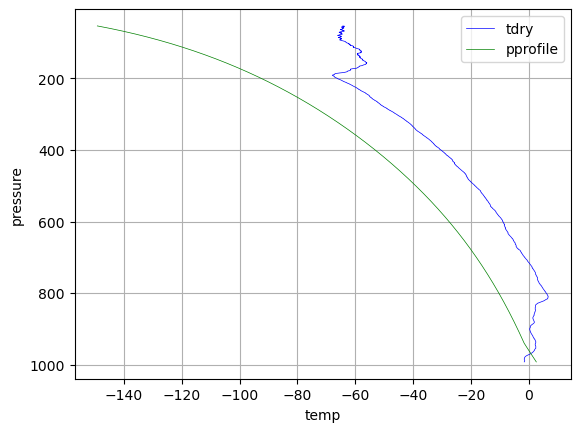

nan hectopascal 917.8664764971934 hectopascal


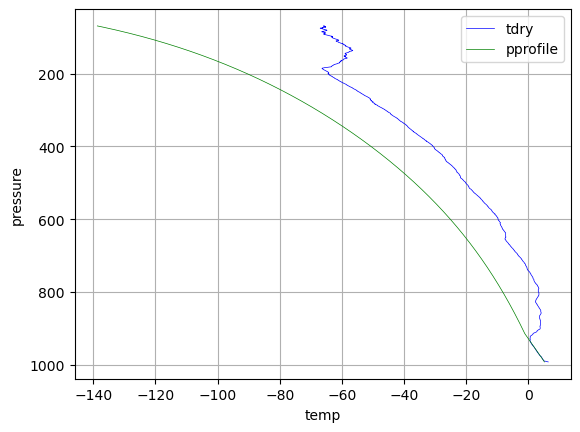

nan hectopascal 862.1710240025573 hectopascal


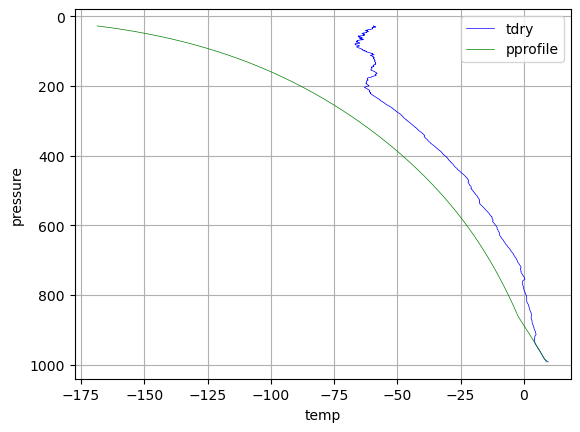

nan hectopascal 840.9672135347516 hectopascal


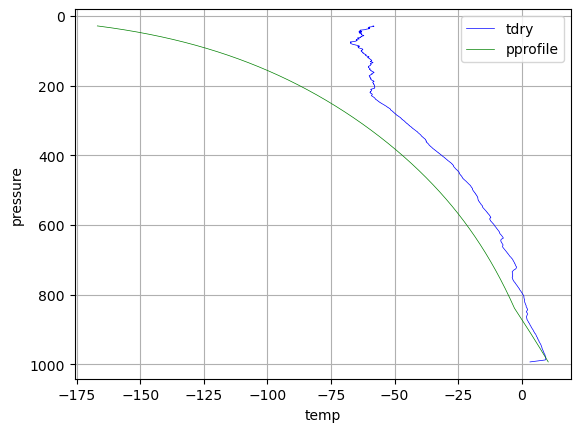

nan hectopascal 822.7397931357996 hectopascal


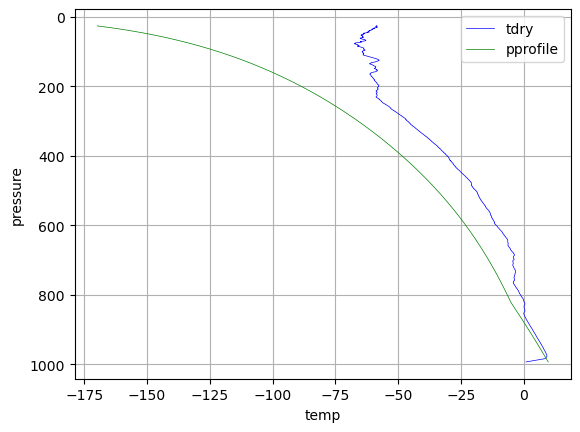

nan hectopascal 869.5757982590591 hectopascal


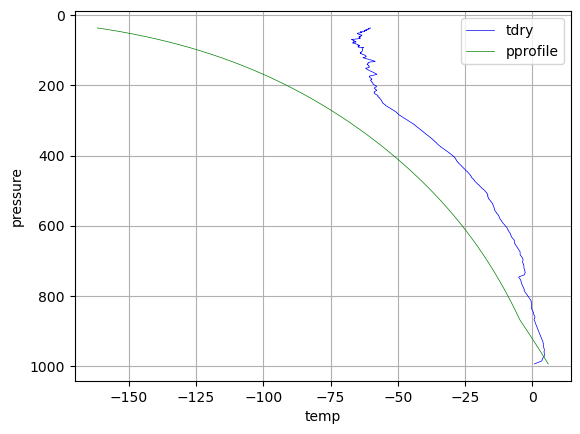

nan hectopascal 875.988701693767 hectopascal


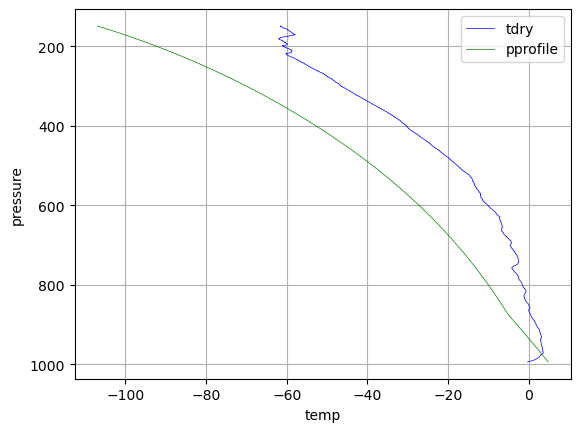

nan hectopascal 887.5364650940935 hectopascal


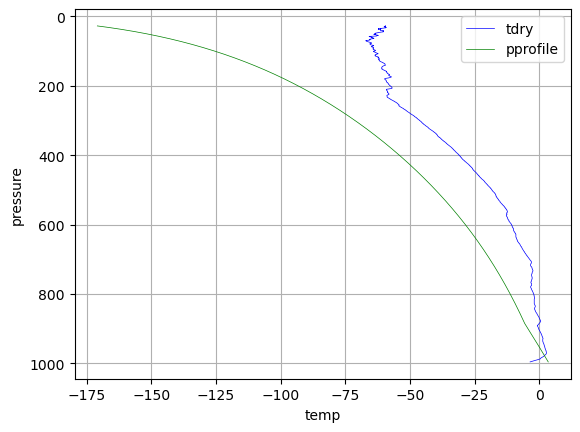

nan hectopascal 900.456482883086 hectopascal


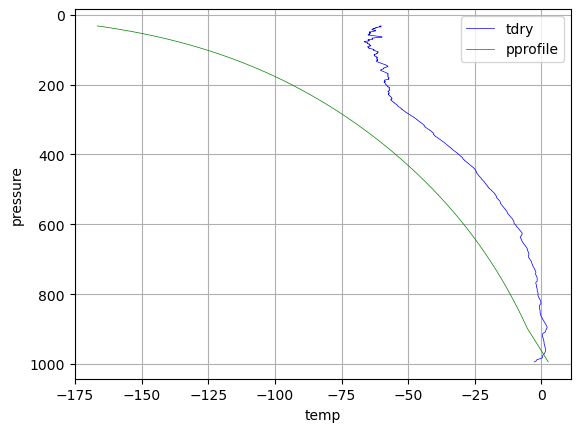

nan hectopascal 880.476355270563 hectopascal


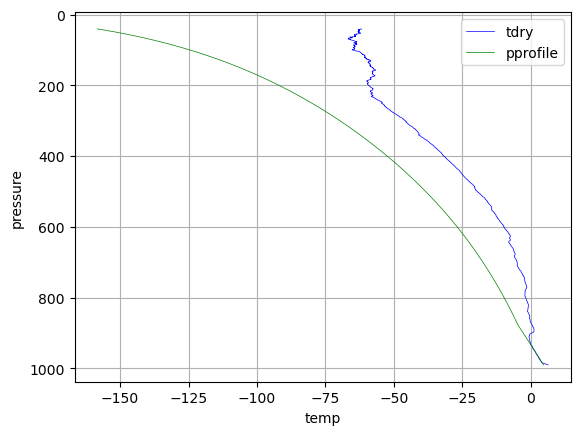

nan hectopascal 860.761638784099 hectopascal


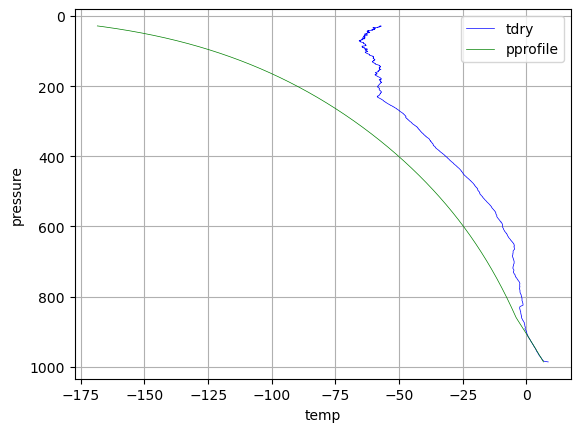

nan hectopascal 852.4829358703661 hectopascal


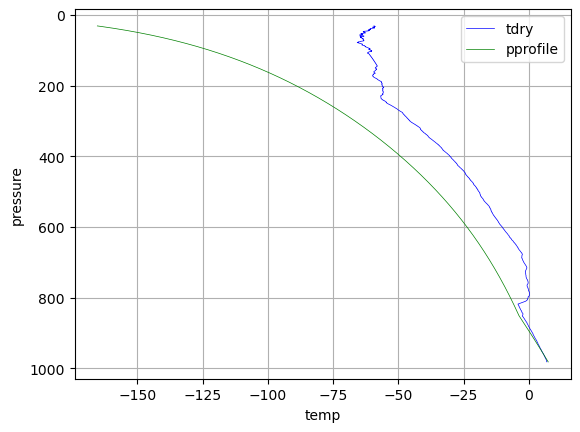

nan hectopascal 856.3359316761189 hectopascal


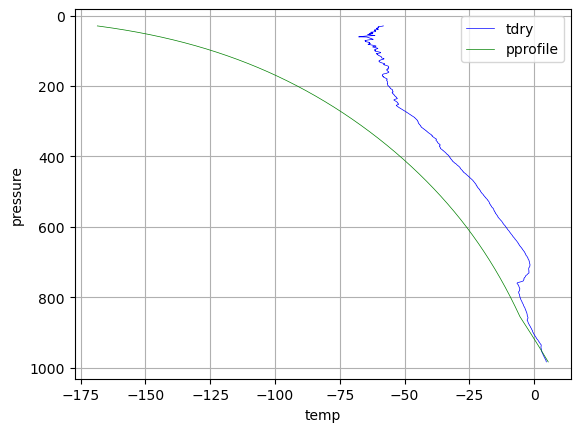

nan hectopascal 887.2867359181315 hectopascal


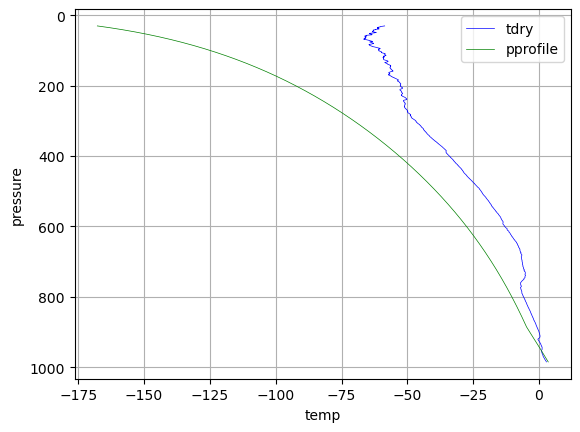

nan hectopascal 893.10578447506 hectopascal


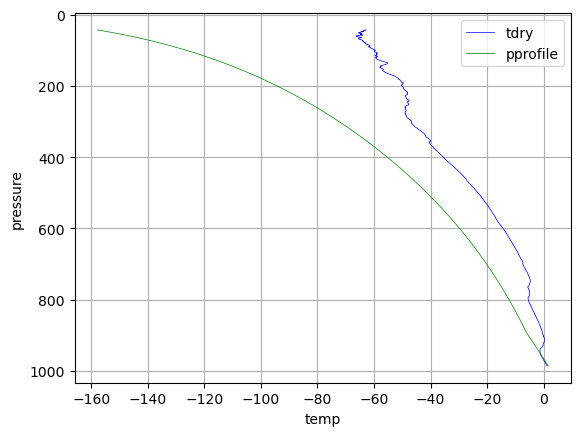

966.7270448290433 hectopascal 949.5079173360267 hectopascal


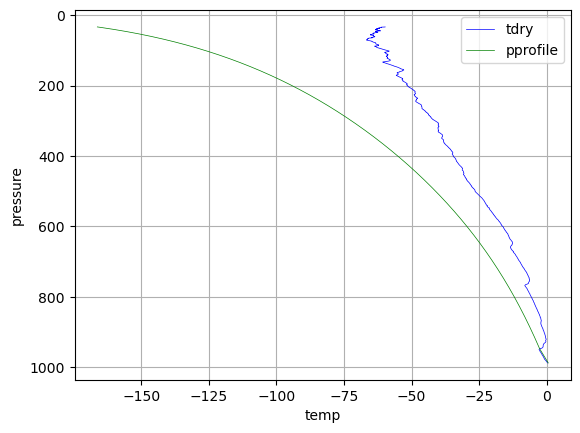

948.5026443692133 hectopascal 947.8615489516122 hectopascal


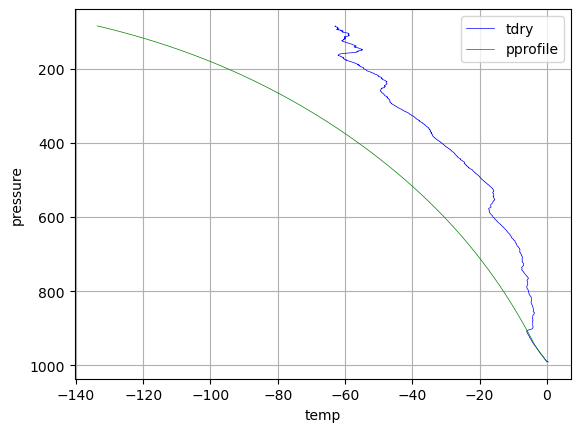

nan hectopascal 907.8673281662102 hectopascal


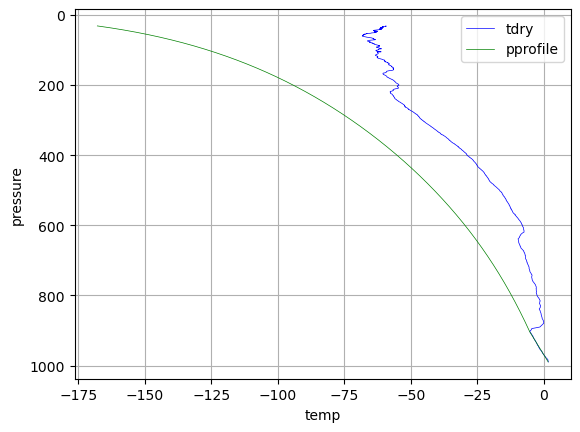

nan hectopascal 864.2249047376117 hectopascal


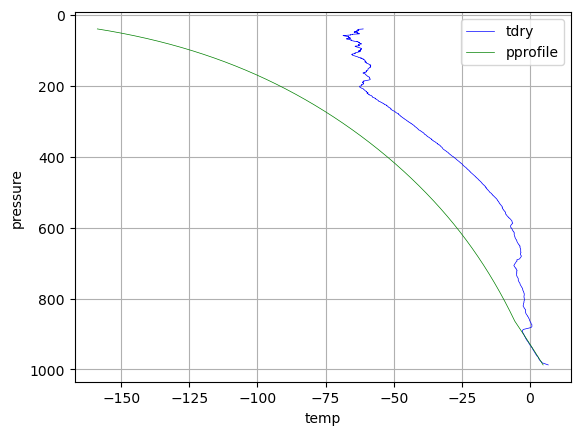

nan hectopascal 858.4726724049879 hectopascal


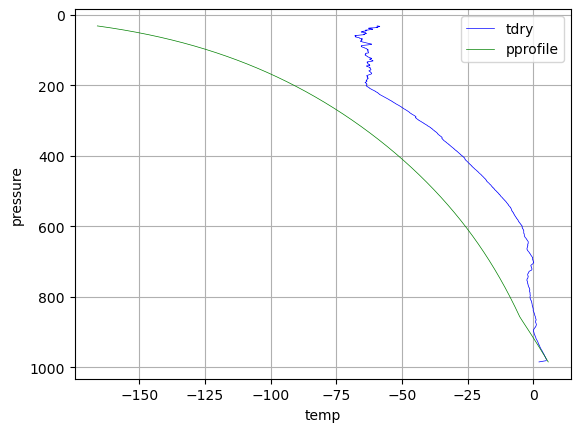

nan hectopascal 817.9713024120135 hectopascal


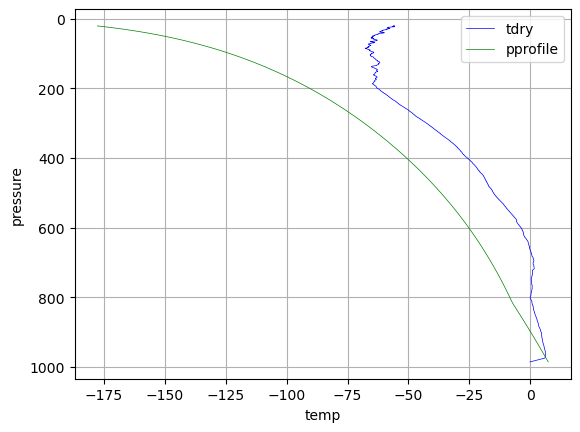

nan hectopascal 764.8046496750928 hectopascal


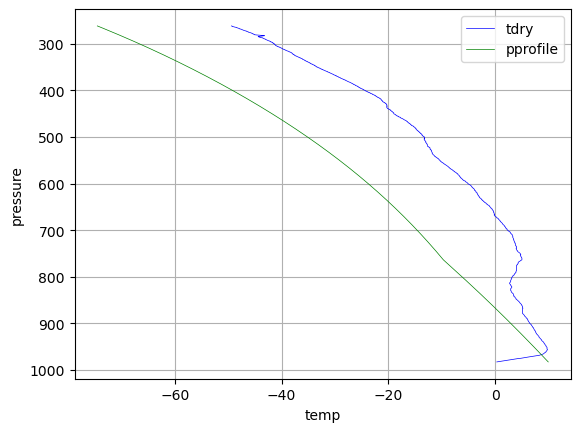

nan hectopascal 738.4823795310003 hectopascal


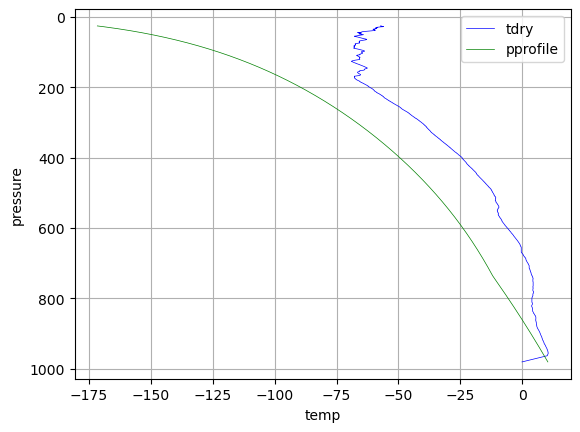

nan hectopascal 733.0059214057557 hectopascal


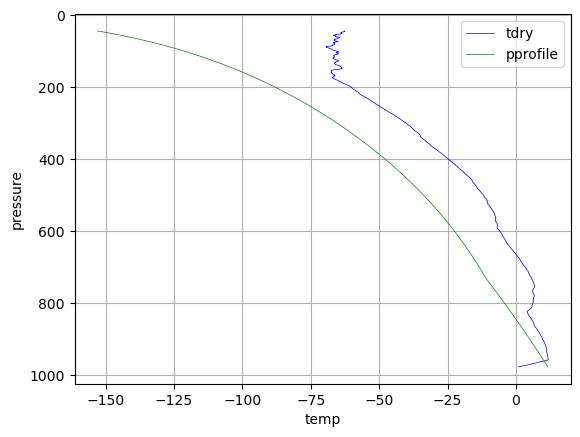

nan hectopascal 758.4041450039612 hectopascal


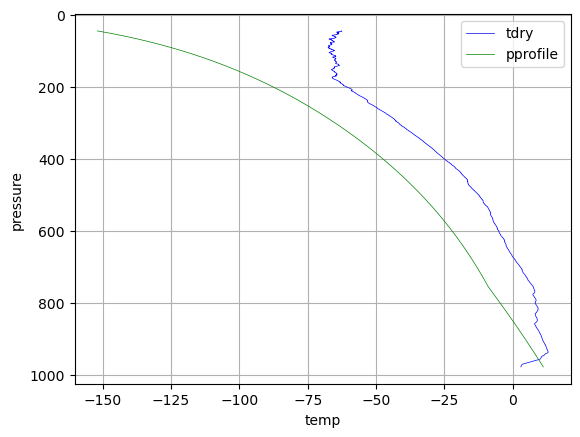

nan hectopascal 764.3019447139285 hectopascal


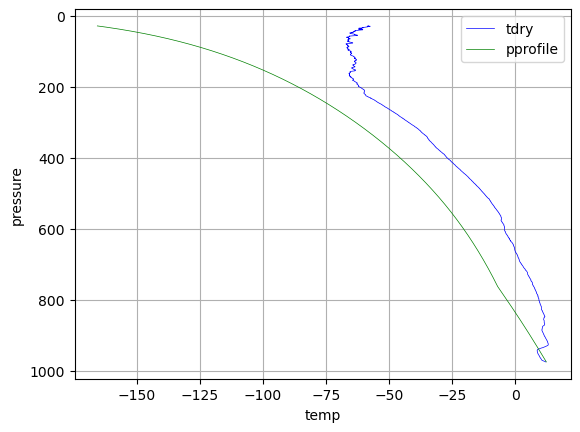

nan hectopascal 736.7379212366321 hectopascal


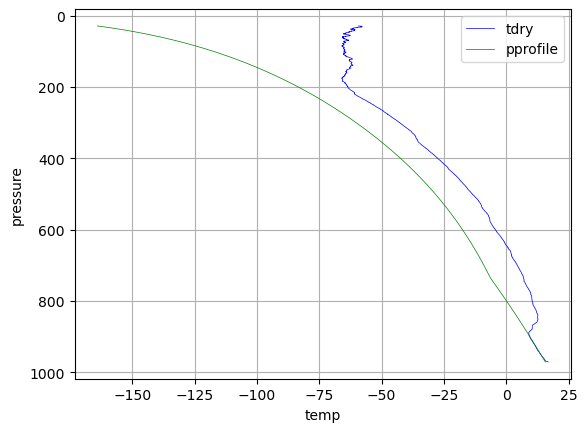

nan hectopascal 776.8151027329703 hectopascal


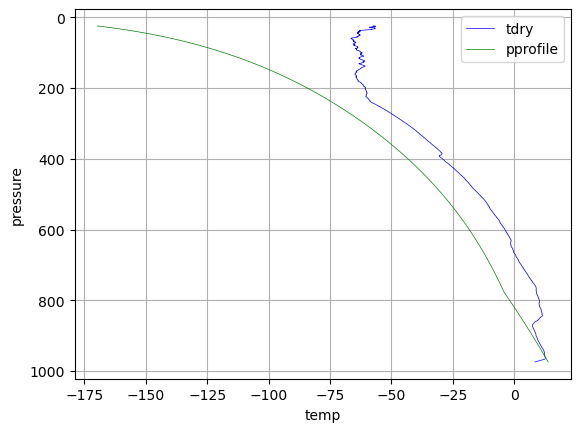

nan hectopascal 793.097949312451 hectopascal


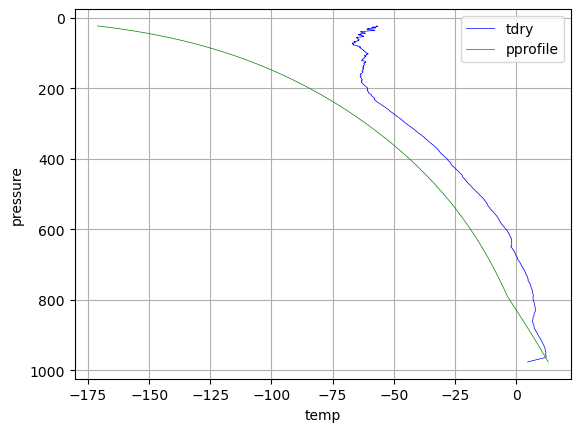

nan hectopascal 831.8724978698931 hectopascal


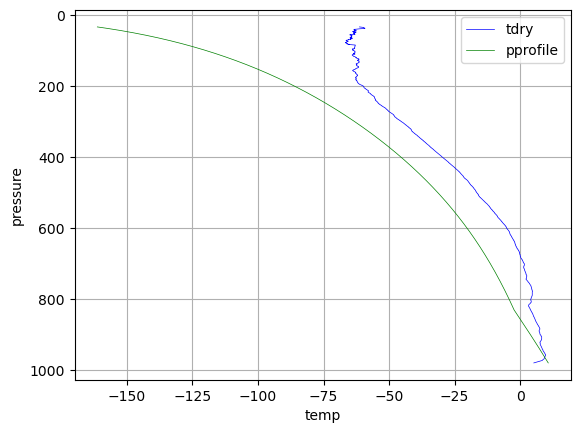

nan hectopascal 892.5799871618384 hectopascal


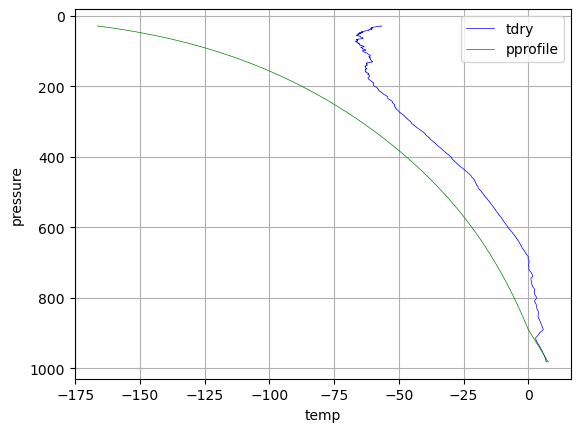

907.4931568263299 hectopascal 919.194181806086 hectopascal


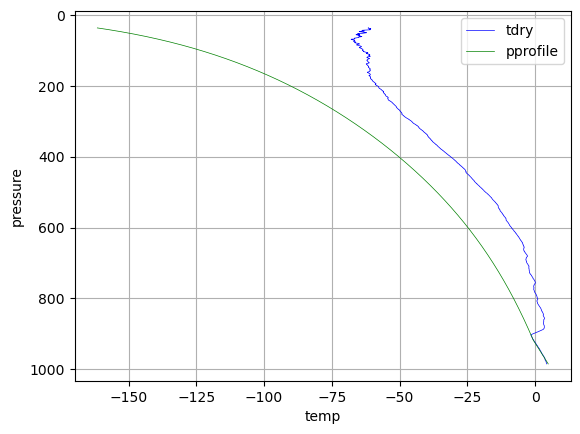

nan hectopascal 925.5564251042673 hectopascal


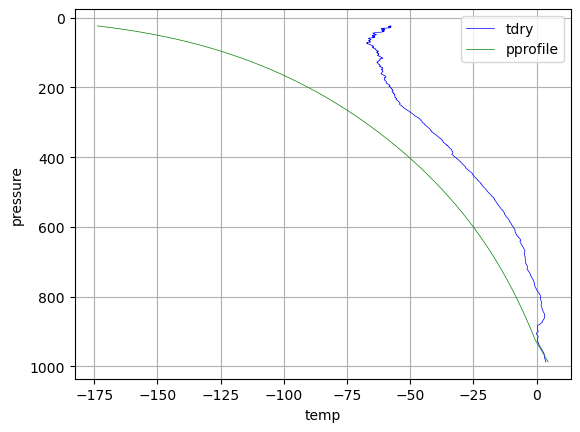

nan hectopascal 896.4402273147165 hectopascal


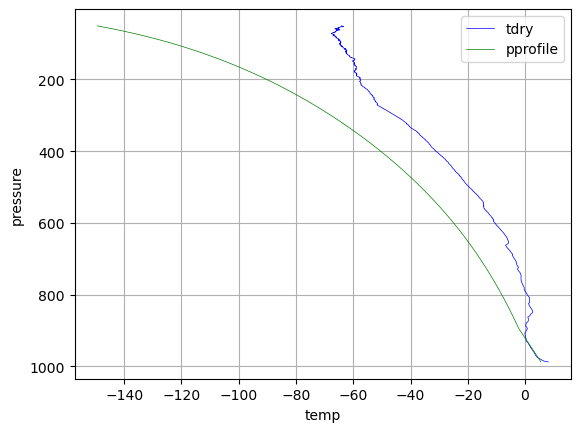

nan hectopascal 820.9558811742208 hectopascal


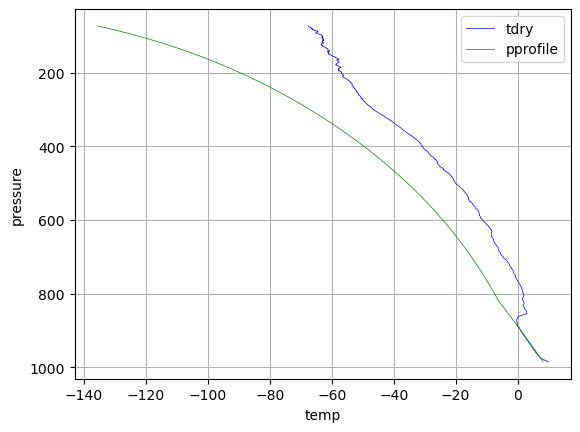

nan hectopascal 826.5439520448042 hectopascal


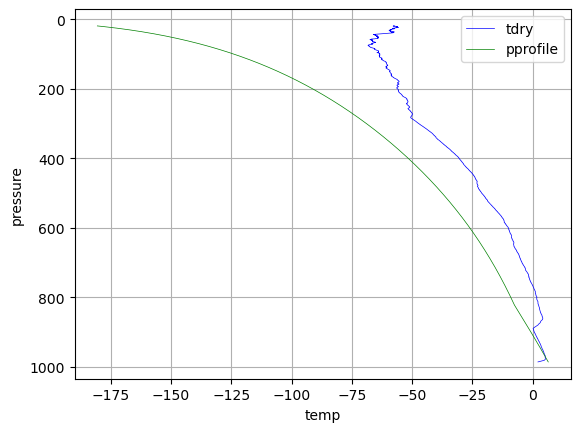

nan hectopascal 876.2793683407616 hectopascal


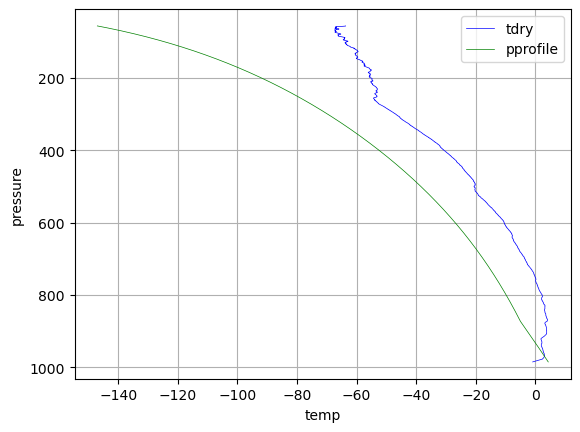

nan hectopascal 901.4823881378692 hectopascal


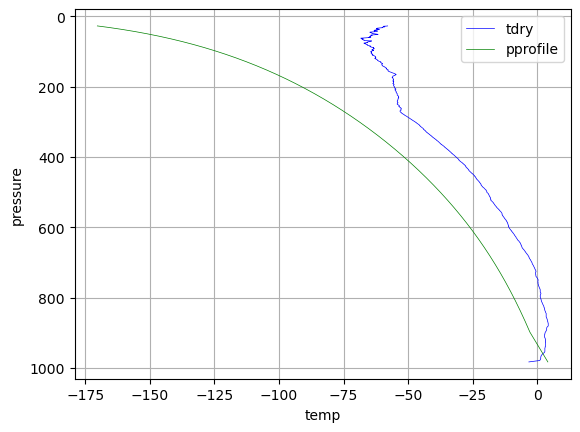

nan hectopascal 885.0190056808801 hectopascal


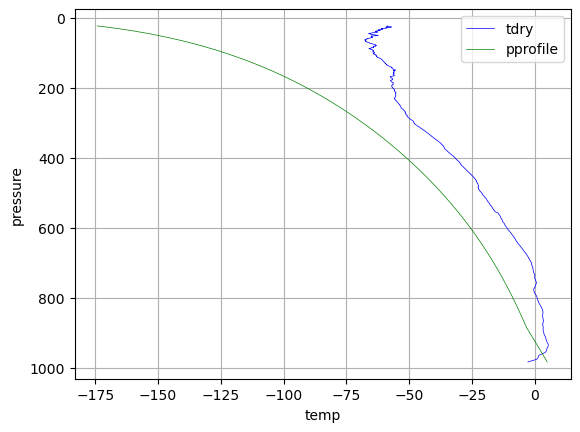

nan hectopascal 915.100069159544 hectopascal


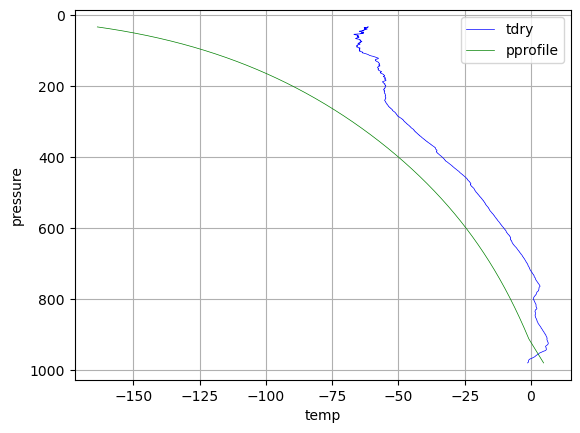

nan hectopascal 909.1353613359428 hectopascal


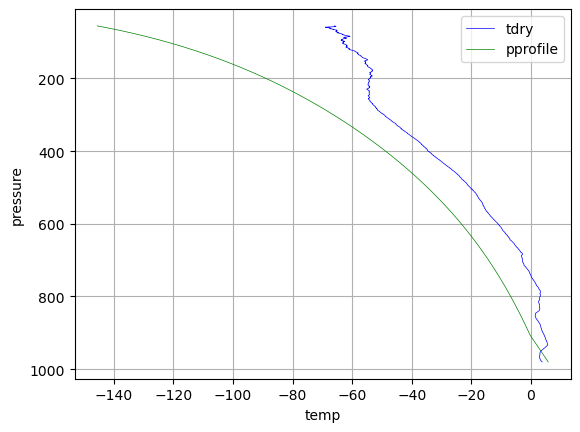

nan hectopascal 912.7929899135513 hectopascal


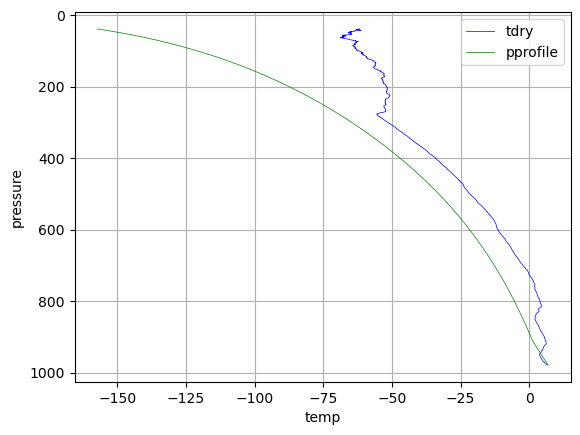

nan hectopascal 915.2221103000762 hectopascal


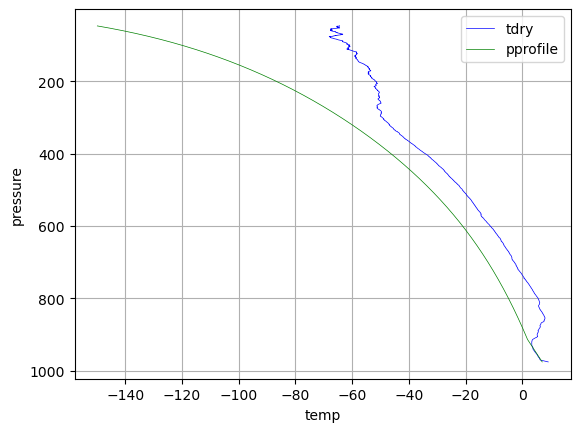

nan hectopascal 915.5254073436777 hectopascal


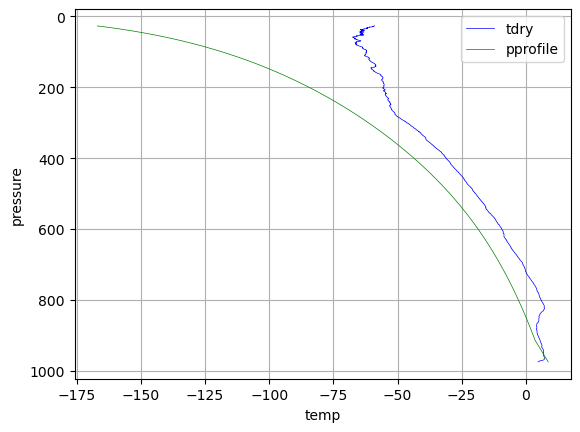

nan hectopascal 916.4733972534593 hectopascal


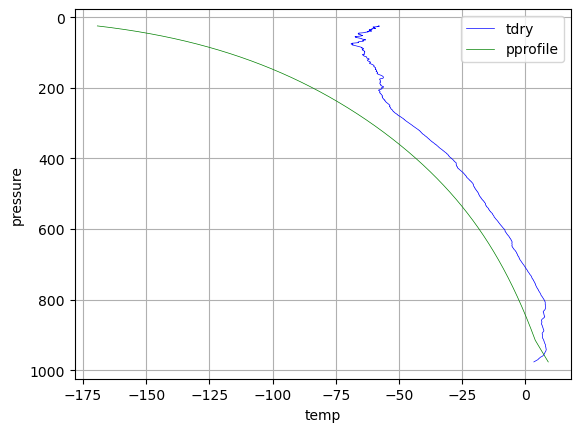

nan hectopascal 921.5244799324381 hectopascal


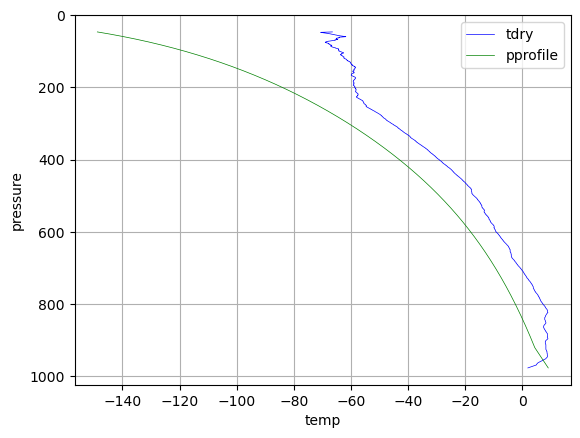

nan hectopascal 927.0910449506104 hectopascal


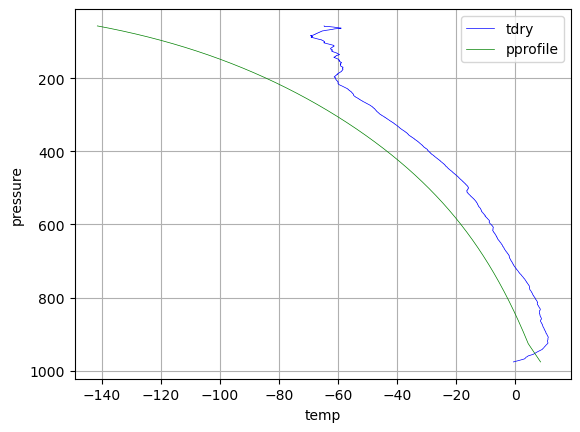

nan hectopascal 930.1099506646284 hectopascal


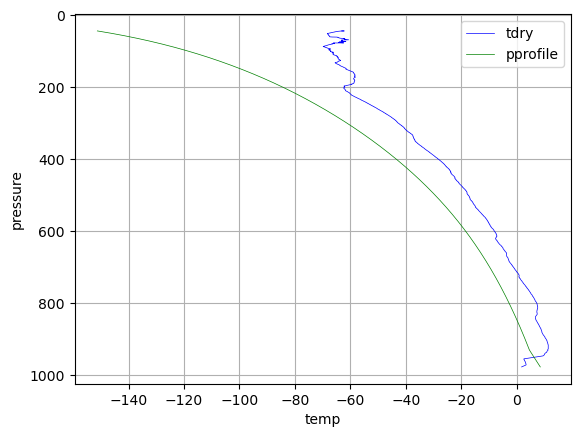

969.8691972659919 hectopascal 954.0250998240298 hectopascal


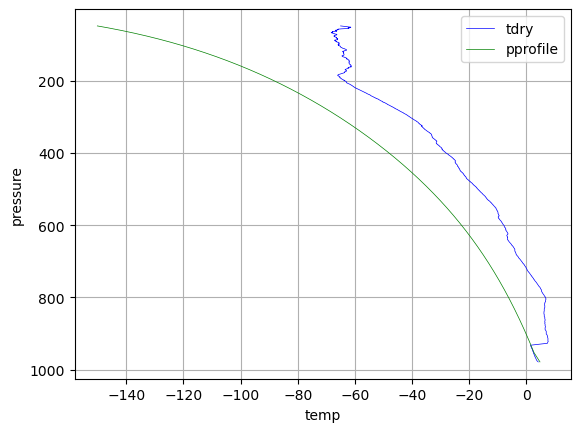

971.9825651179639 hectopascal 955.8568177391692 hectopascal


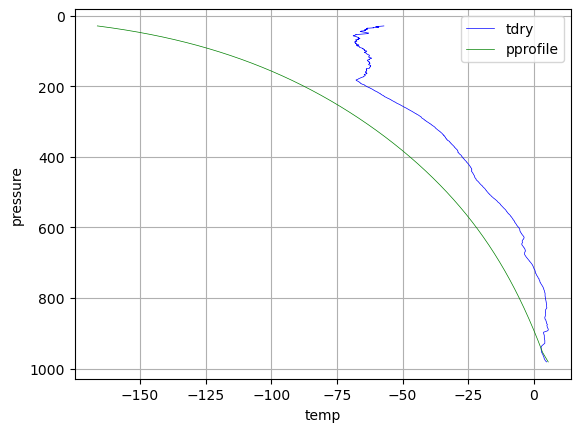

ValueError: all the input arrays must have same number of dimensions, but the array at index 0 has 1 dimension(s) and the array at index 1 has 2 dimension(s)

In [1038]:
#show yizhou: loop used for plotting LFC to debug NANs
#tdry and pprofile should have different pressures
#pprofile needs to be coordinated to mixed parcel
#could interpolate
lfc_calcs = []
for file in darmdata_cleaned:
    pres = file.variables['pres'][:].data * units.hPa
    tdry = file.variables['tdry'][:].data * units.degC
    dp = file.variables['dp'][:].data * units.degC 
    mp = mpcalc.mixed_parcel(pres, tdry, dp, depth=50 * units.hPa)
    #used mixed parcel to calculate parcel profile
    pprofile = mpcalc.parcel_profile(pres, mp[1], mp[2]).to('degC')
    #use parcel profile to calculate lfc
    lfc = mpcalc.lfc(pres, tdry, dp, parcel_temperature_profile=pprofile)
    lcl = mpcalc.lcl(mp[0], mp[1], mp[2])
    
    print(lfc[0],lcl[0])
    
    df = pd.DataFrame({
    'pressure': pres,
    'tdry': tdry,
    'pprofile': pprofile,
    'dp': dp})

    fig, ax = plt.subplots()
    ax.plot(df['tdry'], df['pressure'], color='blue', label='tdry', linewidth=.5)
    ax.plot(df['pprofile'], df['pressure'], color='green', label='pprofile', linewidth=.5)
    ax.set_xlabel('temperature')
    ax.set_ylabel('pressure')
    ax.invert_yaxis()
    ax.set_xlabel('temp')
    ax.set_ylabel('pressure')
    ax.legend()
    ax.grid(True)

    plt.show()

  

(<Quantity(802.358904, 'hectopascal')>, datetime.datetime(2000, 6, 15, 14, 57))
(<Quantity(872.631299, 'hectopascal')>, datetime.datetime(2000, 6, 16, 16, 51))
(<Quantity(808.152474, 'hectopascal')>, datetime.datetime(2000, 10, 3, 11, 30))
(<Quantity(906.924051, 'hectopascal')>, datetime.datetime(2000, 11, 24, 11, 28))
(<Quantity(891.457258, 'hectopascal')>, datetime.datetime(2000, 11, 24, 20, 31))
(<Quantity(859.973021, 'hectopascal')>, datetime.datetime(2000, 11, 24, 23, 28))
(<Quantity(853.681039, 'hectopascal')>, datetime.datetime(2000, 11, 25, 5, 30))
(<Quantity(792.236893, 'hectopascal')>, datetime.datetime(2000, 11, 26, 20, 29))
(<Quantity(806.268399, 'hectopascal')>, datetime.datetime(2000, 11, 26, 23, 29))
(<Quantity(841.780725, 'hectopascal')>, datetime.datetime(2000, 11, 27, 11, 40))


In [1261]:
#LFC CALC FROM 9/11
#dewpoints have -9999 values sometimes which blows up the graph
#in order to use all the data in the radiosonde profile, maybe need to interpolate parcel profile
#such that it has the same length as original pressure, temp and dewpoint within the lfc calculation
#(rather than using pres[trunc_index:])
#also need to figure out if i need to create unique values in temp, pressure, dewpoint arrays? 
for i in range(10000,10010):
    f = darmdata_cleaned[i]

    pres = f.variables["pres"].data*units.hPa
    temp = f.variables["tdry"].data*units.degC
    dp = f.variables["dp"].data*units.degC
    
    #trunc_index finds the index that is 25hpa above first observation
    trunc_index = find_index_for_mp_truncation(pres)

    mp = mpcalc.mixed_parcel(pres,temp,dp,depth=50*units.hPa,parcel_start_pressure=pres[trunc_index])

    #mixed parcel profile begins at 25hpa above ground and begins with mixed parcel temp & dp
    pp = mpcalc.parcel_profile(pres[trunc_index:],mp[1],mp[2]).to('degC')
    
    #need to figure out how to calculate lfc when mixed parcel profile starts 25hpa above it
    lfc = mpcalc.lfc(pres,temp,dp,parcel_temperature_profile=pp)
    
    lcl = mpcalc.lcl(mp[0], mp[1], mp[2])
    fig, ax = plt.subplots(figsize=(8, 8))
    skew = SkewT(fig, rotation=45)

    skew.plot(pres, temp, 'r', label='Temperature')
    
    skew.plot(pres, dp, 'g', label='Dew Point')
    skew.plot(pres[trunc_index:], pp, 'b', label='Mixed Parcel Profile')

    # Add dry adiabats and moist adiabats (optional)
    skew.plot_dry_adiabats()
    skew.plot_moist_adiabats()

    ax.set_xlabel("Temperature (°C)")
    ax.set_ylabel("Pressure (hPa)")

    # Add a legend
    plt.legend()

    # Show the Skew-T diagram
    plt.show()


950.7000122070312 hectopascal
[975.7999877929688 974.5999755859375 973.2999877929688 ... 17.799999237060547 17.799999237060547 17.799999237060547] hectopascal
947.7999877929688 hectopascal
[973.5999755859375 972.2000122070312 970.9000244140625 ... 23.700000762939453 23.600000381469727 23.600000381469727] hectopascal
948.5 hectopascal
[973.5999755859375 972.7999877929688 972.0 ... 63.20000076293945 62.900001525878906 62.5] hectopascal
945.2999877929688 hectopascal
[970.9000244140625 969.4000244140625 968.0 ... 16.0 16.0 15.899999618530273] hectopascal
945.7999877929688 hectopascal
[971.4000244140625 970.2000122070312 968.7999877929688 ... 14.100000381469727 14.100000381469727 14.0] hectopascal
942.2000122070312 hectopascal
[968.0 966.7000122070312 965.7000122070312 ... 24.5 24.5 24.399999618530273] hectopascal
948.0 hectopascal
[973.2999877929688 972.2000122070312 971.2999877929688 ... 12.0 12.0 12.0] hectopascal
949.5999755859375 hectopascal
[974.7999877929688 973.7000122070312 972.400

In [1117]:
#
def find_index_for_mp_truncation(p):
    target_difference = 25*units.hPa  # 25 hPa
    for i in range(len(p)):
        if p[0]-p[i] >= target_difference:
            return i
    return None  # Return None if no such index is found

In [1197]:
pp

Magnitude,[29.30000000000001 28.61221951574845 25.222147384020218 23.460975347242083 21.58359279560426 19.57260398482498 17.406361852039822 15.057486153977663 12.490648661013665 9.659253895822644 6.500234908917548 2.9256036460892005 -1.1917284638130354 -6.04257883658039 -11.924975168790468 -19.317653604943246 -28.976724644755308 -41.94444385189527 -50.011730762116485 -59.3093624797491 -70.02760604264736 -82.53084922667225 -94.29667129619958 -100.99074330775701 -108.4082993349599 -116.77024488747216 -126.42910221755437 -138.0064958359133 -144.8661588565159 -152.7896702869799]
Units,degree_Celsius


In [1199]:
mpp

Magnitude,[28.75003298451321 28.063503141955266 23.681340116054912 19.13119094778085 15.156397586031233 12.8888432529331 10.42556941602038 7.7289069044980465 4.749721474148316 1.4226474734745693 -2.3410155628252483 -6.663872260098856 -11.717555547690381 -17.7417766690715 -25.059732124366036 -34.067803882196785 -45.17977429743175 -58.804487093950286 -66.73632259649347 -75.58916690582154 -85.60243834648176 -97.18265669598088 -108.05081988232718 -114.23096011462374 -121.07833200338806 -128.79723994464618 -137.7132549614292 -148.40024189070493 -154.7323372574132 -162.04645848227233]
Units,degree_Celsius


In [1216]:
print(len(mpp1), len(mpp2))

30 30


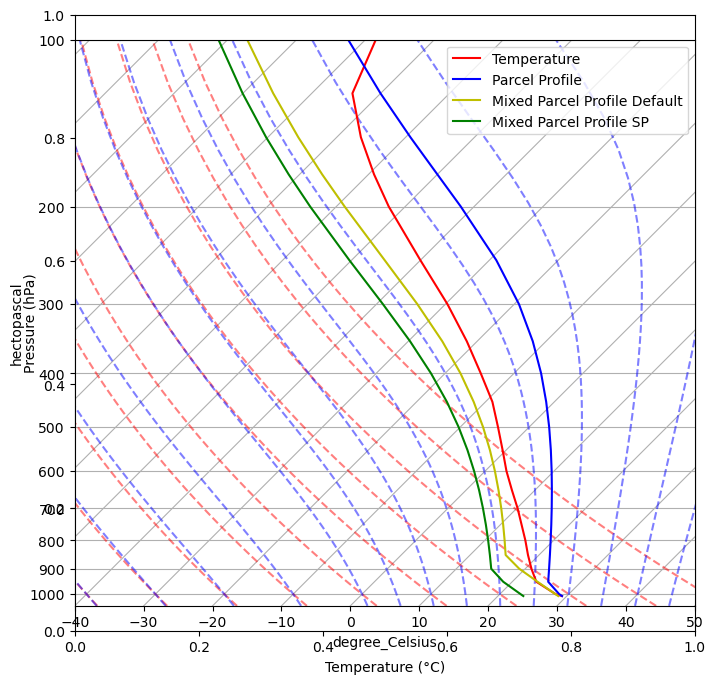

968.1717565943435 hectopascal nan hectopascal


In [1212]:
#components i can change:
#within mixed_parcel: parcel_start_pressure 
#within parcel profile: starting pressure value
#within lfc calculation: starting pressure, starting temp, starting dewpoint

p = [1008., 1000., 950., 900., 850., 800., 750., 700., 650., 600.,
     550., 500., 450., 400., 350., 300., 250., 200.,
     175., 150., 125., 100., 80., 70., 60., 50.,
     40., 30., 25., 20.] * units.hPa
# temperature
T = [29.3, 28.1, 23.5, 20.9, 18.4, 15.9, 13.1, 10.1, 6.7, 3.1,
     -0.5, -4.5, -9.0, -14.8, -21.5, -29.7, -40.0, -52.4,
     -59.2, -66.5, -74.1, -78.5, -76.0, -71.6, -66.7, -61.3,
     -56.3, -51.7, -50.7, -47.5] * units.degC
# relative humidity
rh = [.85, .65, .36, .39, .82, .72, .75, .86, .65, .22, .52,
      .66, .64, .20, .05, .75, .76, .45, .25, .48, .76, .88,
      .56, .88, .39, .67, .15, .04, .94, .35] * units.dimensionless


Td = mpcalc.dewpoint_from_relative_humidity(T, rh)

mp1 = mpcalc.mixed_parcel(p,T,Td,depth=50*units.hPa)
mp = mpcalc.mixed_parcel(p,T,Td,depth=50*units.hPa,parcel_start_pressure=950*units.hPa)

mpp1 = mpcalc.parcel_profile(p,mp1[1],mp1[2]).to('degC')
mpp2 = mpcalc.parcel_profile(p,mp2[1],mp2[2]).to('degC')

pp = mpcalc.parcel_profile(p,T[0],Td[0]).to('degC')

lfc = mpcalc.lfc(p, T, Td,parcel_temperature_profile=mpp2)

lcl = mpcalc.lcl(p[0], T[0], Td[0])

fig, ax = plt.subplots(figsize=(8, 8))
skew = SkewT(fig, rotation=45)

skew.plot(p, T, 'r', label='Temperature')
#skew.plot(p, Td, 'g', label='Dew Point')
skew.plot(p, pp, 'b', label='Parcel Profile')
skew.plot(p, mpp1, 'y', label='Mixed Parcel Profile Default')
skew.plot(p, mpp2, 'g', label='Mixed Parcel Profile SP')

# Add dry adiabats and moist adiabats (optional)
skew.plot_dry_adiabats()
skew.plot_moist_adiabats()

ax.set_xlabel("Temperature (°C)")
ax.set_ylabel("Pressure (hPa)")

# Add a legend
plt.legend()

# Show the Skew-T diagram
plt.show()

print(lcl[0],lfc[0])


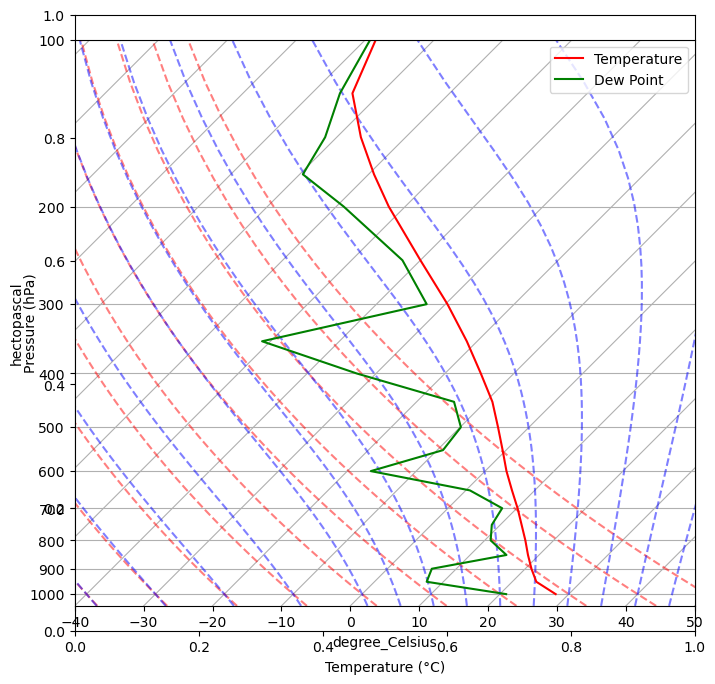

In [1157]:
#order of operations:
#calculate mixed parcel for lowest 50hpa and choose parcel_start_pressure to be 25hpa from first observation
#calculate parcel profile by truncating pressure array to be 25hpa above first obs
#calculate lfc by truncating temperature and dewpoint in same way

p = [1000., 950., 900., 850., 800., 750., 700., 650., 600.,
     550., 500., 450., 400., 350., 300., 250., 200.,
     175., 150., 125., 100., 80., 70., 60., 50.,
     40., 30., 25., 20.] * units.hPa

# temperature
T = [28.1, 23.5, 20.9, 18.4, 15.9, 13.1, 10.1, 6.7, 3.1,
     -0.5, -4.5, -9.0, -14.8, -21.5, -29.7, -40.0, -52.4,
     -59.2, -66.5, -74.1, -78.5, -76.0, -71.6, -66.7, -61.3,
     -56.3, -51.7, -50.7, -47.5] * units.degC
# relative humidity
rh = [.65, .36, .39, .82, .72, .75, .86, .65, .22, .52,
      .66, .64, .20, .05, .75, .76, .45, .25, .48, .76, .88,
      .56, .88, .39, .67, .15, .04, .94, .35] * units.dimensionless
# calculate dewpoint
Td = mpcalc.dewpoint_from_relative_humidity(T, rh)

mp = mpcalc.mixed_parcel(p, T, Td, depth=50*units.hPa, parcel_start_pressure=950*units.hPa)

pp = mpcalc.parcel_profile(p[1:], mp[1], mp[2]).to('degC')

#pp = mpcalc.parcel_profile(p, T[0], Td[0]).to('degC')

lfc = mpcalc.lfc(p[1:], T[1:], Td[1:], parcel_temperature_profile=pp)

fig, ax = plt.subplots(figsize=(8, 8))
skew = SkewT(fig, rotation=45)

skew.plot(p, T, 'r', label='Temperature')
skew.plot(p, Td, 'g', label='Dew Point')
# Add dry adiabats and moist adiabats (optional)
skew.plot_dry_adiabats()
skew.plot_moist_adiabats()

ax.set_xlabel("Temperature (°C)")
ax.set_ylabel("Pressure (hPa)")

# Add a legend
plt.legend()

# Show the Skew-T diagram
plt.show()

# lcl = mpcalc.lcl(mp[0], mp[1], mp[2])

# df = pd.DataFrame({
#     'pressure': p[1:],
#     'tdry': T[1:],
#     'pprofile': pp,
#     'dp': Td[1:]
# })

# fig, ax = plt.subplots()

# # Plot Column2 on its own line
# ax.plot(df['tdry'], df['pressure'], color='blue', label='tdry', linewidth=.5)

# ax.plot(df['dp'], df['pressure'], color='red', label='dp', linewidth=.5)

# # Plot Column3 on its own line
# ax.plot(df['pprofile'], df['pressure'], color='green', label='pprofile', linewidth=.5)

# # Set labels and legend
# ax.set_xlabel('temperature')
# ax.set_ylabel('pressure')

# # Invert y-axis for Column1
# ax.invert_yaxis()

# # Set labels and legend
# ax.set_xlabel('temp')
# ax.set_ylabel('pressure')
# ax.legend()
# ax.grid(True)

# # Show the plot
# print(lfc,lcl)
# plt.show()

In [1160]:
T

Magnitude,[28.1 23.5 20.9 18.4 15.9 13.1 10.1 6.7 3.1 -0.5 -4.5 -9.0 -14.8 -21.5 -29.7 -40.0 -52.4 -59.2 -66.5 -74.1 -78.5 -76.0 -71.6 -66.7 -61.3 -56.3 -51.7 -50.7 -47.5]
Units,degree_Celsius


In [1159]:
p

Magnitude,[1000.0 950.0 900.0 850.0 800.0 750.0 700.0 650.0 600.0 550.0 500.0 450.0 400.0 350.0 300.0 250.0 200.0 175.0 150.0 125.0 100.0 80.0 70.0 60.0 50.0 40.0 30.0 25.0 20.0]
Units,hectopascal


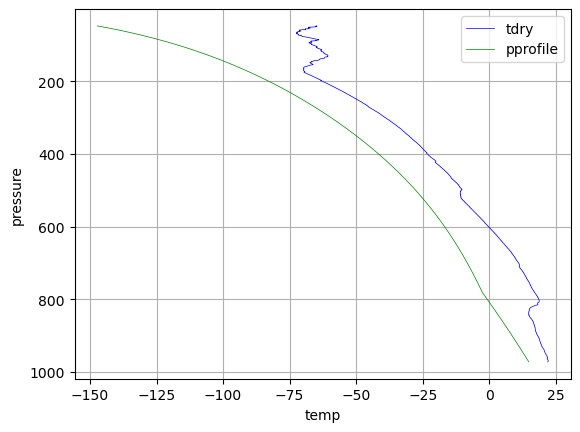

In [647]:
# Plot the data
fig, ax = plt.subplots()

# Plot Column2 on its own line
ax.plot(df['tdry'], df['pressure'], color='blue', label='tdry', linewidth=.5)

# Create a second y-axis for Column1 (inverted) and plot it on its own line
# ax2 = ax1.twinx()
# ax2.plot(df['Column1'], df['Column1'][::-1], color='red', label='Column1 (Inverted)', marker='s')

# Plot Column3 on its own line
ax.plot(df['pprofile'], df['pressure'], color='green', label='pprofile', linewidth=.5)

# Set labels and legend
ax.set_xlabel('temperature')
ax.set_ylabel('pressure')

# Invert y-axis for Column1
ax.invert_yaxis()

# Set labels and legend
ax.set_xlabel('temp')
ax.set_ylabel('pressure')
ax.legend()
ax.grid(True)

# Show the plot
plt.show()

In [515]:
#loop shows how each file has duplicate pressure values, which may introduce error in LFC calculation
for i in darmdata_cleaned:
    pres = i.variables['pres'][:].data * units.hPa
    pressure = pres.magnitude
    unique = set(pressure)
    print(len(pressure), len(unique))

3081 2974
3323 2955
3303 2927
2767 2449
2283 2241
2690 2450
2750 2469
3232 2867
2589 2440
3363 2964
3038 2695
2761 2441
3033 2594
2613 2400
3455 3076
3470 2962
2562 2308
2836 2550
2807 2466
2551 2354
2558 2434
2819 2545
2593 2424
2253 2235
3063 2668
2758 2510
2366 2343
2730 2549
2553 2380
2673 2501
2767 2569
2800 2552
2272 2228
2723 2512
2498 2422
3049 2661
2980 2630
2844 2572
1884 1883
3099 2720
2872 2567
2655 2386
2168 2129
1642 1642
1292 1292
2683 2459
1974 1973
1812 1808
1992 1985
2512 2411
2220 2191
2099 2094
2827 2699
2712 2556
2915 2715
2954 2659
2769 2572
2625 2436
2975 2688
2287 2241
2693 2531
2401 2317
1975 1973
2331 2261
2485 2417
2159 2141
2055 2050
2541 2371
2587 2399
2697 2483
2431 2341
1672 1668
2661 2454
2438 2317
2245 2197
2658 2454
2493 2322
2648 2435
2494 2318
2430 2342
2430 2294
1957 1955
2442 2319
2276 2201
2793 2620
2890 2584
1088 1088
2616 2411
2603 2526
2318 2268
2871 2682
2861 2649
2913 2599
3138 2771
2592 2435
2732 2517
2450 2341
2719 2449
2201 2167
1928 1921


7475 7465
6276 6276
6589 6588
7638 7626
5919 5919
10285 9463
6198 6198
6898 6892
6227 6224
5930 5930
2471 2471
4863 4863
6984 6982
5982 5982
6346 6343
6211 6211
6145 6144
5821 5820
8680 8556
4928 4928
5282 5282
6065 6065
5689 5688
5381 5381
5201 5201
5674 5674
5480 5480
4362 4362
5120 5120
4661 4661
4960 4960
5044 5044
5090 5090
5239 5239
5286 5286
4616 4616
6186 6184
5203 5203
5233 5233
5144 5144
4579 4579
5573 5573
4105 4105
5405 5405
5206 5206
5082 5082
4922 4922
4485 4485
4916 4916
5076 5076
5384 5384
5031 5031
5022 5022
4388 4388
4687 4687
4943 4943
5042 5042
4983 4983
5237 5237
4321 4321
4939 4939
4974 4974
5275 5275
4999 4999
5085 5085
5118 5118
4655 4655
5008 5008
5055 5055
6271 6269
4906 4906
5109 5109
5170 5170
5097 5097
5281 5281
5852 5830
371 371
5173 5173
5133 5133
5052 5052
5020 5020
5148 5148
5455 5455
5261 5261
4298 4298
4706 4706
4764 4764
4702 4702
5202 5202
5024 5024
4929 4929
5303 5303
4339 4339
5238 5238
4924 4924
4963 4963
5108 5108
5084 5084
5117 5117
5072 5072
5

In [494]:
p = [1008., 1000., 950., 900., 850., 800., 750., 700., 650., 600.,
     550., 500., 450., 400., 350., 300., 250., 200.,
     175., 150., 125., 100., 80., 70., 60., 50.,
     40., 30., 25., 20.] * units.hPa
# temperature
T = [29.3, 28.1, 23.5, 20.9, 18.4, 15.9, 13.1, 10.1, 6.7, 3.1,
     -0.5, -4.5, -9.0, -14.8, -21.5, -29.7, -40.0, -52.4,
     -59.2, -66.5, -74.1, -78.5, -76.0, -71.6, -66.7, -61.3,
     -56.3, -51.7, -50.7, -47.5] * units.degC
# relative humidity
rh = [.85, .65, .36, .39, .82, .72, .75, .86, .65, .22, .52,
      .66, .64, .20, .05, .75, .76, .45, .25, .48, .76, .88,
      .56, .88, .39, .67, .15, .04, .94, .35] * units.dimensionless
# calculate dewpoint
Td = mpcalc.dewpoint_from_relative_humidity(T, rh)
# computer parcel temperature

print(type(p), type(T[0]), type(Td[0]))
#mpcalc.parcel_profile(p, T[0], Td[0]).to('degC')
#pprofile = mpcalc.parcel_profile(pres.squeeze(), T[0].squeeze(), mp[2].squeeze()).to('degC')

<class 'pint.util.Quantity'> <class 'pint.util.Quantity'> <class 'pint.util.Quantity'>


In [459]:
nans = []
for i in dp:
    t = i.magnitude
    if np.isnan(t):
        nans.append(t)

In [429]:
mp_temps = []
for i in mps:
    mp_temp = i[2].magnitude
    mp_temps.append(mp_temp)

In [522]:
# mp temps contains all mixed_parcel calculations, 45 are NANs
# convert the list to a NumPy array to use `np.isnan()`
float_array = np.array(mp_temps)

# Count the number of NaNs using np.isnan() and np.sum()
nan_count = np.sum(np.isnan(float_array))

nan_count

45

In [405]:
p = [1008., 1000., 950., 900., 850., 800., 750., 700., 650., 600.,
     550., 500., 450., 400., 350., 300., 250., 200.,
     175., 150., 125., 100., 80., 70., 60., 50.,
     40., 30., 25., 20.] * units.hPa
# temperature
T = [29.3, 28.1, 23.5, 20.9, 18.4, 15.9, 13.1, 10.1, 6.7, 3.1,
     -0.5, -4.5, -9.0, -14.8, -21.5, -29.7, -40.0, -52.4,
     -59.2, -66.5, -74.1, -78.5, -76.0, -71.6, -66.7, -61.3,
     -56.3, -51.7, -50.7, -47.5] * units.degC
# relative humidity
rh = [.85, .65, .36, .39, .82, .72, .75, .86, .65, .22, .52,
      .66, .64, .20, .05, .75, .76, .45, .25, .48, .76, .88,
      .56, .88, .39, .67, .15, .04, .94, .35] * units.dimensionless
# calculate dewpoint
#Td = dewpoint_from_relative_humidity(T, rh)
# computer parcel temperature
#parcel_profile(p, T[0], Td[0]).to('degC')

print(T[0])

29.3 degree_Celsius


In [409]:
print(mp)

(<Quantity(978.0, 'hectopascal')>, <Quantity(5.15799165, 'degree_Celsius')>, <Quantity(nan, 'degree_Celsius')>)


In [ ]:
#example of how to not do append loops
path = "../../data/rong1/climate_fu/Data/DOEARM/sgp/sondewnpn"
file_list = sorted(glob.glob(path + "/*.cdf"))
tdry = np.zeros((31000*31000))*np.nan
count = 0
for file in file_list: 
    ds = xr.open_dataset(file)
    tdry_temp = ds.variables['tdry'][:]
    z = len(tdry_temp)
    tdry[count:count + z] = tdry_temp 
    count = count + z

In [ ]:
#draft, debugging parcel_profile. num bugs is only about 60, compared to 30k successes
pprofile_test = []
num_bugs = 0
num_norms = 0
for file in darmdata_cleaned:
    pres = file.variables['pres'][:].data * units.hPa
    tdry = file.variables['tdry'][:].data * units.degC
    dp = file.variables['dp'][:].data * units.degC
    mp = mpcalc.mixed_parcel(pres, tdry, dp, depth= 50* units.hPa)
#     print(pres.dimensionality, mp[1].dimensionality)
    try: 
        pprofile = mpcalc.parcel_profile(pres, mp[1], mp[2]).to('degC')
        pprofile_test.append(pprofile)
        num_norms += 1
    except ValueError:
        num_bugs+=1
        print(str(num_bugs/num_norms))
        continue

In [ ]:
#DEPRECATED
#surface LCL calculation -- takes as input surface pressure, temperature and dewpoint, assuming here that the first values
sfc_lcl_calcs = []
for file in darmdata_cleaned:
    pres = file.variables['pres'][:].data[0] * units.hPa
    tdry = file.variables['tdry'][:].data[0] * units.degC
    dp = file.variables['dp'][:].data[0] * units.degC
    #grabbing 'time' for those that are np.datetime64s
    date = file.coords['time'].data[0]
    #if 'time' is not a datetime, grabbing base_time instead
    base_date = file.variables['base_time'].data
    lcl = mpcalc.lcl(pres, tdry, dp)
    if isinstance(date, np.datetime64):
        lcl_tuple = (lcl[0], date)
        sfc_lcl_calcs.append(lcl_tuple)
    else: 
        lcl_tuple = (lcl[0], base_date)
        sfc_lcl_calcs.append(lcl_tuple)

In [ ]:
#DEPRECATED
#DIURNAL CYCLE 2013-2019 
# Convert the index to a pandas datetime index
lcl_df.index = pd.to_datetime(lcl_df.index)

# Filter for a specific year range
lcl_values_2013_2019 = lcl_df[(lcl_df.index.year >= 2013) & (lcl_df.index.year <= 2019)]
lcl_values_2013_2019 = lcl_values_2013_2019["Pressure"]

lcl_values_1994_2012 = lcl_df[(lcl_df.index.year >= 1994) & (lcl_df.index.year <= 2012)]
lcl_values_1994_2012 = lcl_values_1994_2012["Pressure"].dropna()

#loop to gather hours for bins in numpy digitize
hrs_to_bin_2013_2019 = []

for i in launch_time_ranges:
    start_balloon_time = i[0]
    t = pd.Timestamp(start_balloon_time)
    if 2013 <= t.year <= 2019:
        hrs_to_bin_2013_2019.append(np.mod(t.hour-5,24))

# Define the start and end time for binning
start_time_bin = np.min(hrs_to_bin_2013_2019)
end_time_bin = np.max(hrs_to_bin_2013_2019)

# Generate the bin edges with a spacing of 3
bin_edges_2013_2019 = np.arange(start_time_bin, end_time_bin + 1, 3)

# Use numpy.digitize() to assign each date and time value to a bin
indices_2013_2019 = np.digitize(hrs_to_bin_2013_2019, bin_edges_2013_2019)-1

# Calculate the average pressure for each bin
avg_lcl_values_2013_2019 = [np.nanmean(lcl_values_2013_2019[indices_2013_2019 == i]) for i in range(len(bin_edges_2013_2019))]

#plot 2013-2019 LCL Diurnal Cycle

avg_lcl_value_1994_2012 = np.mean(lcl_values_1994_2012)

plt.plot(bin_edges_2013_2019, avg_lcl_values_2013_2019)

# Invert the y-axis
plt.gca().invert_yaxis()

# Add a title
plt.title("LCL Diurnal Cycle 2013-2019")

# Add axis titles
plt.xlabel("Hour Of Day")
plt.ylabel("Pressure (HPA)")

# Add a single value at (3, 6) on the plot
plt.scatter(19, avg_lcl_value_1994_2012, color='red', marker='o')

# Display the plot
plt.grid(True) 
plt.show()

In [ ]:
# Perform t-test on comparison of LCL Diurnal Cycle 2013-2019 and 1994-2012
t_stat, p_value = stats.ttest_ind(lcl_values_2013_2019[indices_2013_2019==6].values, lcl_values_1994_2012.values)
print(t_stat, p_value)

In [ ]:
#DEPRECATED
#FULL DIURNAL CYCLE OF LCLS 1994-2019
#lcls to bin into 3hr time periods
lcl_values_to_bin = lcl_df["Pressure"]

#loop to gather hours for bins in numpy digitize
hours_to_bin = []
for i in launch_time_ranges:
    start_balloon_time = i[0]
    t = pd.Timestamp(start_balloon_time)
    hours_to_bin.append(np.mod(t.hour-5, 24))
    
# Define the start and end time for binning
start_time = np.min(hours_to_bin)
end_time = np.max(hours_to_bin)

# Generate the bin edges with a spacing of 3
bin_edges = np.arange(start_time, end_time + 1, 3)

# Use numpy.digitize() to assign each date and time value to a bin
indices = np.digitize(hours_to_bin, bin_edges)

# Calculate the average pressure for each bin
avg_pressure_values = [np.mean(lcl_values_to_bin[indices == i]) for i in range(len(bin_edges))]

#plot average diurnal cycle of LCL heights over the full 26 years
plt.plot(bin_edges, avg_pressure_values)

# Invert the y-axis
plt.gca().invert_yaxis()

# Add a title
plt.title("LCL Diurnal Cycle 1994-2019")

# Add axis titles
plt.xlabel("Hour Of Day")
plt.ylabel("Pressure (HPA)")

# Display the plot
plt.grid(True) 
plt.show()

In [ ]:
for i in range(1,1000):
    
    pres = darmdata_cleaned[i].variables['pres'][:].data * units.hPa
    tdry = darmdata_cleaned[i].variables['tdry'][:].data * units.degC
    dp = darmdata_cleaned[i].variables['dp'][:].data * units.degC
    mp = mpcalc.mixed_parcel(pres, tdry, dp, depth=50 * units.hPa)
    lcl = mpcalc.lcl(mp[0], mp[1], mp[2])
    
    p_lcl = lcl[0].magnitude
    tb = convert_c_to_k(tdry[0].magnitude)
    pb = pres[0].magnitude
    
    h_lcl = convert_pres_to_height(p_lcl,0,tb,pb)
    td_dp = 125*(mp[1]-mp[2]).magnitude
    
    check = td_dp/h_lcl
    print(td_dp, h_lcl, check)

In [713]:
#DEPRECATED: chose base_time or time variable before, now using only base_time in lcl calculation
#mixed layer LCL calculation -- takes as input surface pressure, temperature and dewpoint, assuming here that the first values
darmdata_subset = darmdata_cleaned[0:1000]
mp_lcl_calcs_test = []
for file in darmdata_subset:
    pres = file.variables['pres'][:].data * units.hPa
    tdry = file.variables['tdry'][:].data * units.degC
    dp = file.variables['dp'][:].data * units.degC
    #grabbing 'time' for those that are np.datetime64s
    date = file.coords['time'].data[0]
    #if 'time' is not a datetime, grabbing base_time instead
    base_date = file.variables['base_time'].data
    mp = mpcalc.mixed_parcel(pres, tdry, dp, depth=50 * units.hPa)
    lcl = mpcalc.lcl(mp[0], mp[1], mp[2])
    if isinstance(date, np.datetime64):
        lcl_tuple = (lcl[0], date)
        mp_lcl_calcs_test.append(lcl_tuple)
    else: 
        lcl_tuple = (lcl[0], base_date)
        mp_lcl_calcs_test.append(lcl_tuple)
    print(lcl_tuple)

(<Quantity(802.358904, 'hectopascal')>, numpy.datetime64('2000-06-15T14:57:00.000000000'))
(<Quantity(872.631299, 'hectopascal')>, numpy.datetime64('2000-06-16T16:51:00.000000000'))
(<Quantity(808.152474, 'hectopascal')>, numpy.datetime64('2000-10-03T11:30:00.000000000'))
(<Quantity(906.924051, 'hectopascal')>, numpy.datetime64('2000-11-24T11:28:00.000000000'))
(<Quantity(891.457258, 'hectopascal')>, numpy.datetime64('2000-11-24T20:31:00.000000000'))
(<Quantity(859.973021, 'hectopascal')>, numpy.datetime64('2000-11-24T23:28:00.000000000'))
(<Quantity(853.681039, 'hectopascal')>, numpy.datetime64('2000-11-25T05:30:00.000000000'))
(<Quantity(792.236893, 'hectopascal')>, numpy.datetime64('2000-11-26T20:29:00.000000000'))
(<Quantity(806.268399, 'hectopascal')>, numpy.datetime64('2000-11-26T23:29:00.000000000'))
(<Quantity(841.780725, 'hectopascal')>, numpy.datetime64('2000-11-27T11:40:00.000000000'))
(<Quantity(828.214466, 'hectopascal')>, numpy.datetime64('2000-11-27T14:31:00.000000000'))

(<Quantity(776.815103, 'hectopascal')>, numpy.datetime64('2000-12-08T00:13:00.000000000'))
(<Quantity(793.097949, 'hectopascal')>, numpy.datetime64('2000-12-08T02:28:00.000000000'))
(<Quantity(831.872498, 'hectopascal')>, numpy.datetime64('2000-12-08T05:28:00.000000000'))
(<Quantity(892.579987, 'hectopascal')>, numpy.datetime64('2000-12-08T08:28:00.000000000'))
(<Quantity(919.194182, 'hectopascal')>, numpy.datetime64('2000-12-08T11:29:00.000000000'))
(<Quantity(925.556425, 'hectopascal')>, numpy.datetime64('2000-12-08T14:29:00.000000000'))
(<Quantity(896.440227, 'hectopascal')>, numpy.datetime64('2000-12-08T17:30:00.000000000'))
(<Quantity(820.955881, 'hectopascal')>, numpy.datetime64('2000-12-08T20:30:00.000000000'))
(<Quantity(826.543952, 'hectopascal')>, numpy.datetime64('2000-12-09T00:28:00.000000000'))
(<Quantity(876.279368, 'hectopascal')>, numpy.datetime64('2000-12-09T03:38:00.000000000'))
(<Quantity(901.482388, 'hectopascal')>, numpy.datetime64('2000-12-09T06:28:00.000000000'))

(<Quantity(914.850518, 'hectopascal')>, numpy.datetime64('2000-12-28T11:26:00.000000000'))
(<Quantity(908.882772, 'hectopascal')>, numpy.datetime64('2000-12-28T20:30:00.000000000'))
(<Quantity(912.578329, 'hectopascal')>, numpy.datetime64('2000-12-29T11:27:00.000000000'))
(<Quantity(881.771717, 'hectopascal')>, numpy.datetime64('2000-12-29T20:30:00.000000000'))
(<Quantity(952.430967, 'hectopascal')>, numpy.datetime64('2001-01-02T11:26:00.000000000'))
(<Quantity(934.18001, 'hectopascal')>, numpy.datetime64('2001-01-02T20:30:00.000000000'))
(<Quantity(862.331577, 'hectopascal')>, numpy.datetime64('2001-01-03T20:30:00.000000000'))
(<Quantity(840.806465, 'hectopascal')>, numpy.datetime64('2001-01-03T23:30:00.000000000'))
(<Quantity(825.6291, 'hectopascal')>, numpy.datetime64('2001-01-04T05:31:00.000000000'))
(<Quantity(836.389379, 'hectopascal')>, numpy.datetime64('2001-01-04T11:35:00.000000000'))
(<Quantity(790.896936, 'hectopascal')>, numpy.datetime64('2001-01-04T20:30:00.000000000'))
(<

(<Quantity(871.643812, 'hectopascal')>, numpy.datetime64('2001-02-02T11:29:00.000000000'))
(<Quantity(861.787523, 'hectopascal')>, numpy.datetime64('2001-02-02T20:31:00.000000000'))
(<Quantity(867.266235, 'hectopascal')>, numpy.datetime64('2001-02-02T23:30:00.000000000'))
(<Quantity(834.747445, 'hectopascal')>, numpy.datetime64('2001-02-03T05:27:00.000000000'))
(<Quantity(816.610876, 'hectopascal')>, numpy.datetime64('2001-02-05T11:27:00.000000000'))
(<Quantity(770.505538, 'hectopascal')>, numpy.datetime64('2001-02-05T20:31:00.000000000'))
(<Quantity(800.516288, 'hectopascal')>, numpy.datetime64('2001-02-06T05:32:00.000000000'))
(<Quantity(854.580746, 'hectopascal')>, numpy.datetime64('2001-02-06T11:30:00.000000000'))
(<Quantity(838.813021, 'hectopascal')>, numpy.datetime64('2001-02-06T20:30:00.000000000'))
(<Quantity(839.851973, 'hectopascal')>, numpy.datetime64('2001-02-06T23:29:00.000000000'))
(<Quantity(891.025454, 'hectopascal')>, numpy.datetime64('2001-02-07T05:29:00.000000000'))

(<Quantity(900.882124, 'hectopascal')>, numpy.datetime64('2001-03-03T11:29:00.000000000'))
(<Quantity(855.929388, 'hectopascal')>, numpy.datetime64('2001-03-03T20:30:00.000000000'))
(<Quantity(833.958018, 'hectopascal')>, numpy.datetime64('2001-03-03T23:30:00.000000000'))
(<Quantity(871.498303, 'hectopascal')>, numpy.datetime64('2001-03-04T05:28:00.000000000'))
(<Quantity(888.637227, 'hectopascal')>, numpy.datetime64('2001-03-04T11:27:00.000000000'))
(<Quantity(890.543951, 'hectopascal')>, numpy.datetime64('2001-03-04T20:29:00.000000000'))
(<Quantity(895.009968, 'hectopascal')>, numpy.datetime64('2001-03-04T23:28:00.000000000'))
(<Quantity(920.083629, 'hectopascal')>, numpy.datetime64('2001-03-05T05:29:00.000000000'))
(<Quantity(947.674047, 'hectopascal')>, numpy.datetime64('2001-03-05T11:27:00.000000000'))
(<Quantity(926.040898, 'hectopascal')>, numpy.datetime64('2001-03-05T20:29:00.000000000'))
(<Quantity(910.996696, 'hectopascal')>, numpy.datetime64('2001-03-05T23:29:00.000000000'))

(<Quantity(868.72107, 'hectopascal')>, numpy.datetime64('2001-03-26T11:26:00.000000000'))
(<Quantity(825.966264, 'hectopascal')>, numpy.datetime64('2001-03-26T20:29:00.000000000'))
(<Quantity(826.942272, 'hectopascal')>, numpy.datetime64('2001-03-26T23:29:00.000000000'))
(<Quantity(848.714536, 'hectopascal')>, numpy.datetime64('2001-03-27T05:41:00.000000000'))
(<Quantity(847.10089, 'hectopascal')>, numpy.datetime64('2001-03-27T11:25:00.000000000'))
(<Quantity(874.869536, 'hectopascal')>, numpy.datetime64('2001-03-27T20:29:00.000000000'))
(<Quantity(925.25009, 'hectopascal')>, numpy.datetime64('2001-03-27T23:29:00.000000000'))
(<Quantity(959.096659, 'hectopascal')>, numpy.datetime64('2001-03-28T05:30:00.000000000'))
(<Quantity(956.193637, 'hectopascal')>, numpy.datetime64('2001-03-28T11:26:00.000000000'))
(<Quantity(916.293498, 'hectopascal')>, numpy.datetime64('2001-03-28T20:29:00.000000000'))
(<Quantity(913.844494, 'hectopascal')>, numpy.datetime64('2001-03-28T23:30:00.000000000'))
(<

(<Quantity(nan, 'hectopascal')>, numpy.datetime64('2001-04-20T05:30:00.000000000'))
(<Quantity(897.735941, 'hectopascal')>, numpy.datetime64('2001-04-20T11:29:00.000000000'))
(<Quantity(879.27753, 'hectopascal')>, numpy.datetime64('2001-04-20T20:31:00.000000000'))
(<Quantity(873.173395, 'hectopascal')>, numpy.datetime64('2001-04-20T23:29:00.000000000'))
(<Quantity(910.627221, 'hectopascal')>, numpy.datetime64('2001-04-21T05:31:00.000000000'))
(<Quantity(923.079341, 'hectopascal')>, numpy.datetime64('2001-04-21T11:27:00.000000000'))
(<Quantity(898.739259, 'hectopascal')>, numpy.datetime64('2001-04-21T20:31:00.000000000'))
(<Quantity(886.166492, 'hectopascal')>, numpy.datetime64('2001-04-21T23:29:00.000000000'))
(<Quantity(904.296663, 'hectopascal')>, numpy.datetime64('2001-04-22T05:35:00.000000000'))
(<Quantity(898.360413, 'hectopascal')>, numpy.datetime64('2001-04-22T11:38:00.000000000'))
(<Quantity(894.550616, 'hectopascal')>, numpy.datetime64('2001-04-22T20:26:00.000000000'))
(<Quant

(<Quantity(782.114368, 'hectopascal')>, numpy.datetime64('2001-05-13T23:29:00.000000000'))
(<Quantity(858.641796, 'hectopascal')>, numpy.datetime64('2001-05-14T05:28:00.000000000'))
(<Quantity(891.330927, 'hectopascal')>, numpy.datetime64('2001-05-14T11:25:00.000000000'))
(<Quantity(790.244418, 'hectopascal')>, numpy.datetime64('2001-05-14T23:29:00.000000000'))
(<Quantity(855.693908, 'hectopascal')>, numpy.datetime64('2001-05-15T05:29:00.000000000'))
(<Quantity(867.941381, 'hectopascal')>, numpy.datetime64('2001-05-15T11:26:00.000000000'))
(<Quantity(783.764188, 'hectopascal')>, numpy.datetime64('2001-05-15T20:49:00.000000000'))
(<Quantity(780.15477, 'hectopascal')>, numpy.datetime64('2001-05-15T23:31:00.000000000'))
(<Quantity(857.618583, 'hectopascal')>, numpy.datetime64('2001-05-16T05:32:00.000000000'))
(<Quantity(894.214155, 'hectopascal')>, numpy.datetime64('2001-05-16T11:29:00.000000000'))
(<Quantity(815.434071, 'hectopascal')>, numpy.datetime64('2001-05-16T20:28:00.000000000'))


(<Quantity(834.820761, 'hectopascal')>, numpy.datetime64('2001-06-06T21:27:00.000000000'))
(<Quantity(834.204131, 'hectopascal')>, numpy.datetime64('2001-06-06T23:53:00.000000000'))
(<Quantity(868.878934, 'hectopascal')>, numpy.datetime64('2001-06-07T05:29:00.000000000'))
(<Quantity(889.728284, 'hectopascal')>, numpy.datetime64('2001-06-07T11:29:00.000000000'))
(<Quantity(802.536723, 'hectopascal')>, numpy.datetime64('2001-06-07T20:29:00.000000000'))
(<Quantity(804.272414, 'hectopascal')>, numpy.datetime64('2001-06-07T23:30:00.000000000'))
(<Quantity(891.282311, 'hectopascal')>, numpy.datetime64('2001-06-08T05:34:00.000000000'))
(<Quantity(909.54137, 'hectopascal')>, numpy.datetime64('2001-06-08T11:30:00.000000000'))
(<Quantity(879.942017, 'hectopascal')>, numpy.datetime64('2001-06-08T20:30:00.000000000'))
(<Quantity(888.53739, 'hectopascal')>, numpy.datetime64('2001-06-08T23:28:00.000000000'))
(<Quantity(933.80716, 'hectopascal')>, numpy.datetime64('2001-06-09T05:30:00.000000000'))
(<

(<Quantity(935.709207, 'hectopascal')>, numpy.datetime64('2001-06-29T11:31:00.000000000'))
(<Quantity(870.475879, 'hectopascal')>, numpy.datetime64('2001-06-29T20:29:00.000000000'))
(<Quantity(853.927279, 'hectopascal')>, numpy.datetime64('2001-06-29T23:28:00.000000000'))
(<Quantity(920.462979, 'hectopascal')>, numpy.datetime64('2001-06-30T05:26:00.000000000'))
(<Quantity(942.738786, 'hectopascal')>, numpy.datetime64('2001-06-30T11:24:00.000000000'))
(<Quantity(846.379256, 'hectopascal')>, numpy.datetime64('2001-06-30T20:29:00.000000000'))
(<Quantity(797.892266, 'hectopascal')>, numpy.datetime64('2001-06-30T23:29:00.000000000'))
(<Quantity(901.107531, 'hectopascal')>, numpy.datetime64('2001-07-01T05:32:00.000000000'))
(<Quantity(911.85856, 'hectopascal')>, numpy.datetime64('2001-07-01T11:31:00.000000000'))
(<Quantity(784.23066, 'hectopascal')>, numpy.datetime64('2001-07-01T20:28:00.000000000'))
(<Quantity(789.870843, 'hectopascal')>, numpy.datetime64('2001-07-01T23:28:00.000000000'))
(

(<Quantity(703.232458, 'hectopascal')>, numpy.datetime64('2001-07-23T23:27:00.000000000'))
(<Quantity(781.996459, 'hectopascal')>, numpy.datetime64('2001-07-24T05:26:00.000000000'))
(<Quantity(848.212258, 'hectopascal')>, numpy.datetime64('2001-07-24T11:27:00.000000000'))
(<Quantity(696.590314, 'hectopascal')>, numpy.datetime64('2001-07-24T20:27:00.000000000'))
(<Quantity(716.612151, 'hectopascal')>, numpy.datetime64('2001-07-24T23:26:00.000000000'))
(<Quantity(791.289448, 'hectopascal')>, numpy.datetime64('2001-07-25T05:28:00.000000000'))
(<Quantity(816.854354, 'hectopascal')>, numpy.datetime64('2001-07-25T11:49:00.000000000'))
(<Quantity(712.705505, 'hectopascal')>, numpy.datetime64('2001-07-25T20:27:00.000000000'))
(<Quantity(720.22521, 'hectopascal')>, numpy.datetime64('2001-07-25T23:28:00.000000000'))
(<Quantity(815.714242, 'hectopascal')>, numpy.datetime64('2001-07-26T05:29:00.000000000'))
(<Quantity(871.367227, 'hectopascal')>, numpy.datetime64('2001-07-26T11:29:00.000000000'))


In [716]:
#converts mp_lcl_calcs to a dataframe
lcl_df_test = pd.DataFrame(mp_lcl_calcs_test, columns=['pressure', 'date'])

#sorted_lcl_df = lcl_df.sort_values(by='date')

#print(sorted_lcl_df.head())
#removes commas from date column
#lcl_df['date'] = lcl_df['date'].str.replace(',', ' ')

#removing the "hectopascal" from the pressure column
lcl_df_test['pressure'] = lcl_df_test['pressure'].apply(lambda x: re.findall('\d+', str(x))[0] if re.findall('\d+', str(x)) else '')

#removing the hectopascal unit from pressure column
lcl_df_test['pressure'] = lcl_df_test['pressure'].str.rstrip('hectopascal').astype(str)

#converts pressure column to integers
lcl_df_test = lcl_df_test[lcl_df_test['pressure'] != '']
lcl_df_test['pressure'] = lcl_df_test['pressure'].astype(int)

#sets index to be date
lcl_df_test = lcl_df_test.set_index("date")

#converts date column to Oklahoma time 
lcl_df_test.index = pd.to_datetime(lcl_df_test.index)

lcl_df_test.index = lcl_df_test.index - datetime.timedelta(hours=6)

#adding columns for year,month,day,hour
lcl_df_test['year'] = lcl_df_test.index.year
lcl_df_test['month'] = lcl_df_test.index.month
lcl_df_test['day'] = lcl_df_test.index.day
lcl_df_test['hour'] = lcl_df_test.index.hour

lcl_df_test = lcl_df_test.sort_index()
lcl_df_test


,pressure,year,month,day,hour
date,,,,,
2000-06-15 08:57:00,802,2000,6,15,8
2000-06-16 10:51:00,872,2000,6,16,10
2000-10-03 05:30:00,808,2000,10,3,5
2000-11-24 05:28:00,906,2000,11,24,5
2000-11-24 14:31:00,891,2000,11,24,14
2000-11-24 17:28:00,859,2000,11,24,17
2000-11-24 23:30:00,853,2000,11,24,23
2000-11-26 14:29:00,792,2000,11,26,14
2000-11-26 17:29:00,806,2000,11,26,17


In [ ]:
#alex's method for reading in darmdata
#using open_mfdataset, though it took too long to run so forfeited this effort for now

armdata = xr.open_mfdataset("../../data/rong1/climate_fu/Data/DOEARM/sgp/sondewnpn/*.cdf")
#might need to .cdf instead of .nc
darmdata.to_netcdf('/data/rong3/annie/darmdata.nc',unlimited_dims="time")
darmdata = xr.open_dataset('/data/rong3/annie/darmdata.nc')


#sarah's method for doing the same, 
#sarahs example using her data

np.save('/data/rong3/sworden/SlopeWB.npy',np.array(SlopeWB))
darmdata=np.load('/Users/sarahrw27/Downloads/SlopeWB.npy')

In [1471]:
lat_lons = []
for file in darmdata_cleaned:
    lat = file.variables['lat'].data[0]
    lon = file.variables['lon'].data[0]
    lat_lon_pair = (lat, lon)
    lat_lons.append(lat_lon_pair)   

In [1473]:
lat_lons_df = pd.DataFrame(lat_lons,columns=['lat','lon'])

(30517, 2)

In [1477]:
lat_lons_df

,lat,lon
0,36.610001,-97.489998
1,36.610001,-97.489998
2,36.610001,-97.489998
3,36.610001,-97.489998
4,36.610001,-97.489998
5,36.610001,-97.489998
6,36.610001,-97.489998
7,36.610001,-97.489998
8,36.610001,-97.489998
9,36.610001,-97.489998


In [1441]:
lat_lons_df = pd.DataFrame(lat_lons, columns=["lat","lon"])

bad_lats = []
for i in range(30000):
    lats = lat_lons_df["lat"][i]
    if min(lats) == -9999.0:
        bad_lats.append(lats)

In [1452]:
np.count_nonzero(bad_lats[0] == -9999.0)

14

In [1454]:
for i in bad_lats[0]:
    print(i)

36.61
36.610023
36.61005
36.61008
36.61011
36.610146
36.61018
36.610214
36.610252
36.61029
36.61033
36.61037
36.610413
36.610455
36.610497
36.61054
36.61058
36.610622
36.610664
36.610706
36.61075
36.610794
36.61084
36.610886
36.61093
36.610977
36.611023
36.61107
36.611115
36.61116
36.611206
36.61125
36.611298
36.611343
36.61139
36.611435
36.61148
36.611526
36.611572
36.611618
36.611664
36.61171
36.611755
36.6118
36.611847
36.611897
36.611946
36.611996
36.612045
36.612095
36.612144
36.612194
36.612244
36.612293
36.612343
36.612392
36.612442
36.61249
36.61254
36.61259
36.612637
36.612682
36.61273
36.612774
36.61282
36.612865
36.612907
36.61295
36.61299
36.613033
36.613075
36.613117
36.61316
36.6132
36.613243
36.613285
36.613327
36.61337
36.61341
36.613453
36.613495
36.613537
36.61358
36.61362
36.613663
36.613705
36.613747
36.61379
36.61383
36.613873
36.613914
36.613956
36.614
36.614044
36.61409
36.614136
36.61418
36.614227
36.614273
36.61432
36.614365
36.614414
36.614464
36.614513
36.614

In [1456]:
for i in bad_lats:
    count = np.count_nonzero(i== -9999.0)
    print(count/len(i))

0.004052098408104197
0.000510986203372509
0.0033613445378151263
0.0007479431563201197
0.03406510219530658
0.014808362369337979
0.0016268980477223427
0.0009115770282588879
0.0005558643690939411
0.0025176233635448137
0.01028403525954946
0.0003518648838845883
0.001221001221001221
0.002738225629791895
0.005173688100517369
0.0026755852842809363
0.0005558643690939411
0.001894537417113988
0.0005558643690939411
0.0005558643690939411
0.0005558643690939411
0.0005558643690939411
0.0005558643690939411
0.5660377358490566
0.0052328623757195184
0.004677941705649514
0.009654062751407884
0.008611410118406888
0.00027800945232137893
0.0005558643690939411
0.0012476606363069245
0.0020942408376963353
0.0005558643690939411
0.003633961017509085
0.0005558643690939411
0.0005558643690939411
0.0011115227862171174
0.0005558643690939411
0.024818401937046004
0.0005558643690939411
0.0005558643690939411
0.0008006405124099279
0.0005558643690939411
0.0005558643690939411
0.0022038567493112946
0.0005558643690939411
0.0102

In [960]:
def find_ll_index(latarray,findlat):
    latindex = np.where(latarray == findlat)
    lat_pos = latindex[0][0]
    return lat_pos

In [ ]:
#specific humidity calculation
spechum_calcs = []
for file in darmdata_cleaned:
    pres = file.variables['pres'][:].data[0] * units.hPa
    dp = file.variables['dp'][:].data[0] * units.degC
    i = specific_humidity_from_dewpoint(pres, dp).to('g/kg')
    spechum_calcs.append(i)

In [ ]:
#range of balloon launch times
launch_time_ranges = []
for file in darmdata_cleaned:
    try: 
        start_time = file.variables['time_offset'][:].data[0]
        end_time = file.variables['time_offset'][:].data[-1]
        time_pair = (start_time, end_time)
        launch_time_ranges.append(time_pair)
    except ValueError:
        launch_time_ranges.append(None)

In [ ]:
#collects all time_offset start times and plots the distribution
start_time_hours = []
for i in launch_time_ranges:
    st = i[0]
    st_hour = int(st.astype('datetime64[h]').astype(int) % 24)
    start_time_hours.append(np.mod(st_hour-5,24))

# Count the frequency of each integer
st_frequency = [start_time_hours.count(i) for i in range(24)]

In [ ]:
#collects all base_time hours and plots their distribution
#THIS DOES NOT ACCOUNT FOR DAYLIGHT SAVINGS TIME, THERE WILL BE A DISCREPENCY BETWEEN tz_convert("us/central")
base_times = []
for i in darmdata:
    bt = i.variables['base_time'].data
    base_times.append(bt)

# Extract the hour
base_times_hours = []
for i in base_times:
    dt = i
    hour = int(dt.astype('datetime64[h]').astype(int) % 24)
    base_times_hours.append(np.mod(hour-5,24))
    
# Count the frequency of each integer
frequency = [base_times_hours.count(i) for i in range(24)]

In [ ]:
#compares base_time and time variable for each file
#non_matches length = 17444
#matches length = 13204
matches = []
non_matches = []
for i in darmdata: 
    bt = i.variables["base_time"].data
    t = i.coords["time"].data[0]
    time_tuple = (bt,t)
    if bt != t:
        non_matches.append(time_tuple)
    else:
        matches.append(time_tuple)

In [ ]:
#deprecated
#kernal density estimate (rather than pdf), code broken but might be useful later 

jja_drought_year = lcl_df_11[(lcl_df_11['season'] == 'JJA') & (lcl_df_11['year'] == 2011)]
jja_wet_year = lcl_df_11[(lcl_df_11['season'] == 'JJA') & (lcl_df_11['year'] == 2010)]

pressure_values_drought = jja_drought_year["pressure"].to_list()
pressure_values_wet = jja_wet_year["pressure"].to_list()

# Calculate kernel density estimate (PDF)
kde = stats.gaussian_kde(pressure_values_drought)
kde = stats.gaussian_kde(pressure_values_wet)

# # Create a range of x values for plotting
x_vals_drought = np.linspace(min(pressure_values_drought), max(pressure_values_drought), 100)
x_vals_wet = np.linspace(min(pressure_values_wet), max(pressure_values_wet), 100)

# # Calculate the estimated PDF values for each x value
pdf_values_drought = kde(x_vals_drought)
pdf_values_wet = kde(x_vals_wet)

# # Plot the PDF
#plt.plot(x_vals_drought, pdf_values_drought, label='2011 Drought Year')
plt.plot(x_vals_wet, pdf_values_wet, label='2010 Wet Year')

# plt.figure(figsize=(8, 6))
# plt.xlabel('Pressure')
# plt.ylabel('Probability Density')
# plt.title('Probability Density Function of Pressure')
# plt.legend()
# plt.gca().invert_xaxis()
# plt.grid()
# plt.show()

In [1265]:
for i in range(10000,10010):
    time = time_adjustment(darmdata_cleaned[i])
    print(time)

2005-05-07 17:29:00
2005-05-07 23:29:00
2005-05-08 05:23:00
2005-05-08 11:33:00
2005-05-08 17:29:00
2005-05-08 23:31:00
2005-05-09 05:29:00
2005-05-09 11:31:00
2005-05-09 17:29:00
2005-05-09 23:29:00


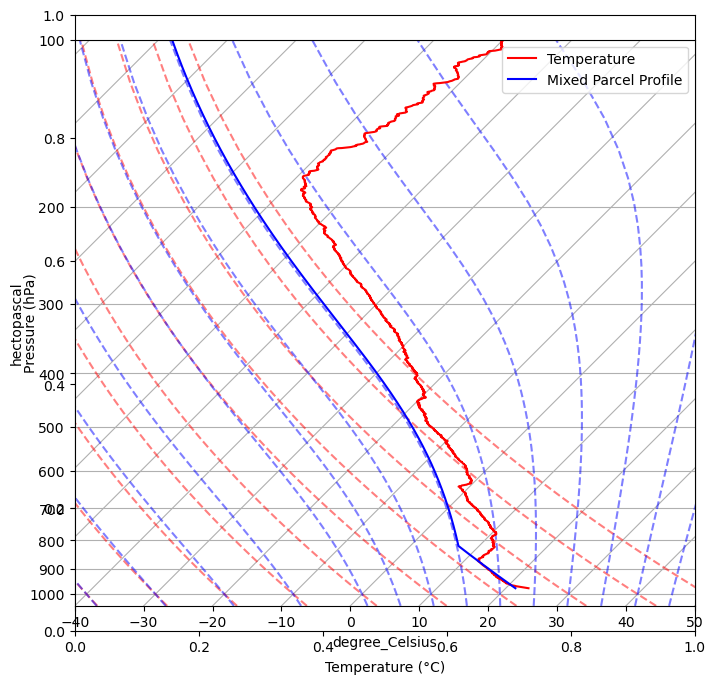

nan hectopascal 2005-05-07 17:29:00


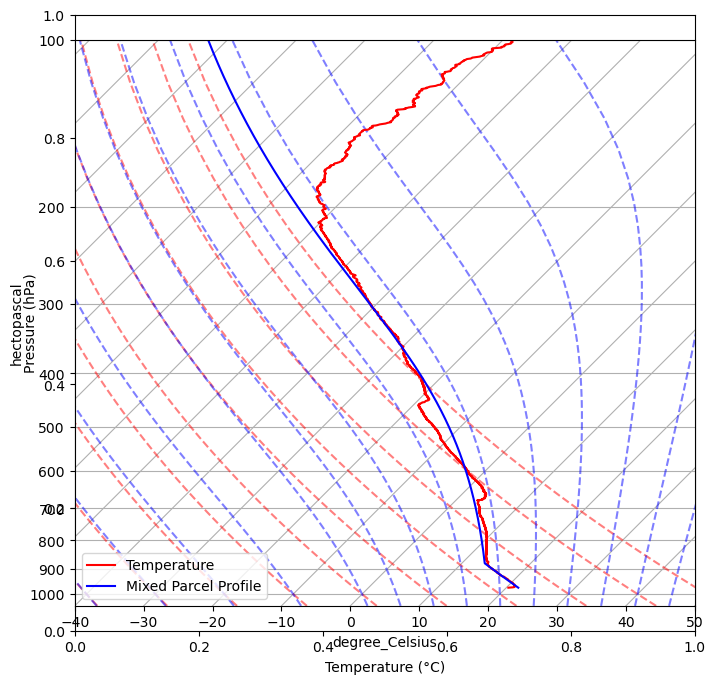

300.9934509622712 hectopascal 2005-05-07 23:29:00


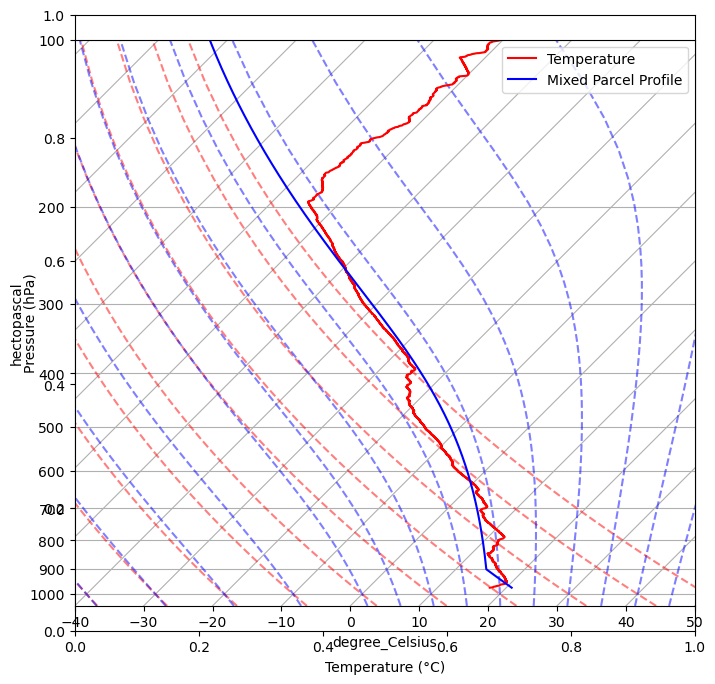

624.8807751346687 hectopascal 2005-05-08 05:23:00


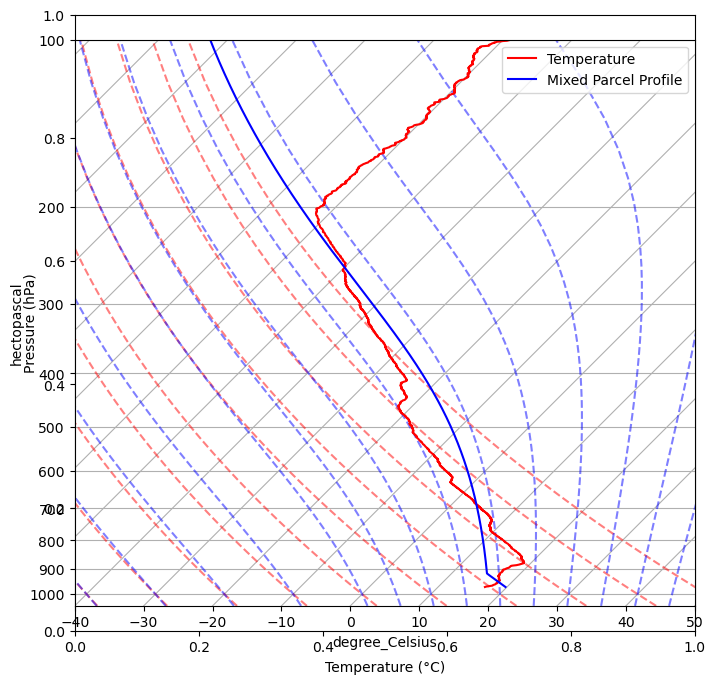

688.3672490644377 hectopascal 2005-05-08 11:33:00


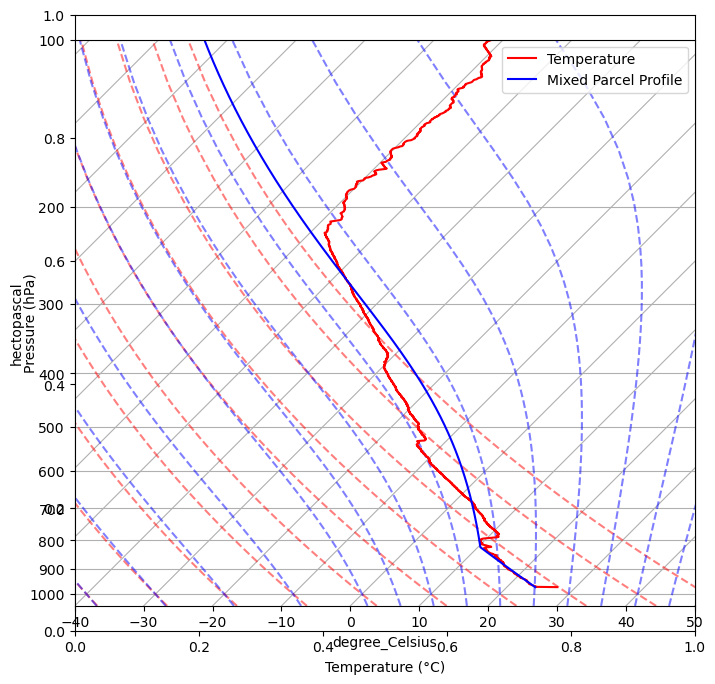

271.80878589456705 hectopascal 2005-05-08 17:29:00


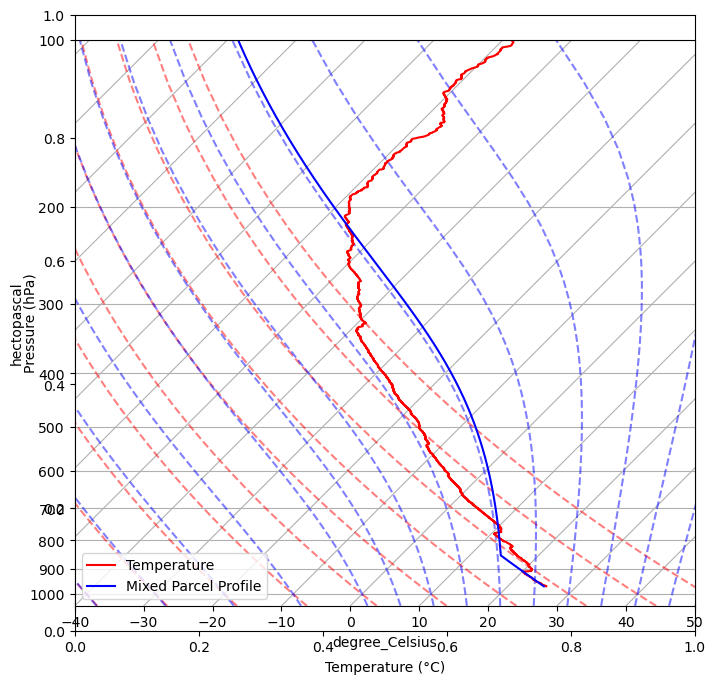

748.9977333091489 hectopascal 2005-05-08 23:31:00


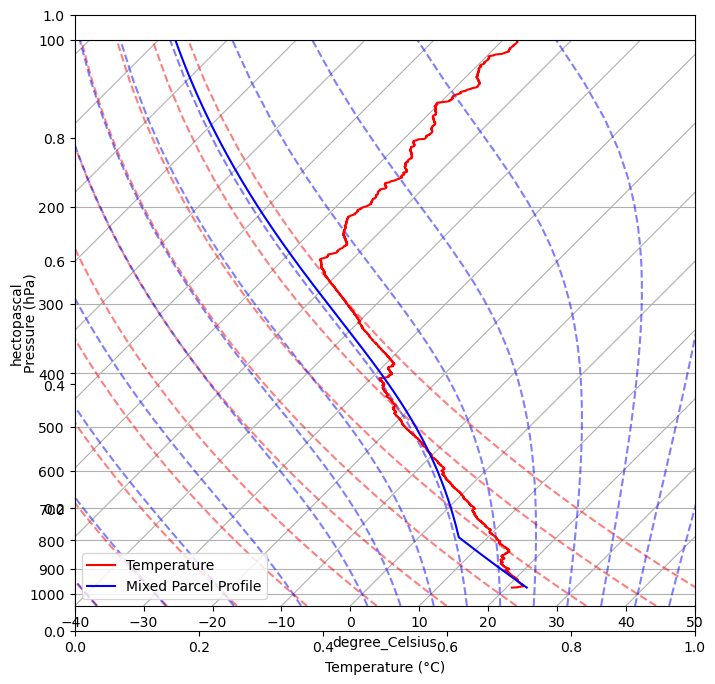

554.9982177348068 hectopascal 2005-05-09 05:29:00


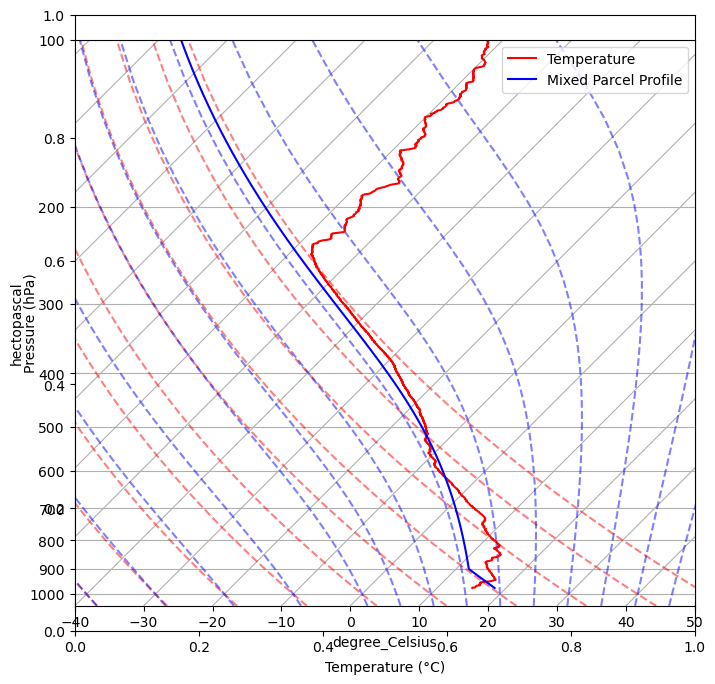

615.462206130655 hectopascal 2005-05-09 11:31:00


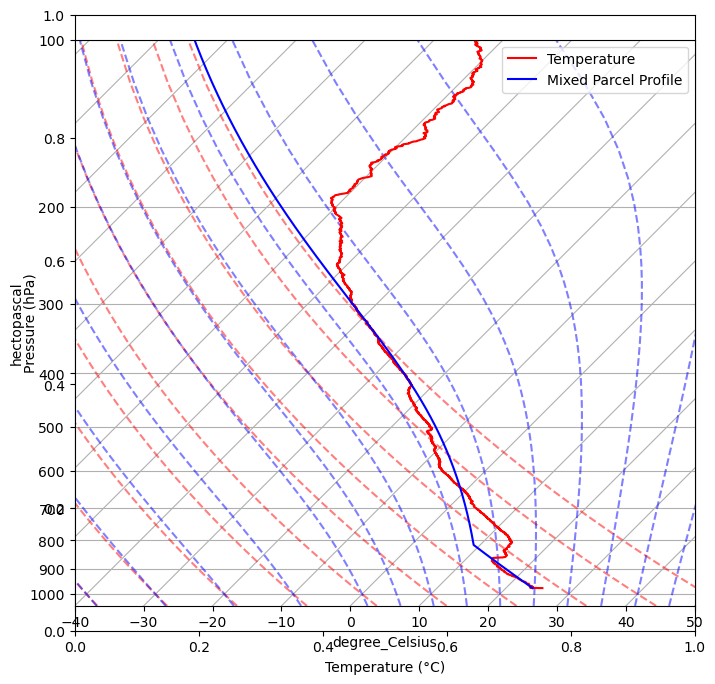

297.8245408960888 hectopascal 2005-05-09 17:29:00


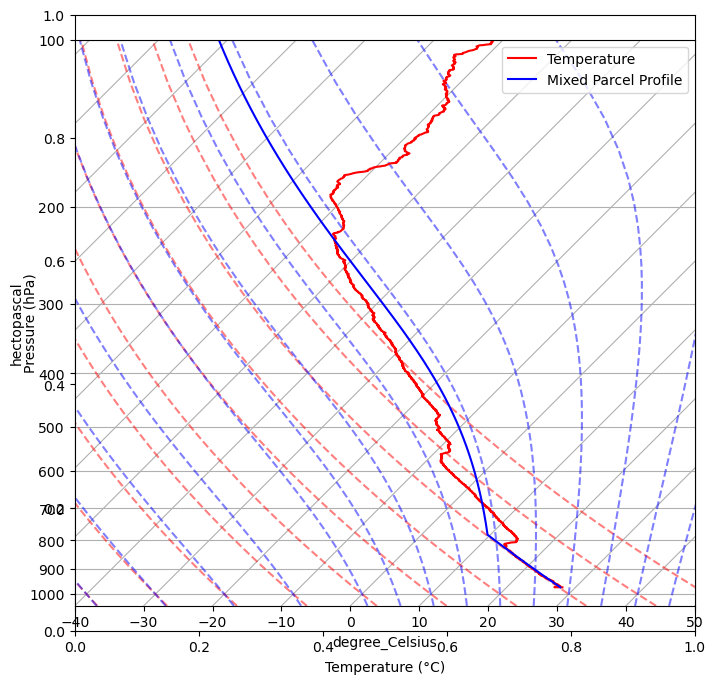

229.63513819409934 hectopascal 2005-05-09 23:29:00


In [1266]:
for i in range(10000,10010):
    f = darmdata_cleaned[i]
    time = time_adjustment(darmdata_cleaned[i])
    pres = f.variables["pres"].data*units.hPa
    temp = f.variables["tdry"].data*units.degC
    dp = f.variables["dp"].data*units.degC

    mp = mpcalc.mixed_parcel(pres,temp,dp,depth=50*units.hPa)

    #mixed parcel profile begins at 25hpa above ground and begins with mixed parcel temp & dp
    mpp = mpcalc.parcel_profile(pres,mp[1],mp[2]).to('degC')
    
    #need to figure out how to calculate lfc when mixed parcel profile starts 25hpa above it
    lfc = mpcalc.lfc(pres,temp,dp,parcel_temperature_profile=mpp)
    
    fig, ax = plt.subplots(figsize=(8, 8))
    skew = SkewT(fig, rotation=45)

    skew.plot(pres, temp, 'r', label='Temperature')
    
    skew.plot(pres, mpp, 'b', label='Mixed Parcel Profile')

    # Add dry adiabats and moist adiabats (optional)
    skew.plot_dry_adiabats()
    skew.plot_moist_adiabats()

    ax.set_xlabel("Temperature (°C)")
    ax.set_ylabel("Pressure (hPa)")

    # Add a legend
    plt.legend()

    # Show the Skew-T diagram
    plt.show()
    print(lfc[0],time)

In [1268]:
darmdata_cleaned[0].variables['alt'].data

array([  315.,   328.,   336., ..., 21035., 21042., 21050.], dtype=float32)

In [1269]:
for file in darmdata_cleaned:
    alt = file.variables["alt"].data[0]
    print(alt)

315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.

315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.

315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
444.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.

315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.

315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.

315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.0
315.

KeyboardInterrupt: 

In [1270]:
for file in darmdata_cleaned:
    pres = file.variables["pres"].data[0]
    print(pres)

973.3
973.7
970.4
978.5
977.0
976.8
979.2
976.6
977.5
980.9
982.3
983.5
981.1
980.6
981.1
979.7
979.4
979.7
981.6
979.7
981.8
984.9
988.1
989.5
989.0
992.4
993.9
990.5
990.0
990.0
991.2
990.2
987.6
985.7
982.8
978.9
979.7
980.6
983.5
984.9
987.3
990.2
991.2
991.0
992.9
993.6
994.8
996.5
998.0
999.5
999.7
997.0
998.0
999.0
999.2
994.1
996.8
998.3
996.1
992.7
990.7
990.5
990.7
989.8
989.5
992.2
992.7
992.2
992.7
993.1
994.1
994.1
995.6
993.9
990.5
986.6
982.3
984.0
984.9
985.9
987.6
990.7
989.5
987.1
985.1
985.7
982.5
981.1
977.7
977.5
974.7
971.3
974.2
975.8
978.7
982.3
985.4
987.3
987.6
985.4
985.7
985.2
982.5
983.0
980.6
980.1
978.2
976.1
975.4
976.3
976.8
976.3
976.6
978.9
980.9
978.0
979.9
979.2
978.2
978.5
978.9
984.2
988.3
990.0
993.4
993.6
995.6
997.5
998.5
997.8
997.5
992.4
990.7
980.4
990.2
988.3
987.1
987.3
986.6
982.8
979.7
976.3
970.6
969.2
968.6
968.7
970.9
973.0
983.3
986.6
987.8
989.5
986.9
988.1
990.2
991.2
993.4
993.9
993.1
995.1
992.2
988.8
984.9
983.7
979.7
975.6
971.

975.7
976.9
976.5
976.1
973.1
974.3
977.5
978.2
977.9
977.9
977.1
974.8
977.6
977.6
978.4
975.8
975.7
978.9
979.6
980.6
977.2
980.1
980.9
978.5
979.8
980.7
980.0
976.8
979.3
978.3
978.2
975.3
976.3
975.6
974.0
972.1
972.0
971.8
973.7
978.1
981.8
984.6
984.3
981.4
983.5
983.8
983.9
981.8
982.4
983.6
984.1
982.8
981.4
982.9
984.0
984.2
982.7
982.9
982.4
979.3
979.9
984.9
981.1
977.4
978.0
978.8
978.9
976.1
977.1
977.6
977.8
975.1
977.2
980.1
980.5
979.3
983.0
985.3
985.5
981.3
984.0
983.1
983.0
978.7
980.1
979.9
980.0
977.1
979.4
979.3
976.2
977.8
978.8
979.5
976.1
978.3
978.6
978.8
976.3
978.2
978.2
976.7
973.4
975.1
975.5
975.5
972.9
974.8
974.6
972.5
975.4
976.3
978.6
977.8
979.9
981.7
980.6
981.9
982.0
982.5
979.5
979.8
977.1
976.3
971.8
972.1
971.4
972.1
970.5
972.3
973.8
974.1
972.8
976.5
978.0
979.5
980.1
981.2
983.1
979.6
979.5
979.4
979.0
974.4
974.9
976.0
973.7
975.2
975.8
976.4
975.9
977.7
978.2
975.5
976.0
975.6
974.9
971.5
973.5
974.6
975.2
973.0
974.3
973.8
973.9
972.1
975.

982.03
987.14
985.8
988.4
989.0
986.92
977.9
977.56
977.25
978.65
979.61
985.48
989.29
991.67
984.85
980.33
976.01
967.95
970.57
973.83
972.05
975.92
974.31
970.06
967.84
963.0
962.11
966.31
973.79
975.6
978.48
981.25
983.13
979.14
980.35
978.66
980.24
980.25
984.74
987.79
987.95
980.33
978.53
974.85
971.09
972.11
971.32
972.36
971.39
975.87
984.95
990.8
992.63
996.41
995.67
996.52
992.2
992.0
989.71
988.68
983.8
982.15
979.22
976.34
972.61
971.54
970.84
975.74
975.6
977.9
977.27
978.12
975.07
976.55
976.24
978.56
976.86
978.54
977.74
979.54
976.87
978.32
977.47
978.33
974.9
974.35
974.5
975.37
972.6
974.08
972.7
971.22
970.74
970.06
969.78
968.34
969.69
969.35
970.7
971.65
973.12
972.16
972.4
970.1
971.81
971.15
970.22
972.76
975.04
975.87
978.9
977.9
978.88
979.65
980.13
978.3
980.14
980.69
982.41
978.1
978.84
978.98
979.89
975.12
975.44
976.34
977.29
975.32
977.53
976.91
976.39
973.43
974.4
973.5
972.88
969.09
970.4
971.93
973.45
970.95
973.2
972.8
973.67
970.31
969.9
966.4
965.3
96

977.97
977.07
976.47
974.97
974.97
977.37
975.97
976.87
978.17
977.97
976.76
975.46
975.97
977.07
976.97
977.67
977.97
975.77
974.26
975.57
977.47
976.97
974.77
976.37
975.07
972.96
973.27
974.87
974.47
974.97
974.47
974.16
972.46
971.56
972.97
973.37
971.97
971.77
972.17
971.87
971.87
972.67
972.97
973.57
974.27
973.87
972.86
972.06
973.17
973.57
973.97
974.87
975.67
974.97
973.76
972.76
973.27
974.37
974.47
979.67
981.97
983.27
984.97
986.77
989.18
990.08
992.18
992.77
991.57
989.77
987.47
987.17
987.07
986.08
985.58
985.27
982.77
979.57
977.97
978.07
978.27
978.87
978.87
981.27
981.57
980.47
979.97
981.47
982.97
983.08
983.38
984.67
984.07
981.67
979.37
978.77
979.07
978.27
976.67
973.17
971.76
969.96
970.07
969.67
972.97
971.57
972.17
971.56
970.96
974.37
975.57
975.77
974.37
973.77
974.17
975.17
975.87
977.17
977.17
976.47
974.77
975.17
977.67
976.87
975.27
977.17
975.97
973.56
970.96
971.67
972.67
970.47
971.87
972.27
972.77
970.66
969.86
968.07
969.87
970.47
970.77
971.57
970.56

In [1273]:
# Your array of increasing height values
heights = [0,25,50,75,100,125,150]

# Create an array of target heights at every 50 meters
target_heights = np.arange(0, max(heights) + 50, 50)

# Use linear interpolation to interpolate values at the target heights
interpolated_values = np.interp(target_heights, heights, range(len(heights)))

# Convert the interpolated values back to height values
interpolated_heights = [heights[int(i)] for i in interpolated_values]

print(interpolated_heights)

[0, 50, 100, 150]


In [1278]:
#utc --> 5:30,11:30,17:30,23:30
#sgp --> 23:30,5:30,11:30,17:30
times = []
for file in darmdata_cleaned:
    time = time_adjustment(file)
    times.append(time)
timedf = pd.DataFrame(times,columns=['utc'])
timedf['sgp'] = timedf['utc'] - datetime.timedelta(hours=6)
timedf = timedf.sort_values(by='utc')
timedf

,utc,sgp
4149,1994-04-30 20:31:00,1994-04-30 14:31:00
4150,1997-03-05 20:29:00,1997-03-05 14:29:00
4151,1999-05-26 20:30:00,1999-05-26 14:30:00
0,2000-06-15 14:57:00,2000-06-15 08:57:00
1,2000-06-16 16:51:00,2000-06-16 10:51:00
2,2000-10-03 11:30:00,2000-10-03 05:30:00
3,2000-11-24 11:28:00,2000-11-24 05:28:00
4,2000-11-24 20:31:00,2000-11-24 14:31:00
5,2000-11-24 23:28:00,2000-11-24 17:28:00
6,2000-11-25 05:30:00,2000-11-24 23:30:00
